# Semantic Segmentation using UNet

# **Import Libraries**

In [1]:
from tensorflow.python import keras
print(keras.__version__)

2.6.0


In [2]:
import tensorflow as tf

In [3]:
print(tf.keras.__version__)

2.12.0


In [4]:
print(tf.__version__)

2.12.0


In [13]:
import os, glob
import cv2, random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from matplotlib import pyplot as plt
#from patchify import patchify
from PIL import Image
#import segmentation_models as sm
import tensorflow as tf
from tensorflow.keras.metrics import MeanIoU
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from keras.utils import normalize
from tensorflow.keras.models import load_model
from tqdm import tqdm
from random import sample
import pickle
from tensorflow.keras.callbacks import Callback, ModelCheckpoint,  EarlyStopping
from tensorflow.keras.optimizers import SGD, Adam
from sklearn.preprocessing import LabelEncoder
from keras.utils import normalize
from sklearn.model_selection import train_test_split
from keras.utils import to_categorical
from sklearn.utils.class_weight import compute_class_weight

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


***Getting Colour Labels***

In [ ]:
dfs = pd.read_excel("/kaggle/input/new-selected/Selected_category.xlsx","Sheet2")

In [ ]:
dfs

In [3]:
CLASS_COLORS = dict(zip(dfs['Idx'], dfs['Color_Code (R,G,B)']))
CLASS_LABELS = dict(zip(dfs['Idx'], dfs['Name']))
class_name_color =dict( zip(dfs['Name'],  dfs['Color_Code (R,G,B)']))

In [142]:
Label = list(dfs["Name"])
Name =[]

for i in Label:
    Name.append(i)

print(*Name,sep="\n")

building
sky
tree
ceiling
road;route
grass
sidewalk
person
mountain
car
water
house
sea


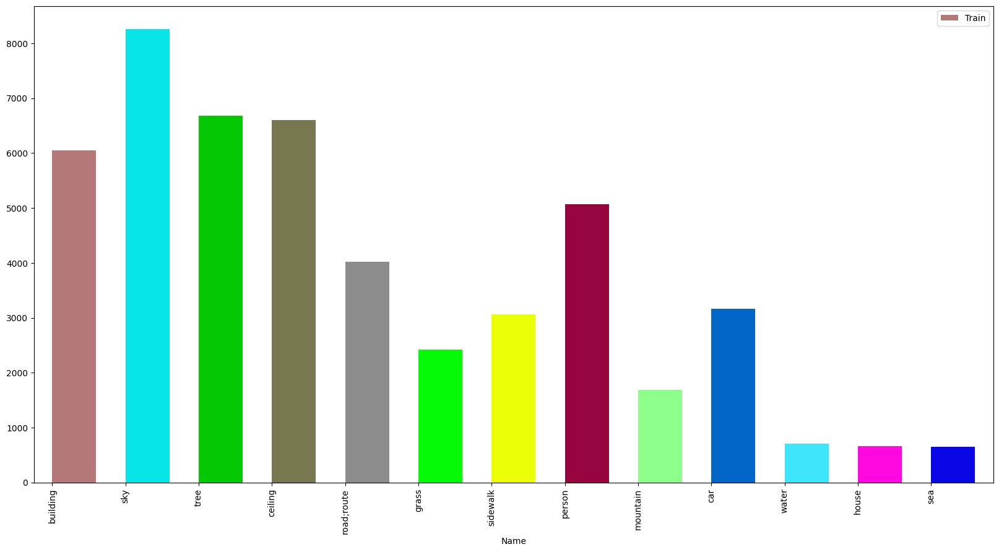

In [144]:
dfs.plot.bar(x="Name",y="Train",color=colors,figsize = (20, 10),width=0.6, align='edge')
plt.show()

In [141]:
colors = dfs["Color_Code(hex)"]
colors

0     #B47878
1     #06E6E6
2     #04C803
3     #787850
4     #8C8C8C
5     #04FA07
6     #EBFF07
7     #96053D
8     #8FFF8C
9     #0066C8
10    #3DE6FA
11    #FF09E0
12    #0907E6
Name: Color_Code(hex), dtype: object

In [112]:
class_name_color

{'sky': '(6, 230, 230)',
 'tree': '(4, 200, 3)',
 'ceiling': '(120, 120, 80)',
 'building': '(180, 120, 120)',
 'person': '(150, 5, 61)',
 'table': '(255, 6, 82)',
 'road;route': '(140, 140, 140)',
 'car': '(0, 102, 200)',
 'sidewalk': '(235, 255, 7)',
 'light': '(255, 173, 0)',
 'grass': '(4, 250, 7)',
 'streetlight': '(0, 71, 255)',
 'earth': '(120, 120, 70)',
 'mountain': '(143, 255, 140)',
 'water': '(61, 230, 250)',
 'house': '(255, 9, 224)',
 'sea': '(9, 7, 230)'}

# **Selecting the Classes and class masks**

**Categories Selected are as follows :**

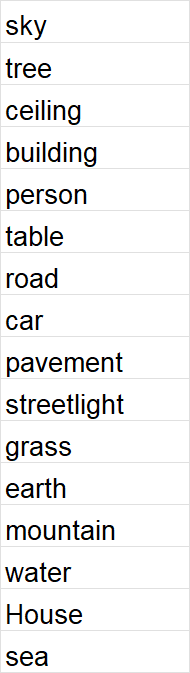

In [113]:
CLASS_LABELS

{3: 'sky',
 5: 'tree',
 6: 'ceiling',
 2: 'building',
 13: 'person',
 16: 'table',
 7: 'road;route',
 21: 'car',
 12: 'sidewalk',
 83: 'light',
 10: 'grass',
 88: 'streetlight',
 14: 'earth',
 17: 'mountain',
 22: 'water',
 26: 'house',
 27: 'sea'}

In [3]:
class_label = {
2: 'building',
3: 'sky',
5: 'tree',
6: 'ceiling',
7: 'road',
10: 'grass',
12: 'sidewalk',
13: 'person',
17: 'mountain',
21: 'car',
22: 'water',
26: 'house',
27: 'sea'}

class_colors = {
    2: (80, 120, 120), 
    3: (6, 230, 230),          
    5: (4, 200, 3),    
    6: (20, 120, 80),    
    7: (140, 140, 140), 
    10: (4, 250, 7), 
    12: (235, 255, 7),
    13: (150, 5, 61),              
    17: (143, 255, 140),    
    21: (0, 102, 200), 
    22: (61, 230, 250),
    26:(255, 9, 224),
    27:(9, 7, 230)              
 
}       

In [4]:
class_colors_keys = list(class_colors.keys())

In [5]:
class_colors_keys

[2, 3, 5, 6, 7, 10, 12, 13, 17, 21, 22, 26, 27]

sky
tree
ceiling
building
person
table
road
car
pavement
streetlight
grass
earth
mountain
water
House
sea

In [6]:
class_colors_keys

[2, 3, 5, 6, 7, 10, 12, 13, 17, 21, 22, 26, 27]

In [7]:
#Training and testing Paths
train_path = r"/kaggle/input/ade20k-scene-parsing/ADEChallengeData2016/images/training"
anno_path = r"/kaggle/input/ade20k-scene-parsing/ADEChallengeData2016/annotations/training"

In [94]:
image_dataset,mask_dataset,masked_image_dataset = [],[],[]

In [9]:
def load_images_bw_mask(image_path):
    image = cv2.imread(image_path,0)
    #print(image.shape)
    #image = cv2.cvtColor(image)
    image = cv2.resize(image, (128, 128))
    image = Image.fromarray(image)
    image = np.array(image)
    return image

In [10]:
def load_images_bw(image_path):
    image = cv2.imread(image_path,1)
    image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (128, 128))
    image = Image.fromarray(image)
    image = np.array(image)
    return image


In [11]:
import os
import random

imgExtension = ["png", "jpeg", "jpg"] #Image Extensions to be chosen from
allImages = list()



def chooseRandomImage(directory=train_path):
    for img in os.listdir(directory): #Lists all files
        ext = img.split(".")[len(img.split(".")) - 1]
        if (ext in imgExtension):
            allImages.append(img)
    choice = random.randint(0, len(allImages) - 1)
    chosenImage = allImages[choice] #Do Whatever you want with the image file
    return chosenImage


In [146]:
# File path of the text file to read
file_path = '/kaggle/input/train-data-test-data/train_data.txt'
test_file_path = '/kaggle/input/train-data-test-data/test_data.txt'

# Initialize an empty list to store the file contents
training_images = []
testing_images = []

# Open the file in read mode
with open(file_path, 'r') as file:
    # Read each line from the file
    for line in file:
        # Strip any leading or trailing whitespace characters and append the line to the list
        training_images.append(line.strip())
        
# Open the file in read mode
with open(test_file_path, 'r') as file:
    # Read each line from the file
    for line in file:
        # Strip any leading or trailing whitespace characters and append the line to the list
        testing_images.append(line.strip())

# Print the list to verify the contents
print("Contents of the file saved to list:")


Contents of the file saved to list:


In [147]:
print(training_images[0])
print(testing_images[0])

ADE_train_00000567.jpg
ADE_train_00000567.png


In [95]:
for i in range(4000):
    train_image_name = chooseRandomImage()
    image = load_images_bw(os.path.join(train_path,train_image_name)) 
    image_name = train_image_name.replace('.jpg', '.png')
    
    mask = load_images_bw_mask(os.path.join(anno_path,image_name))
    #print("before: ",np.unique(mask))
    
    print(image_name)
    
    # Apply class label changes and relabelling other classes to background
    for label in np.unique(mask):
        if label not in class_colors_keys:
            mask[mask == label] = 0
    
    # Calculate background pixels
    background_pixels = np.sum(mask == 0)  # Assuming background is labeled as 0
    
    # Calculate background percentage
    total_pixels = mask.shape[0] * mask.shape[1]
    background_percentage = (background_pixels / total_pixels) * 100
    print(background_percentage)
    
    if (background_percentage>90):
        continue
    else:
        #creating a numpy array of image size 
        output = np.zeros_like(image)

        # Apply colors to the mask based on class labels
        labels = list(class_colors.values())
        for class_label, color in class_colors.items():
            output[mask == class_label] = color
        #Adding Images, masks and Coloured Masks
        image_dataset.append(image[:,:,0])
        mask_dataset.append(mask)
        masked_image_dataset.append(output)
    
    
    
    

ADE_train_00003492.png
98.980712890625
ADE_train_00003757.png
95.135498046875
ADE_train_00003801.png
97.308349609375
ADE_train_00020088.png
81.634521484375
ADE_train_00000427.png
78.62548828125
ADE_train_00007600.png
7.666015625
ADE_train_00012701.png
4.217529296875
ADE_train_00017448.png
4.803466796875
ADE_train_00017346.png
7.769775390625
ADE_train_00008903.png
89.581298828125
ADE_train_00013500.png
7.2021484375
ADE_train_00013980.png
41.607666015625
ADE_train_00001819.png
91.29638671875
ADE_train_00013171.png
97.3876953125
ADE_train_00011332.png
98.62060546875
ADE_train_00016180.png
92.120361328125
ADE_train_00007455.png
30.09033203125
ADE_train_00000837.png
84.356689453125
ADE_train_00014534.png
33.49609375
ADE_train_00013846.png
51.3427734375
ADE_train_00015701.png
74.951171875
ADE_train_00001757.png
98.126220703125
ADE_train_00019332.png
60.455322265625
ADE_train_00003138.png
74.786376953125
ADE_train_00015664.png
4.26025390625
ADE_train_00000456.png
99.072265625
ADE_train_000112

In [ ]:
#Read first required images 
for i in range(2008,3008):
    # Load the segmentation mask
    image_name = 'ADE_train_0000'+str(i)+'.png'
    mask = load_images_bw_mask(os.path.join(anno_path,image_name))
    #print("before: ",np.unique(mask))
    
    
    
    # Apply class label changes and relabelling other classes to background
    for label in np.unique(mask):
        if label not in class_colors_keys:
            mask[mask == label] = 0
    
   
    #print("After : ",np.unique(mask))
    # Load the Image
    train_image_name = 'ADE_train_0000'+str(i)+'.jpg'
    image = load_images_bw(os.path.join(train_path,train_image_name)) 
    
    #creating a numpy array of image size 
    output = np.zeros_like(image)
    
    # Apply colors to the mask based on class labels
    labels = list(class_colors.values())
    for class_label, color in class_colors.items():
        output[mask == class_label] = color
    
    #Adding Images, masks and Coloured Masks
    image_dataset.append(image[:,:,0])
    mask_dataset.append(mask)
    masked_image_dataset.append(output)
    


In [148]:
#Read first required images 
for i in range(len(training_images)):
    # Load the segmentation mask
    image_name = testing_images[i]
    print(image_name)
    print(os.path.join(anno_path,image_name))
    mask = load_images_bw_mask(os.path.join(anno_path,image_name))
    print("before: ",np.unique(mask))
    
    
    
    # Apply class label changes and relabelling other classes to background
    for label in np.unique(mask):
        if label not in class_colors_keys:
            mask[mask == label] = 0
    
   
    print("After : ",np.unique(mask))
    # Load the Image
    train_image_name = training_images[i]
    print(train_image_name)
    print(os.path.join(train_path,train_image_name))
    image = load_images_bw(os.path.join(train_path,train_image_name)) 
    
    #creating a numpy array of image size 
    output = np.zeros_like(image)
    
    # Apply colors to the mask based on class labels
    labels = list(class_colors.values())
    for class_label, color in class_colors.items():
        output[mask == class_label] = color
    
    #Adding Images, masks and Coloured Masks
    image_dataset.append(image[:,:,0])
    mask_dataset.append(mask)
    masked_image_dataset.append(output)
    


ADE_train_00000567.png
/kaggle/input/ade20k-scene-parsing/ADEChallengeData2016/annotations/training/ADE_train_00000567.png
before:  [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 20 22 25 27]
After :  [ 0  2  3  5  6  7 10 12 13 17 22 27]
ADE_train_00000567.jpg
/kaggle/input/ade20k-scene-parsing/ADEChallengeData2016/images/training/ADE_train_00000567.jpg
ADE_train_00000568.png
/kaggle/input/ade20k-scene-parsing/ADEChallengeData2016/annotations/training/ADE_train_00000568.png
before:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 21 22 23 26
 27]
After :  [ 0  2  3  5  6  7 10 12 13 17 21 22 26 27]
ADE_train_00000568.jpg
/kaggle/input/ade20k-scene-parsing/ADEChallengeData2016/images/training/ADE_train_00000568.jpg
ADE_train_00000569.png
/kaggle/input/ade20k-scene-parsing/ADEChallengeData2016/annotations/training/ADE_train_00000569.png
before:  [ 0  2  3  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 25 26 27 28 30 31
 32 35]
After :  [ 0  2  3 10 13 17 21 22 26 27]
ADE_tr

In [118]:
#Masked_iamges
masked_image_dataset[0].shape

(128, 128, 3)

In [96]:
len(image_dataset),len(mask_dataset),len(masked_image_dataset)

(2856, 2856, 2856)

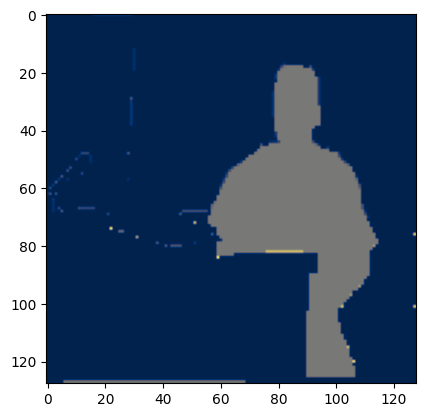

In [97]:
#Mask Image
plt.imshow(mask_dataset[0],cmap='cividis')

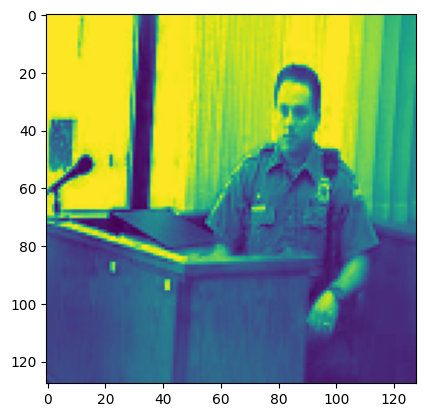

In [98]:
#Image Considering last channel
plt.imshow(image_dataset[0])

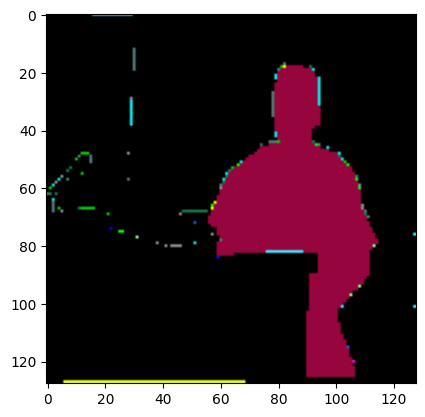

In [99]:
#Masked Image with colours
plt.imshow(masked_image_dataset[0])

In [100]:
np.unique(mask_dataset[0])

array([ 0,  2,  3,  5,  6,  7, 10, 12, 13, 17, 21, 22, 26, 27],
      dtype=uint8)

In [101]:
masked_image_dataset[0].shape

(128, 128, 3)

In [102]:
n_classes = len(np.unique(mask_dataset))

In [23]:
n_classes

14

2479
[ 0  2  3  5  6  7 10 12 13 17 21]


Text(0.5, 1.0, 'Mask')

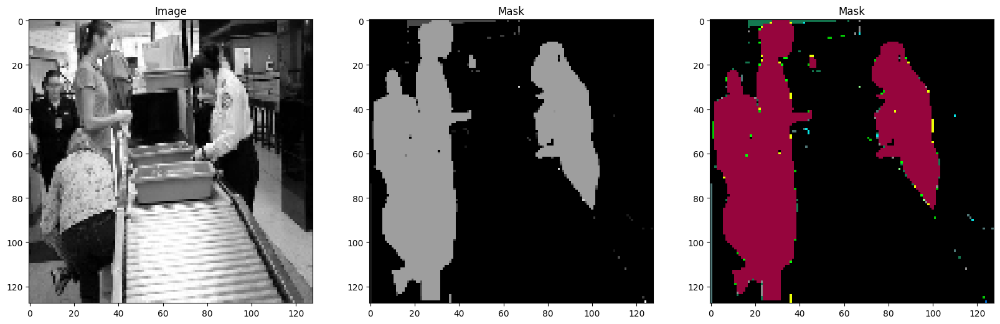

In [103]:
# Sanity check...
import random
image_number = random.randint(0, len(image_dataset))
print(image_number)
print(np.unique(mask_dataset[image_number]))
#image_number=45
plt.figure(figsize=(20, 20))
plt.subplot(131)
plt.imshow(image_dataset[image_number],cmap='gray')
plt.title("Image")
plt.subplot(132)
plt.imshow(mask_dataset[image_number],cmap='gray')
plt.title("Mask")
plt.subplot(133)
plt.imshow(masked_image_dataset[image_number])
plt.title("Mask")

In [104]:
#Convert list to array for machine learning processing
train_images = np.array(image_dataset)
train_images = np.expand_dims(train_images, axis=3)

In [27]:
train_images.shape

(2817, 128, 128, 1)

In [105]:
#Convert list to array for machine learning processing
train_masks = np.array(mask_dataset)
train_masks.shape

(2856, 128, 128)

In [106]:
#Encode labels... but multi dim array so need to flatten, encode and reshape
labelencoder = LabelEncoder()
n, h, w = train_masks.shape
train_masks_reshaped = train_masks.reshape(-1,1)
print(np.unique(train_masks_reshaped))
train_masks_reshaped_encoded = labelencoder.fit_transform(train_masks_reshaped)
print(np.unique(train_masks_reshaped_encoded))
train_masks_encoded_original_shape = train_masks_reshaped_encoded.reshape(n, h, w)

np.unique(train_masks_encoded_original_shape)

[ 0  2  3  5  6  7 10 12 13 17 21 22 26 27]


/opt/conda/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]


array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13])

In [107]:
#Normalising Images
train_images = normalize(train_images,axis=1)#
train_masks_input = np.expand_dims(train_masks_encoded_original_shape, axis=3)

In [108]:
train_masks_input.shape, train_images.shape


((2856, 128, 128, 1), (2856, 128, 128, 1))

In [109]:
#Train - Test Split
X1, X_test, y1, y_test = train_test_split(train_images, train_masks_input, test_size = 0.1, random_state = 42)

In [110]:
X1.shape, X_test.shape, y1.shape, y_test.shape

((2570, 128, 128, 1),
 (286, 128, 128, 1),
 (2570, 128, 128, 1),
 (286, 128, 128, 1))

In [34]:
np.unique(train_masks_input)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13])

In [111]:
#Number of Unique classes in training masks
n_classes=len(np.unique(train_masks_input))
print(n_classes)

14


In [112]:
#CONVERTING DATA TO CATEGORICAL classes
train_masks_cat = to_categorical(y1, num_classes=n_classes)
y_train_cat = train_masks_cat.reshape((y1.shape[0], y1.shape[1], y1.shape[2], n_classes))

test_masks_cat = to_categorical(y_test, num_classes=n_classes)
y_test_cat = test_masks_cat.reshape((y_test.shape[0], y_test.shape[1], y_test.shape[2], n_classes))

In [113]:
###############################################################
#computing class weights
class_weights = compute_class_weight(class_weight = "balanced", classes= np.unique(train_masks_reshaped_encoded), y= train_masks_reshaped_encoded)
print("Class weights are...:", class_weights)

Class weights are...: [0.17113204 0.47929014 0.54946613 1.01623286 1.36981377 1.43854951
 2.60720161 3.81131878 3.31431348 3.0724829  6.44710893 7.14084336
 8.73196959 6.32095179]


In [114]:
#Selecting image height, width and channel for neural network
IMG_HEIGHT = X1.shape[1]
IMG_WIDTH  = X1.shape[2]
IMG_CHANNELS = X1.shape[3]
print(IMG_HEIGHT,IMG_WIDTH,IMG_CHANNELS)

128 128 1


In [115]:
"""
Standard Unet

# https://youtu.be/XyX5HNuv-xE
# https://youtu.be/q-p8v1Bxvac
"""


from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Conv2DTranspose, BatchNormalization, Dropout, Lambda


################################################################
def multi_unet_model(n_classes=n_classes, IMG_HEIGHT=256, IMG_WIDTH=256, IMG_CHANNELS=1):
#Build the model
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
    #s = Lambda(lambda x: x / 255)(inputs)   #No need for this if we normalize our inputs beforehand
    s = inputs

    #Contraction path
    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(s)
    c1 = Dropout(0.1)(c1)
    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
    c2 = Dropout(0.1)(c2)
    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
    c3 = Dropout(0.2)(c3)
    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
    c4 = Dropout(0.2)(c4)
    c4 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)
    p4 = MaxPooling2D(pool_size=(2, 2))(c4)

    c5 = Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
    c5 = Dropout(0.3)(c5)
    c5 = Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)

    #Expansive path
    u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u6)
    c6 = Dropout(0.2)(c6)
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c6)

    u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u7)
    c7 = Dropout(0.2)(c7)
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c7)

    u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u8)
    c8 = Dropout(0.1)(c8)
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)

    u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = concatenate([u9, c1], axis=3)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u9)
    c9 = Dropout(0.1)(c9)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)

    outputs = Conv2D(n_classes, (1, 1), activation='softmax')(c9)
    model = Model(inputs=[inputs], outputs=[outputs])

    return model


In [116]:
from tensorflow.keras import backend as K
# Define custom mean IoU metric function
def mean_iou(y_true, y_pred):
    y_pred = tf.round(y_pred)  # Convert predictions to binary values (0 or 1)
    intersection = K.sum(K.abs(y_true * y_pred), axis=[1, 2, 3])  # Calculate intersection
    union = K.sum(K.clip(y_true + y_pred, 0, 1), axis=[1, 2, 3])  # Calculate union
    iou = K.mean((intersection + K.epsilon()) / (union + K.epsilon()))  # Calculate IoU
    return iou

# Define custom recall metric function
def recall(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

# Define custom F1 Score metric function
def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    f1_score = 2 * (precision * recall) / (precision + recall + K.epsilon())
    return f1_score

In [117]:
#Model Compilation

def get_model():
    return multi_unet_model(n_classes=n_classes, IMG_HEIGHT=IMG_HEIGHT, IMG_WIDTH=IMG_WIDTH, IMG_CHANNELS=IMG_CHANNELS)

model = get_model()
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy',mean_iou,recall,f1_score])
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 128, 128, 1  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_19 (Conv2D)             (None, 128, 128, 16  160         ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 dropout_9 (Dropout)            (None, 128, 128, 16  0           ['conv2d_19[0][0]']              
                                )                                                           

In [ ]:
type(X1)

In [118]:
from tensorflow.keras.callbacks import ModelCheckpoint, Callback
from sklearn.metrics import precision_score, recall_score, f1_score
import numpy as np

# Custom callback to compute and store precision, recall, F1 score, and IoU
from tensorflow.keras.callbacks import Callback
from sklearn.metrics import precision_score, recall_score, f1_score
import numpy as np

# Custom callback to compute and store metrics for training and validation sets
class MetricsCallback(Callback):
    def __init__(self, X_train, y_train, X_val, y_val):
        super(MetricsCallback, self).__init__()
        self.val_num = int(0.1*len(X_val))
        print(self.val_num)
        self.X_train = X_train[:self.val_num]
        self.y_train = y_train[:self.val_num]
        self.X_val = X_val[:self.val_num]
        self.y_val = y_val[:self.val_num]
        self.metrics_history = {'train': [], 'val': []}

    def on_epoch_end(self, epoch, logs=None):
        # Compute metrics for training set
        y_train_pred = np.argmax(self.model.predict(self.X_train), axis=-1)
        train_precision = precision_score(np.argmax(self.y_train, axis=-1).ravel(), y_train_pred.ravel(), average='weighted')
        train_recall = recall_score(np.argmax(self.y_train, axis=-1).ravel(), y_train_pred.ravel(), average='weighted')
        train_f1 = f1_score(np.argmax(self.y_train, axis=-1).ravel(), y_train_pred.ravel(), average='weighted')
        
        confusion_matrix_train = tf.math.confusion_matrix(np.argmax(self.y_train, axis=-1).ravel(), y_train_pred.ravel())
        intersection_train = np.diag(confusion_matrix_train)
        union_train = np.sum(confusion_matrix_train, axis=0) + np.sum(confusion_matrix_train, axis=1) - intersection_train
        train_iou = np.mean((intersection_train + 1e-10) / (union_train + 1e-10))

        # Compute metrics for validation set
        y_val_pred = np.argmax(self.model.predict(self.X_val), axis=-1)
        val_precision = precision_score(np.argmax(self.y_val, axis=-1).ravel(), y_val_pred.ravel(), average='weighted')
        val_recall = recall_score(np.argmax(self.y_val, axis=-1).ravel(), y_val_pred.ravel(), average='weighted')
        val_f1 = f1_score(np.argmax(self.y_val, axis=-1).ravel(), y_val_pred.ravel(), average='weighted')
        
        confusion_matrix_val = tf.math.confusion_matrix(np.argmax(self.y_val, axis=-1).ravel(), y_val_pred.ravel())
        intersection_val = np.diag(confusion_matrix_val)
        union_val = np.sum(confusion_matrix_val, axis=0) + np.sum(confusion_matrix_val, axis=1) - intersection_val
        val_iou = np.mean((intersection_val + 1e-10) / (union_val + 1e-10))

        self.metrics_history['train'].append({'train_precision': train_precision,
                                              'train_recall': train_recall,
                                              'train_f1': train_f1,
                                              'train_iou': train_iou})
        
        self.metrics_history['val'].append({'val_precision': val_precision,
                                            'val_recall': val_recall,
                                            'val_f1': val_f1,
                                            'val_iou': val_iou})


In [ ]:
history.history.keys()

In [119]:
import datetime
#CHECKPOINT path for model training 
#Model will be saved if validation accuracy improves 
from tensorflow.keras.callbacks import ModelCheckpoint

# Custom callback to compute metrics and save history

metrics_callback = MetricsCallback(X1, y_train_cat, X_test, y_test_cat)

log_dir = "/kaggle/working/LOGS" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

filepath="/kaggle/working/weights-6-improvement-fixed-images-{epoch:03d}-{val_accuracy:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, savemode='max')
callbacks_list = [checkpoint,metrics_callback, tensorboard_callback]


28


In [48]:
#creating folder to save weights
os.mkdir('LOGS')

In [120]:
#Load weights 
model.load_weights("/kaggle/working/weights-6-improvement-fixed-images-047-0.68.hdf5")

In [121]:
#Training model
history = model.fit(X1, y_train_cat,
                    batch_size = 16,
                    verbose=1,
                    epochs=50,
                    validation_data=(X_test, y_test_cat),
                    #class_weight=class_weights,
                    callbacks=callbacks_list,
                    shuffle=True)

Epoch 1/50


2024-04-05 06:16:22.193323: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_1/dropout_9/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


161/161 [==============================] - ETA: 0s - loss: 1.1317 - accuracy: 0.6481 - mean_iou: 0.4694 - recall: 0.5296 - f1_score: 0.6148
Epoch 1: val_accuracy improved from -inf to 0.65602, saving model to /kaggle/working/weights-6-improvement-fixed-images-001-0.66.hdf5
1/1 [==============================] - 0s 248ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 21s 79ms/step - loss: 1.1317 - accuracy: 0.6481 - mean_iou: 0.4694 - recall: 0.5296 - f1_score: 0.6148 - val_loss: 1.0724 - val_accuracy: 0.6560 - val_mean_iou: 0.4534 - val_recall: 0.4998 - val_f1_score: 0.6065
Epoch 2/50
160/161 [============================>.] - ETA: 0s - loss: 1.0463 - accuracy: 0.6706 - mean_iou: 0.4993 - recall: 0.5626 - f1_score: 0.6438
Epoch 2: val_accuracy improved from 0.65602 to 0.67856, saving model to /kaggle/working/weights-6-improvement-fixed-images-002-0.68.hdf5
1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 22ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 60ms/step - loss: 1.0455 - accuracy: 0.6709 - mean_iou: 0.5000 - recall: 0.5632 - f1_score: 0.6444 - val_loss: 1.0050 - val_accuracy: 0.6786 - val_mean_iou: 0.5142 - val_recall: 0.5728 - val_f1_score: 0.6550
Epoch 3/50
160/161 [============================>.] - ETA: 0s - loss: 1.0021 - accuracy: 0.6819 - mean_iou: 0.5148 - recall: 0.5802 - f1_score: 0.6586
Epoch 3: val_accuracy improved from 0.67856 to 0.69450, saving model to /kaggle/working/weights-6-improvement-fixed-images-003-0.69.hdf5
1/1 [==============================] - 0s 20ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 23ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 1.0013 - accuracy: 0.6821 - mean_iou: 0.5152 - recall: 0.5806 - f1_score: 0.6589 - val_loss: 0.9635 - val_accuracy: 0.6945 - val_mean_iou: 0.5361 - val_recall: 0.5992 - val_f1_score: 0.6760
Epoch 4/50
160/161 [============================>.] - ETA: 0s - loss: 0.9545 - accuracy: 0.6941 - mean_iou: 0.5322 - recall: 0.5992 - f1_score: 0.6746
Epoch 4: val_accuracy did not improve from 0.69450
1/1 [==============================] - 0s 20ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 23ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.9546 - accuracy: 0.6942 - mean_iou: 0.5323 - recall: 0.5992 - f1_score: 0.6748 - val_loss: 0.9779 - val_accuracy: 0.6907 - val_mean_iou: 0.5159 - val_recall: 0.5720 - val_f1_score: 0.6603
Epoch 5/50
160/161 [============================>.] - ETA: 0s - loss: 0.9294 - accuracy: 0.7019 - mean_iou: 0.5403 - recall: 0.6083 - f1_score: 0.6832
Epoch 5: val_accuracy did not improve from 0.69450
1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.9288 - accuracy: 0.7020 - mean_iou: 0.5406 - recall: 0.6088 - f1_score: 0.6835 - val_loss: 0.9634 - val_accuracy: 0.6899 - val_mean_iou: 0.5427 - val_recall: 0.6135 - val_f1_score: 0.6789
Epoch 6/50
160/161 [============================>.] - ETA: 0s - loss: 0.8829 - accuracy: 0.7180 - mean_iou: 0.5638 - recall: 0.6344 - f1_score: 0.7033
Epoch 6: val_accuracy improved from 0.69450 to 0.70468, saving model to /kaggle/working/weights-6-improvement-fixed-images-006-0.70.hdf5
1/1 [==============================] - 0s 20ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 62ms/step - loss: 0.8836 - accuracy: 0.7178 - mean_iou: 0.5635 - recall: 0.6342 - f1_score: 0.7030 - val_loss: 0.9470 - val_accuracy: 0.7047 - val_mean_iou: 0.5499 - val_recall: 0.6167 - val_f1_score: 0.6883
Epoch 7/50
160/161 [============================>.] - ETA: 0s - loss: 0.8539 - accuracy: 0.7279 - mean_iou: 0.5774 - recall: 0.6491 - f1_score: 0.7155
Epoch 7: val_accuracy did not improve from 0.70468
1/1 [==============================] - 0s 22ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 62ms/step - loss: 0.8552 - accuracy: 0.7272 - mean_iou: 0.5760 - recall: 0.6478 - f1_score: 0.7142 - val_loss: 0.9885 - val_accuracy: 0.6895 - val_mean_iou: 0.5330 - val_recall: 0.6009 - val_f1_score: 0.6713
Epoch 8/50
160/161 [============================>.] - ETA: 0s - loss: 0.8587 - accuracy: 0.7259 - mean_iou: 0.5732 - recall: 0.6431 - f1_score: 0.7123
Epoch 8: val_accuracy did not improve from 0.70468
1/1 [==============================] - 0s 24ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 62ms/step - loss: 0.8588 - accuracy: 0.7259 - mean_iou: 0.5731 - recall: 0.6429 - f1_score: 0.7123 - val_loss: 0.9860 - val_accuracy: 0.6874 - val_mean_iou: 0.5289 - val_recall: 0.5945 - val_f1_score: 0.6688
Epoch 9/50
160/161 [============================>.] - ETA: 0s - loss: 0.8245 - accuracy: 0.7352 - mean_iou: 0.5881 - recall: 0.6601 - f1_score: 0.7247
Epoch 9: val_accuracy did not improve from 0.70468
1/1 [==============================] - 0s 22ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 24ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.8245 - accuracy: 0.7353 - mean_iou: 0.5884 - recall: 0.6604 - f1_score: 0.7249 - val_loss: 0.9725 - val_accuracy: 0.6998 - val_mean_iou: 0.5438 - val_recall: 0.6109 - val_f1_score: 0.6828
Epoch 10/50
160/161 [============================>.] - ETA: 0s - loss: 0.8104 - accuracy: 0.7412 - mean_iou: 0.5960 - recall: 0.6686 - f1_score: 0.7317
Epoch 10: val_accuracy did not improve from 0.70468
1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 22ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.8109 - accuracy: 0.7410 - mean_iou: 0.5957 - recall: 0.6683 - f1_score: 0.7314 - val_loss: 0.9832 - val_accuracy: 0.6957 - val_mean_iou: 0.5503 - val_recall: 0.6250 - val_f1_score: 0.6832
Epoch 11/50
160/161 [============================>.] - ETA: 0s - loss: 0.7728 - accuracy: 0.7533 - mean_iou: 0.6113 - recall: 0.6853 - f1_score: 0.7446
Epoch 11: val_accuracy did not improve from 0.70468
1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 20ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.7727 - accuracy: 0.7534 - mean_iou: 0.6111 - recall: 0.6849 - f1_score: 0.7445 - val_loss: 0.9804 - val_accuracy: 0.6984 - val_mean_iou: 0.5270 - val_recall: 0.5872 - val_f1_score: 0.6716
Epoch 12/50
160/161 [============================>.] - ETA: 0s - loss: 0.7579 - accuracy: 0.7581 - mean_iou: 0.6177 - recall: 0.6926 - f1_score: 0.7502
Epoch 12: val_accuracy did not improve from 0.70468
1/1 [==============================] - 0s 23ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 26ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.7593 - accuracy: 0.7576 - mean_iou: 0.6166 - recall: 0.6916 - f1_score: 0.7493 - val_loss: 0.9953 - val_accuracy: 0.6962 - val_mean_iou: 0.5488 - val_recall: 0.6260 - val_f1_score: 0.6846
Epoch 13/50
160/161 [============================>.] - ETA: 0s - loss: 0.7479 - accuracy: 0.7618 - mean_iou: 0.6218 - recall: 0.6957 - f1_score: 0.7539
Epoch 13: val_accuracy improved from 0.70468 to 0.71303, saving model to /kaggle/working/weights-6-improvement-fixed-images-013-0.71.hdf5
1/1 [==============================] - 0s 20ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.7489 - accuracy: 0.7615 - mean_iou: 0.6212 - recall: 0.6953 - f1_score: 0.7534 - val_loss: 0.9392 - val_accuracy: 0.7130 - val_mean_iou: 0.5679 - val_recall: 0.6408 - val_f1_score: 0.7010
Epoch 14/50
161/161 [==============================] - ETA: 0s - loss: 0.7226 - accuracy: 0.7682 - mean_iou: 0.6318 - recall: 0.7059 - f1_score: 0.7616
Epoch 14: val_accuracy did not improve from 0.71303
1/1 [==============================] - 0s 22ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.7226 - accuracy: 0.7682 - mean_iou: 0.6318 - recall: 0.7059 - f1_score: 0.7616 - val_loss: 0.9908 - val_accuracy: 0.6996 - val_mean_iou: 0.5606 - val_recall: 0.6399 - val_f1_score: 0.6936
Epoch 15/50
160/161 [============================>.] - ETA: 0s - loss: 0.7109 - accuracy: 0.7729 - mean_iou: 0.6381 - recall: 0.7125 - f1_score: 0.7668
Epoch 15: val_accuracy did not improve from 0.71303
1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.7120 - accuracy: 0.7727 - mean_iou: 0.6378 - recall: 0.7122 - f1_score: 0.7665 - val_loss: 0.9606 - val_accuracy: 0.7097 - val_mean_iou: 0.5723 - val_recall: 0.6506 - val_f1_score: 0.7031
Epoch 16/50
160/161 [============================>.] - ETA: 0s - loss: 0.7017 - accuracy: 0.7768 - mean_iou: 0.6432 - recall: 0.7182 - f1_score: 0.7711
Epoch 16: val_accuracy did not improve from 0.71303
1/1 [==============================] - 0s 22ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.7020 - accuracy: 0.7767 - mean_iou: 0.6430 - recall: 0.7180 - f1_score: 0.7709 - val_loss: 0.9483 - val_accuracy: 0.7106 - val_mean_iou: 0.5704 - val_recall: 0.6474 - val_f1_score: 0.7038
Epoch 17/50
160/161 [============================>.] - ETA: 0s - loss: 0.6741 - accuracy: 0.7853 - mean_iou: 0.6545 - recall: 0.7290 - f1_score: 0.7802
Epoch 17: val_accuracy did not improve from 0.71303
1/1 [==============================] - 0s 22ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.6735 - accuracy: 0.7856 - mean_iou: 0.6550 - recall: 0.7296 - f1_score: 0.7806 - val_loss: 1.0075 - val_accuracy: 0.7014 - val_mean_iou: 0.5638 - val_recall: 0.6468 - val_f1_score: 0.6949
Epoch 18/50
160/161 [============================>.] - ETA: 0s - loss: 0.6684 - accuracy: 0.7870 - mean_iou: 0.6572 - recall: 0.7318 - f1_score: 0.7823
Epoch 18: val_accuracy did not improve from 0.71303
1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.6679 - accuracy: 0.7872 - mean_iou: 0.6577 - recall: 0.7322 - f1_score: 0.7826 - val_loss: 0.9960 - val_accuracy: 0.7102 - val_mean_iou: 0.5710 - val_recall: 0.6530 - val_f1_score: 0.7035
Epoch 19/50
160/161 [============================>.] - ETA: 0s - loss: 0.6634 - accuracy: 0.7880 - mean_iou: 0.6580 - recall: 0.7323 - f1_score: 0.7832
Epoch 19: val_accuracy improved from 0.71303 to 0.71730, saving model to /kaggle/working/weights-6-improvement-fixed-images-019-0.72.hdf5
161/161 [==============================] - 10s 61ms/step - loss: 0.6631 - accuracy: 0.7881 - mean_iou: 0.6582 - recall: 0.7326 - f1_score: 0.7833 - val_loss: 0.9708 - val_accuracy: 0.7173 - val_mean_iou: 0.5809 - val_recall: 0.6636 - val_f1_score: 0.7122
Epoch 20/50
160/161 [============================>.] - ETA: 0s - loss: 0.6554 - accuracy: 0.7910 - mean_iou: 0.6626 - recall: 0.7383 - f1_score: 0.7869
Epoch 20: val_accuracy did not improve from 0.71

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 23ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.6340 - accuracy: 0.7981 - mean_iou: 0.6720 - recall: 0.7469 - f1_score: 0.7940 - val_loss: 0.9831 - val_accuracy: 0.7096 - val_mean_iou: 0.5732 - val_recall: 0.6576 - val_f1_score: 0.7040
Epoch 22/50
161/161 [==============================] - ETA: 0s - loss: 0.6399 - accuracy: 0.7972 - mean_iou: 0.6711 - recall: 0.7457 - f1_score: 0.7933
Epoch 22: val_accuracy did not improve from 0.71730
1/1 [==============================] - 0s 22ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.6399 - accuracy: 0.7972 - mean_iou: 0.6711 - recall: 0.7457 - f1_score: 0.7933 - val_loss: 0.9623 - val_accuracy: 0.7126 - val_mean_iou: 0.5740 - val_recall: 0.6593 - val_f1_score: 0.7075
Epoch 23/50
160/161 [============================>.] - ETA: 0s - loss: 0.6132 - accuracy: 0.8042 - mean_iou: 0.6808 - recall: 0.7561 - f1_score: 0.8010
Epoch 23: val_accuracy improved from 0.71730 to 0.72043, saving model to /kaggle/working/weights-6-improvement-fixed-images-023-0.72.hdf5
1/1 [==============================] - 0s 21ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/1 [==============================] - 0s 22ms/step


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 62ms/step - loss: 0.6133 - accuracy: 0.8042 - mean_iou: 0.6809 - recall: 0.7563 - f1_score: 0.8010 - val_loss: 0.9737 - val_accuracy: 0.7204 - val_mean_iou: 0.5867 - val_recall: 0.6742 - val_f1_score: 0.7167
Epoch 24/50
160/161 [============================>.] - ETA: 0s - loss: 0.6005 - accuracy: 0.8086 - mean_iou: 0.6871 - recall: 0.7625 - f1_score: 0.8059
Epoch 24: val_accuracy did not improve from 0.72043
161/161 [==============================] - 10s 61ms/step - loss: 0.6003 - accuracy: 0.8087 - mean_iou: 0.6875 - recall: 0.7627 - f1_score: 0.8061 - val_loss: 1.0142 - val_accuracy: 0.7110 - val_mean_iou: 0.5782 - val_recall: 0.6630 - val_f1_score: 0.7078
Epoch 25/50
160/161 [============================>.] - ETA: 0s - loss: 0.5955 - accuracy: 0.8113 - mean_iou: 0.6908 - recall: 0.7660 - f1_score: 0.8086
Epoch 25: val_accuracy did not improve from 0.72043
161/161 [==============================] - 10s 61ms/step - loss: 0.5959 - accuracy

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.5805 - accuracy: 0.8156 - mean_iou: 0.6971 - recall: 0.7714 - f1_score: 0.8134 - val_loss: 0.9976 - val_accuracy: 0.7173 - val_mean_iou: 0.5871 - val_recall: 0.6790 - val_f1_score: 0.7157
Epoch 27/50
160/161 [============================>.] - ETA: 0s - loss: 0.5721 - accuracy: 0.8189 - mean_iou: 0.7013 - recall: 0.7765 - f1_score: 0.8169
Epoch 27: val_accuracy did not improve from 0.72043
161/161 [==============================] - 10s 61ms/step - loss: 0.5726 - accuracy: 0.8187 - mean_iou: 0.7008 - recall: 0.7760 - f1_score: 0.8165 - val_loss: 1.0037 - val_accuracy: 0.7171 - val_mean_iou: 0.5874 - val_recall: 0.6776 - val_f1_score: 0.7144
Epoch 28/50
160/161 [============================>.] - ETA: 0s - loss: 0.5717 - accuracy: 0.8195 - mean_iou: 0.7022 - recall: 0.7773 - f1_score: 0.8173
Epoch 28: val_accuracy did not improve from 0.72043
161/161 [==============================] - 10s 61ms/step - loss: 0.5714 - accuracy

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.5428 - accuracy: 0.8283 - mean_iou: 0.7149 - recall: 0.7896 - f1_score: 0.8268 - val_loss: 1.0304 - val_accuracy: 0.7040 - val_mean_iou: 0.5669 - val_recall: 0.6564 - val_f1_score: 0.7000
Epoch 32/50
161/161 [==============================] - ETA: 0s - loss: 0.5503 - accuracy: 0.8263 - mean_iou: 0.7114 - recall: 0.7854 - f1_score: 0.8243
Epoch 32: val_accuracy did not improve from 0.72043
161/161 [==============================] - 10s 61ms/step - loss: 0.5503 - accuracy: 0.8263 - mean_iou: 0.7114 - recall: 0.7854 - f1_score: 0.8243 - val_loss: 1.0145 - val_accuracy: 0.7107 - val_mean_iou: 0.5785 - val_recall: 0.6660 - val_f1_score: 0.7075
Epoch 33/50
161/161 [==============================] - ETA: 0s - loss: 0.5544 - accuracy: 0.8251 - mean_iou: 0.7105 - recall: 0.7849 - f1_score: 0.8237
Epoch 33: val_accuracy improved from 0.72043 to 0.72184, saving model to /kaggle/working/weights-6-improvement-fixed-images-033-0.72.h

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.5015 - accuracy: 0.8417 - mean_iou: 0.7344 - recall: 0.8076 - f1_score: 0.8411 - val_loss: 1.0353 - val_accuracy: 0.7134 - val_mean_iou: 0.5838 - val_recall: 0.6758 - val_f1_score: 0.7115
Epoch 40/50
160/161 [============================>.] - ETA: 0s - loss: 0.5055 - accuracy: 0.8410 - mean_iou: 0.7329 - recall: 0.8060 - f1_score: 0.8401
Epoch 40: val_accuracy did not improve from 0.72184
161/161 [==============================] - 10s 60ms/step - loss: 0.5064 - accuracy: 0.8408 - mean_iou: 0.7323 - recall: 0.8055 - f1_score: 0.8396 - val_loss: 1.0754 - val_accuracy: 0.7083 - val_mean_iou: 0.5780 - val_recall: 0.6715 - val_f1_score: 0.7054
Epoch 41/50
160/161 [============================>.] - ETA: 0s - loss: 0.4859 - accuracy: 0.8466 - mean_iou: 0.7415 - recall: 0.8144 - f1_score: 0.8462
Epoch 41: val_accuracy did not improve from 0.72184
161/161 [==============================] - 10s 61ms/step - loss: 0.4863 - accuracy

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.4682 - accuracy: 0.8519 - mean_iou: 0.7494 - recall: 0.8212 - f1_score: 0.8517 - val_loss: 1.0665 - val_accuracy: 0.7213 - val_mean_iou: 0.5971 - val_recall: 0.6941 - val_f1_score: 0.7206
Epoch 47/50
160/161 [============================>.] - ETA: 0s - loss: 0.4664 - accuracy: 0.8532 - mean_iou: 0.7512 - recall: 0.8229 - f1_score: 0.8530
Epoch 47: val_accuracy did not improve from 0.72184
161/161 [==============================] - 10s 61ms/step - loss: 0.4663 - accuracy: 0.8533 - mean_iou: 0.7513 - recall: 0.8230 - f1_score: 0.8530 - val_loss: 1.0442 - val_accuracy: 0.7145 - val_mean_iou: 0.5870 - val_recall: 0.6790 - val_f1_score: 0.7115
Epoch 48/50
160/161 [============================>.] - ETA: 0s - loss: 0.4586 - accuracy: 0.8557 - mean_iou: 0.7549 - recall: 0.8259 - f1_score: 0.8555
Epoch 48: val_accuracy did not improve from 0.72184
161/161 [==============================] - 10s 61ms/step - loss: 0.4587 - accuracy

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


161/161 [==============================] - 10s 61ms/step - loss: 0.4611 - accuracy: 0.8550 - mean_iou: 0.7537 - recall: 0.8248 - f1_score: 0.8547 - val_loss: 1.0888 - val_accuracy: 0.7032 - val_mean_iou: 0.5739 - val_recall: 0.6665 - val_f1_score: 0.7008
Epoch 50/50
161/161 [==============================] - ETA: 0s - loss: 0.4640 - accuracy: 0.8535 - mean_iou: 0.7516 - recall: 0.8230 - f1_score: 0.8532
Epoch 50: val_accuracy did not improve from 0.72184
161/161 [==============================] - 10s 61ms/step - loss: 0.4640 - accuracy: 0.8535 - mean_iou: 0.7516 - recall: 0.8230 - f1_score: 0.8532 - val_loss: 1.0941 - val_accuracy: 0.7098 - val_mean_iou: 0.5824 - val_recall: 0.6752 - val_f1_score: 0.7082


In [122]:
metrics_callback.metrics_history

{'train': [{'train_precision': 0.6293515658046243,
   'train_recall': 0.6453683035714286,
   'train_f1': 0.6192330945322,
   'train_iou': 0.19728644856683422},
  {'train_precision': 0.6262765998386126,
   'train_recall': 0.6558881487165179,
   'train_f1': 0.6078179620667477,
   'train_iou': 0.20499770159883587},
  {'train_precision': 0.638367329791145,
   'train_recall': 0.6848558698381696,
   'train_f1': 0.6494236462135075,
   'train_iou': 0.22837604012288173},
  {'train_precision': 0.6827463536353499,
   'train_recall': 0.7069244384765625,
   'train_f1': 0.6696875856625736,
   'train_iou': 0.25404757741369144},
  {'train_precision': 0.7034039579263378,
   'train_recall': 0.73260498046875,
   'train_f1': 0.6998113887210117,
   'train_iou': 0.2733179820804095},
  {'train_precision': 0.7351285334513048,
   'train_recall': 0.7345602852957589,
   'train_f1': 0.7195414345637586,
   'train_iou': 0.3066718877553481},
  {'train_precision': 0.7164414564181836,
   'train_recall': 0.721599033900

In [47]:
val_precision = []
val_recall = []
val_f1 = []
val_iou = []
train_precision = []
train_recall = []
train_f1 = []
train_iou = []

In [123]:
# Accessing metrics history
print("Metrics History:")
for metric_data in metrics_callback.metrics_history["val"]:
    val_precision.append(metric_data['val_precision'])
    val_recall.append(metric_data['val_recall'])
    val_f1.append(metric_data['val_f1'])
    val_iou.append(metric_data['val_iou'])

Metrics History:


In [124]:
# Accessing metrics history
print("Metrics History:")
for metric_data in metrics_callback.metrics_history["train"]:
    train_precision.append(metric_data['train_precision'])
    train_recall.append(metric_data['train_recall'])
    train_f1.append(metric_data['train_f1'])
    train_iou.append(metric_data['train_iou'])

Metrics History:


In [61]:
'''#tensor board try later
model = create_model()
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

model.fit(x=x_train,
          y=y_train,
          epochs=5,
          validation_data=(x_test, y_test),
          callbacks=[tensorboard_callback])
          /kaggle/working/weights-14-improvement-fixed-images-037-0.70.hdf5
          
'''

'#tensor board try later\nmodel = create_model()\nmodel.compile(optimizer=\'adam\',\n              loss=\'sparse_categorical_crossentropy\',\n              metrics=[\'accuracy\'])\n\nlog_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")\ntensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)\n\nmodel.fit(x=x_train,\n          y=y_train,\n          epochs=5,\n          validation_data=(x_test, y_test),\n          callbacks=[tensorboard_callback])\n          /kaggle/working/weights-14-improvement-fixed-images-037-0.70.hdf5\n          \n'

In [50]:
#Save weights
model.save('unet_weights_44classes.hdf5')

In [ ]:
/kaggle/working/weights-14-improvement-fixed-images-049-0.68.hdf5

In [126]:
#Evaluation 
_, acc,iou,recall,f1_score = model.evaluate(X_test, y_test_cat)
print("Accuracy is = ", (acc * 100.0), "%")
print("mean_iou is = ", (iou * 100.0), "%")
print("recall is = ", (recall * 100.0), "%")
print("f1_score is = ", (f1_score * 100.0), "%")

9/9 [==============================] - 0s 35ms/step - loss: 1.0941 - accuracy: 0.7098 - mean_iou: 0.5832 - recall: 0.6759 - f1_score: 0.7091
Accuracy is =  70.98100781440735 %
mean_iou is =  58.31754207611084 %
recall is =  67.59117841720581 %
f1_score is =  70.90915441513062 %


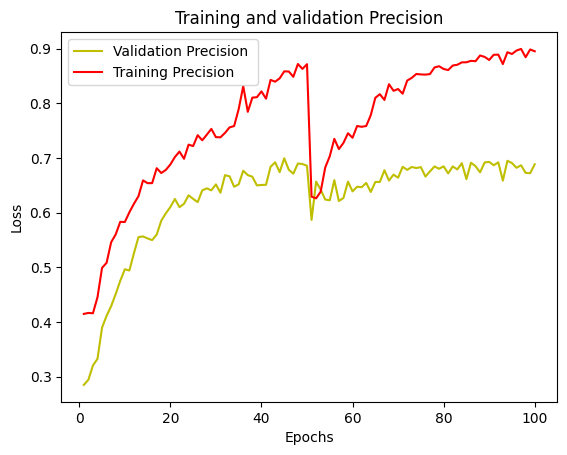

In [127]:
###
#plot the training and validation accuracy and loss at each epoch

epochs = range(1, len(val_precision) + 1)
plt.plot(epochs, val_precision, 'y', label='Validation Precision ')
plt.plot(epochs, train_precision, 'r', label='Training Precision')
plt.title('Training and validation Precision')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

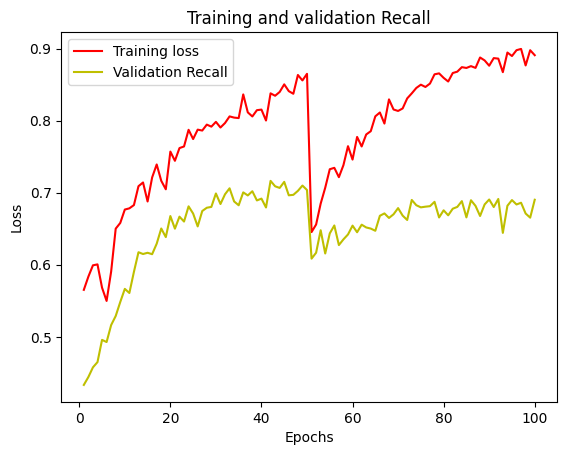

In [128]:
###
#plot the training and validation accuracy and loss at each epoch

epochs = range(1, len(val_recall) + 1)
plt.plot(epochs, train_recall, 'r', label='Training loss')
plt.plot(epochs, val_recall, 'y', label='Validation Recall')
plt.title('Training and validation Recall')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

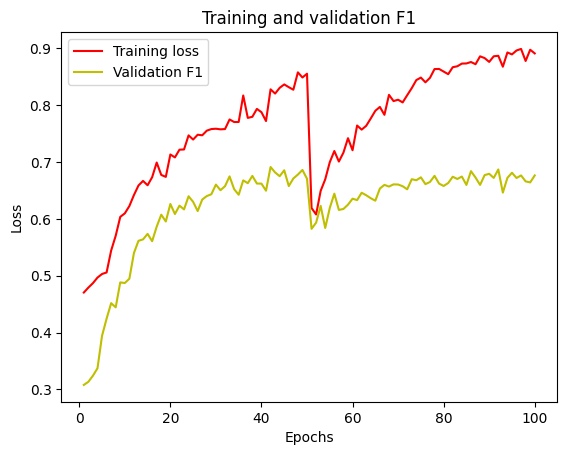

In [130]:
###
#plot the training and validation accuracy and loss at each epoch

epochs = range(1, len(val_f1) + 1)
plt.plot(epochs, train_f1, 'r', label='Training loss')
plt.plot(epochs, val_f1, 'y', label='Validation F1')
plt.title('Training and validation F1')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

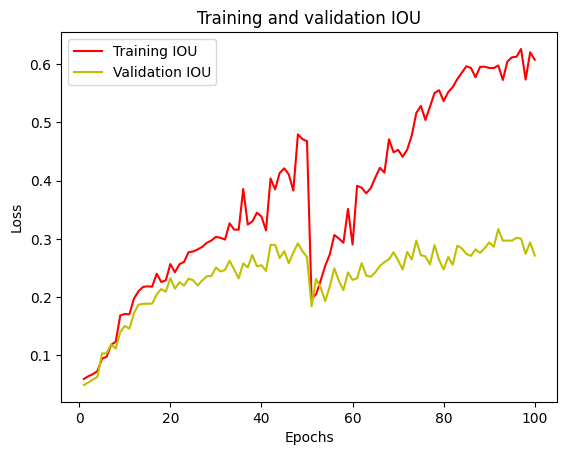

In [131]:
###
#plot the training and validation accuracy and loss at each epoch

epochs = range(1, len(val_iou) + 1)
plt.plot(epochs, train_iou, 'r', label='Training IOU')
plt.plot(epochs, val_iou, 'y', label='Validation IOU')
plt.title('Training and validation IOU')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

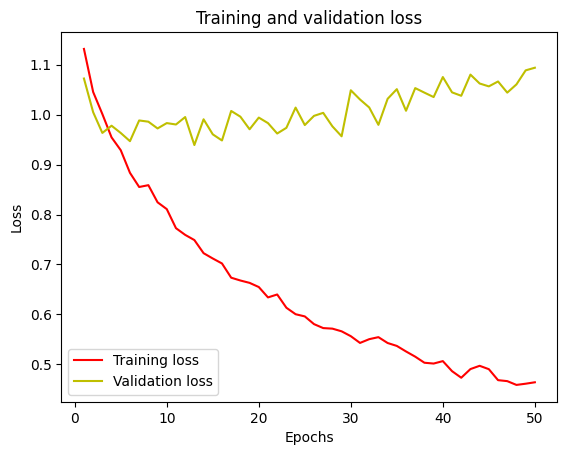

In [132]:
###
#plot the training and validation accuracy and loss at each epoch
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'y', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

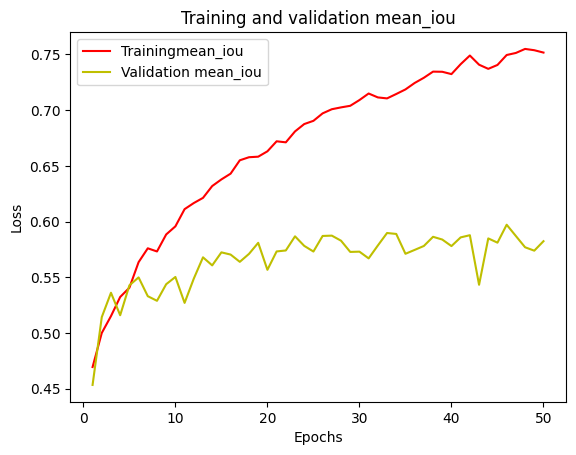

In [133]:
###
#plot the training and validation accuracy and loss at each epoch
loss = history.history['mean_iou']
val_loss = history.history['val_mean_iou']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'r', label='Trainingmean_iou')
plt.plot(epochs, val_loss, 'y', label='Validation mean_iou')
plt.title('Training and validation mean_iou')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

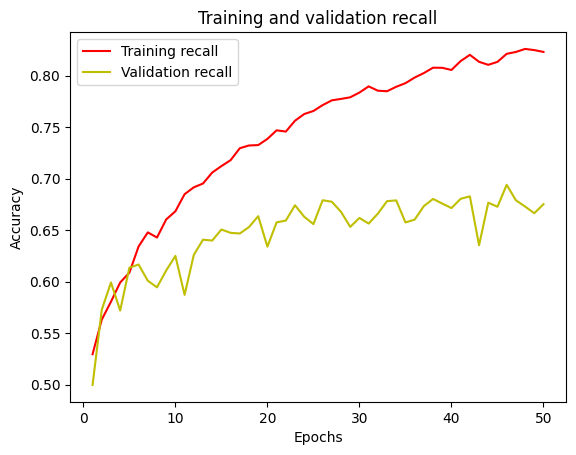

In [134]:
acc = history.history['recall']
val_acc = history.history['val_recall']

plt.plot(epochs, acc, 'r', label='Training recall')
plt.plot(epochs, val_acc, 'y', label='Validation recall')
plt.title('Training and validation recall')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

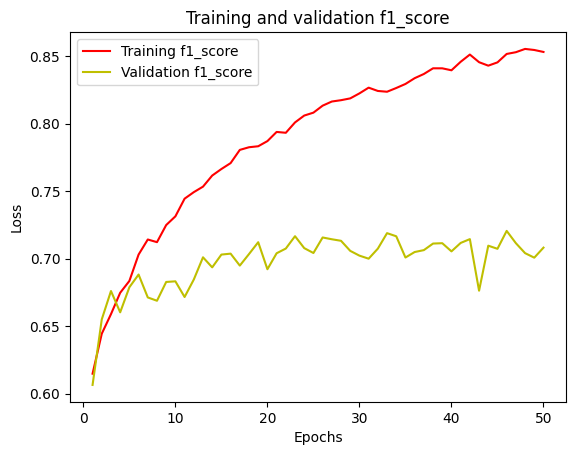

In [135]:
###
#plot the training and validation accuracy and loss at each epoch
loss = history.history['f1_score']
val_loss = history.history['val_f1_score']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'r', label='Training f1_score')
plt.plot(epochs, val_loss, 'y', label='Validation f1_score')
plt.title('Training and validation f1_score')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [136]:
###
#plot the training and validation accuracy and loss at each epoch
loss = history.history['f1']
val_loss = history.history['val_f1']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'r', label='Training f1')
plt.plot(epochs, val_loss, 'y', label='Validation f1')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

KeyError: 'f1'

In [60]:
history.history.keys()

dict_keys(['loss', 'accuracy', 'mean_iou', 'val_loss', 'val_accuracy', 'val_mean_iou'])

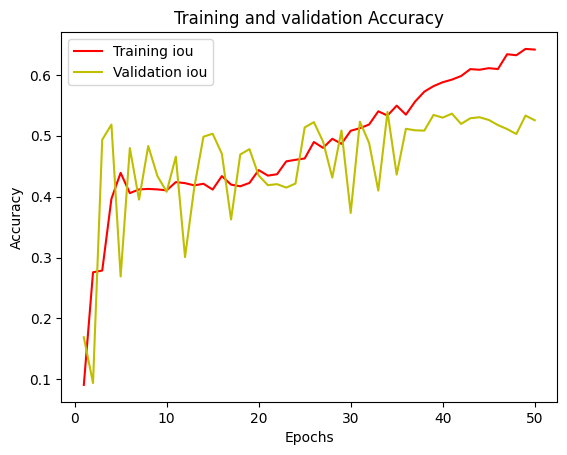

In [318]:
acc = history.history['mean_iou']
val_acc = history.history['val_mean_iou']

plt.plot(epochs, acc, 'r', label='Training iou')
plt.plot(epochs, val_acc, 'y', label='Validation iou')
plt.title('Training and validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
test56.txt

In [ ]:
%tensorboard --logdir '/kaggle/working/LOGS'

In [137]:
#Save history 
my_file = open('./history_.txt','w+')
with open("history_14.txt", 'w+') as f:
    for key, value in history.history.items():
        f.write('%s:%s\n' % (key, value))


In [56]:
#Save history 
my_file = open('./history_14_test_val.txt','w+')
with open("history_14_test_val.txt", 'w+') as f:
    for key,val in metrics_callback.metrics_history.items():
        f.write('%s: %s' % (key,val))

In [320]:
type(metrics_callback.metrics_history)

dict

In [138]:
y_pred=model.predict(X_test)
y_pred_argmax=np.argmax(y_pred, axis=3)

9/9 [==============================] - 0s 26ms/step


In [58]:
y_test.shape

(282, 128, 128, 1)

In [139]:
#Using built in keras function
from keras.metrics import MeanIoU
n_classes = n_classes
IOU_keras = MeanIoU(num_classes=n_classes)
IOU_keras.update_state(y_test[:,:,:,0], y_pred_argmax)
print("Mean IoU =", IOU_keras.result().numpy())

Mean IoU = 0.35491556


In [140]:
#To calculate I0U for each class...
values = np.array(IOU_keras.get_weights()).reshape(n_classes, n_classes)
print(values)
class1_IoU = values[0,0]/(values[0,0] + values[0,1] + values[0,2] + values[0,3] + values[1,0]+ values[2,0]+ values[3,0])
class2_IoU = values[1,1]/(values[1,1] + values[1,0] + values[1,2] + values[1,3] + values[0,1]+ values[2,1]+ values[3,1])
class3_IoU = values[2,2]/(values[2,2] + values[2,0] + values[2,1] + values[2,3] + values[0,2]+ values[1,2]+ values[3,2])
class4_IoU = values[3,3]/(values[3,3] + values[3,0] + values[3,1] + values[3,2] + values[0,3]+ values[1,3]+ values[2,3])


print("IoU for class1 is: ", class1_IoU)
print("IoU for class2 is: ", class2_IoU)
print("IoU for class3 is: ", class3_IoU)
print("IoU for class4 is: ", class4_IoU)


[[1.682063e+06 1.053990e+05 5.122900e+04 9.352500e+04 3.165700e+04
  2.564700e+04 2.166100e+04 7.153000e+03 6.180000e+03 3.393200e+04
  6.769000e+03 1.271400e+04 1.824200e+04 5.263000e+03]
 [1.370150e+05 4.758140e+05 3.046100e+04 3.146800e+04 3.863000e+03
  2.188000e+03 8.910000e+02 2.882000e+03 3.940000e+02 6.077000e+03
  1.360000e+03 1.631000e+03 6.623000e+03 8.840000e+02]
 [3.200500e+04 1.191300e+04 4.876030e+05 1.404900e+04 4.971000e+03
  1.630000e+02 3.200000e+01 2.400000e+01 3.560000e+02 5.767000e+03
  3.500000e+01 3.600000e+01 3.620000e+02 4.600000e+01]
 [4.630300e+04 1.410200e+04 6.157000e+03 2.145380e+05 3.383000e+03
  6.200000e+02 1.764000e+03 1.590000e+02 7.900000e+01 1.660100e+04
  2.070000e+02 1.780000e+02 8.110000e+02 3.791000e+03]
 [7.017200e+04 6.590000e+03 2.138900e+04 1.296100e+04 1.687150e+05
  4.630000e+02 5.400000e+01 2.370000e+02 5.500000e+01 4.000000e+01
  7.200000e+01 7.000000e+00 3.264000e+03 1.000000e+00]
 [4.722600e+04 8.530000e+02 1.110000e+02 1.342000e+03 2

In [141]:
# Get the confusion matrix from the metric's weights
confusion_matrix = np.array(IOU_keras.get_weights()).reshape(n_classes, n_classes)

# Compute IoU for each class using the confusion matrix
iou_per_class = np.diag(confusion_matrix) / (np.sum(confusion_matrix, axis=1) + np.sum(confusion_matrix, axis=0) - np.diag(confusion_matrix))

# Print IoU for each class
for i, iou in enumerate(iou_per_class):
    print(f"Class {i}: IoU = {iou:.4f}")

Class 0: IoU = 0.6249
Class 1: IoU = 0.5524
Class 2: IoU = 0.7152
Class 3: IoU = 0.4505
Class 4: IoU = 0.5142
Class 5: IoU = 0.5286
Class 6: IoU = 0.2107
Class 7: IoU = 0.1840
Class 8: IoU = 0.1405
Class 9: IoU = 0.3379
Class 10: IoU = 0.2563
Class 11: IoU = 0.0676
Class 12: IoU = 0.2380
Class 13: IoU = 0.1481


In [84]:
values.shape

(14, 14)

Classes in image :  [ 0  2  3  5  6  7 10 12 13 17 21 22 26 27]


Text(0.5, 1.0, 'Coloured class mask')

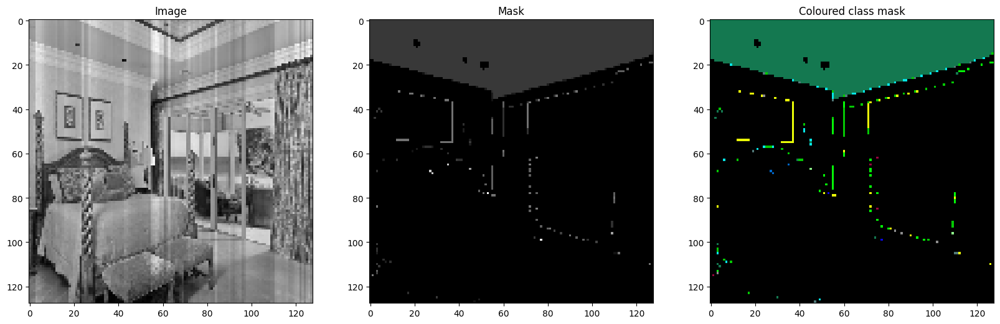

In [142]:
#Sanity check
print("Classes in image : ",np.unique(train_masks))
plt.figure(figsize=(20, 20))
plt.subplot(131)
plt.imshow(train_images[1, :,:,0], cmap='gray')
plt.title("Image")
plt.subplot(132)
plt.imshow(train_masks[1],cmap='gray')
plt.title("Mask")
plt.subplot(133)
plt.imshow(masked_image_dataset[1],cmap='gray')
plt.title("Coloured class mask")

In [143]:
#Randomly selecting images to test
test_img_number = random.randint(0, len(X1))
test_img = X1[test_img_number]
ground_truth=y1[test_img_number]
test_img_norm=test_img[:,:,0][:,:,None]
test_img_input=np.expand_dims(test_img_norm, 0)
prediction = (model.predict(test_img_input))
predicted_img=np.argmax(prediction, axis=3)[0,:,:]

1/1 [==============================] - 0s 20ms/step


Unique classes in test_img Image:  [0.         0.00061539 0.00064836 ... 0.29082383 0.29746364 0.30941531]
Unique classes in ground_truth Image:  [0 1 2 3 4 5 6 7 8]
Unique classes in Predicted Image:  [ 0  1  2  3  7  8 10 12]


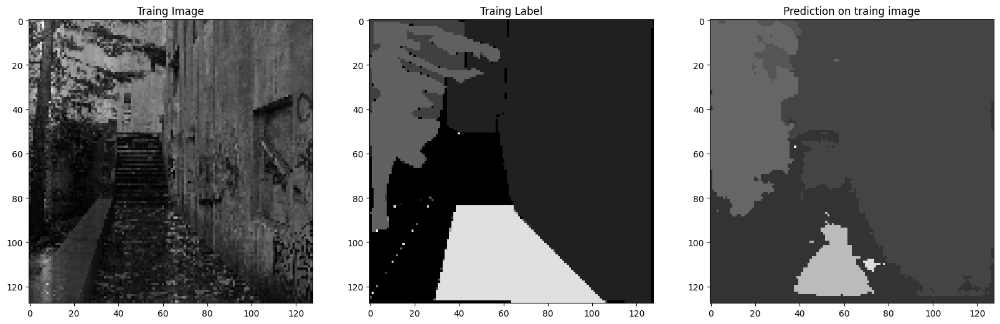

In [144]:
print("Unique classes in test_img Image: ",np.unique(test_img))
print("Unique classes in ground_truth Image: ",np.unique(ground_truth))
print("Unique classes in Predicted Image: ",np.unique(predicted_img))
plt.figure(figsize=(20, 20))
plt.subplot(231)
plt.title('Traing Image')
plt.imshow(test_img[:,:,0], cmap='gray')
plt.subplot(232)
plt.title('Traing Label')
plt.imshow(ground_truth[:,:,0], cmap='gray')

plt.subplot(233)
plt.title('Prediction on traing image')
#plt.imshow(predicted_img, cmap='jet')


plt.imshow(predicted_img, cmap='gray', alpha=0.8) # interpolation='none'
plt.show()
plt.show()


In [76]:
ground_truth[:,:,0]

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [ ]:
!pip install visualkeras

In [77]:
import visualkeras
visualkeras.layered_view(model,to_file='output.png')

ModuleNotFoundError: No module named 'visualkeras'

1/1 [==============================] - 0s 29ms/step
Unique Classes in Testing Image  [ 0  1  2  5  7  8  9 10 13]
Unique Classes in predicted taesting image  [0 1 2 3 7]


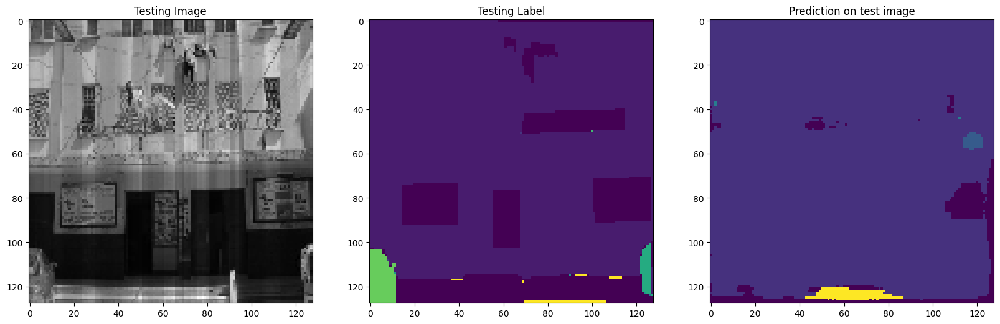

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


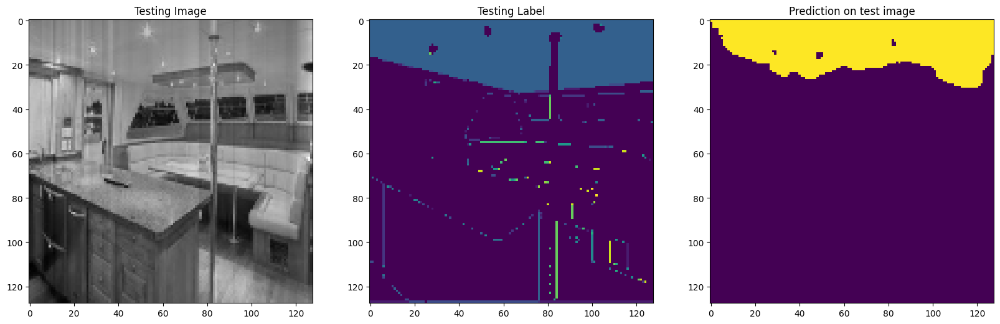

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [0 2 3 6]


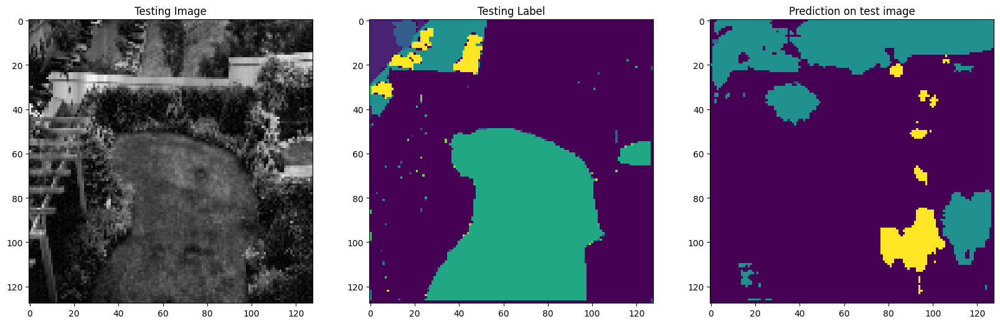

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  2  3  5  6  9 11]


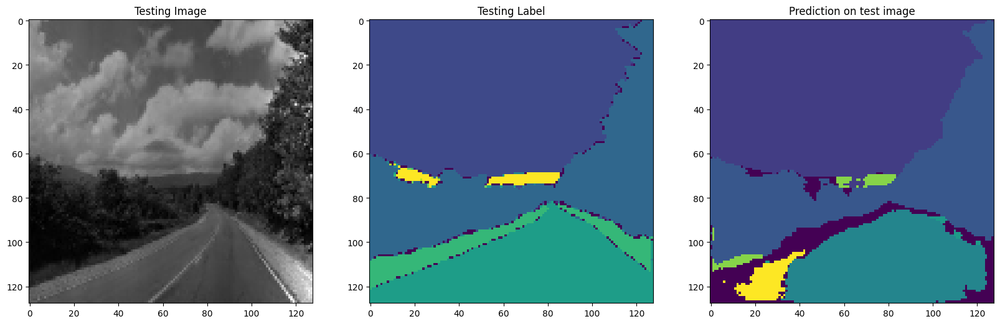

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 11 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  6 12]


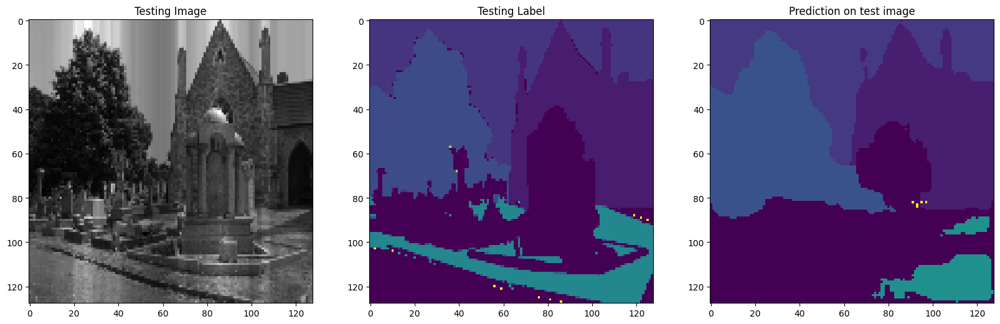

1/1 [==============================] - 0s 26ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12]
Unique Classes in predicted taesting image  [0 2 3 4 5 8]


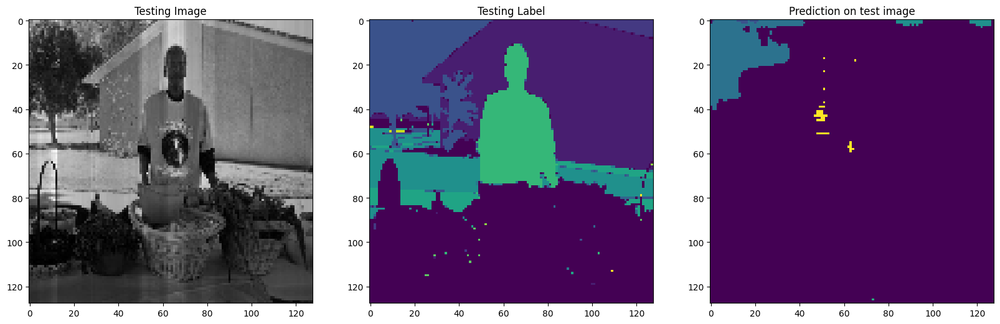

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 13]
Unique Classes in predicted taesting image  [ 0  2  3  5  6  7 11]


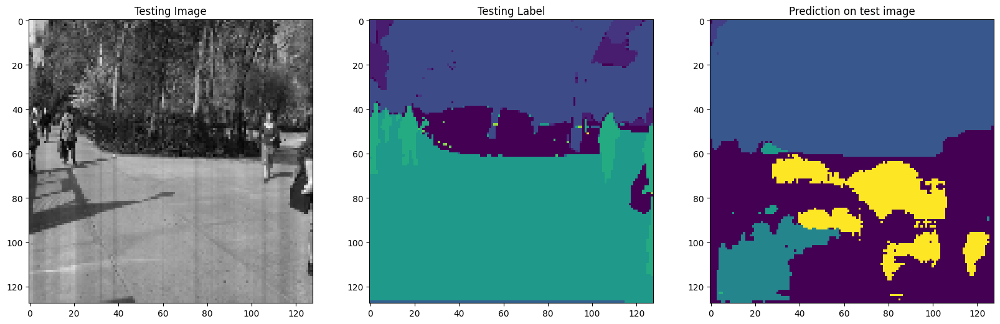

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 13]
Unique Classes in predicted taesting image  [0 1 2 3 6 8]


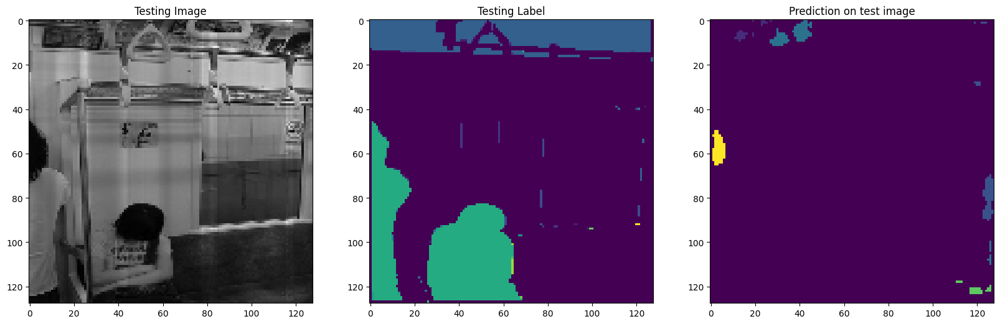

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 10 11]
Unique Classes in predicted taesting image  [0 1 2 3 5 8]


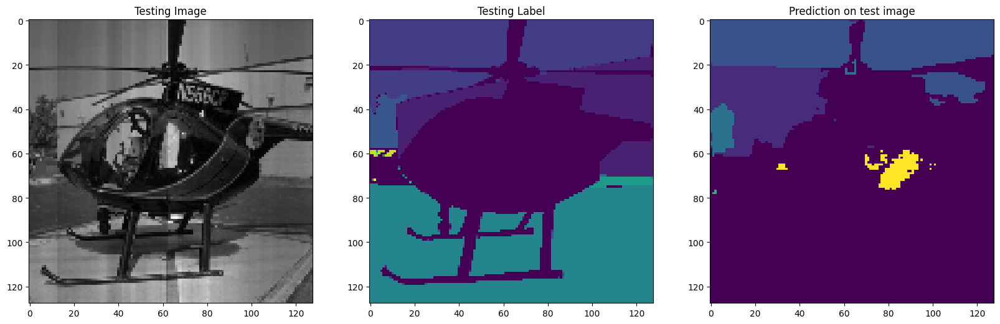

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [0 1 2 4 5 7]


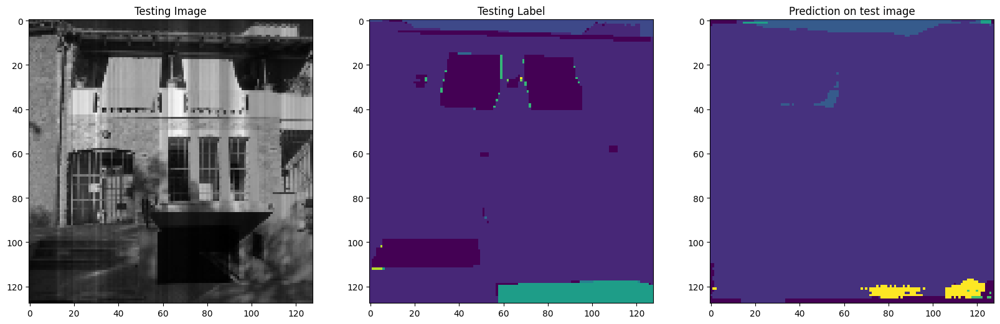

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


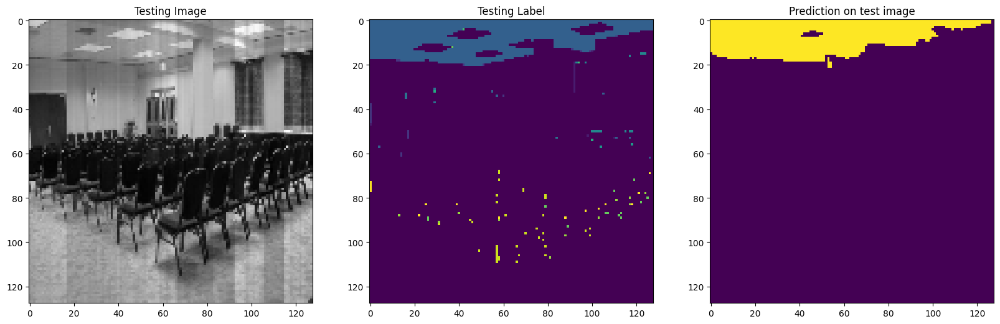

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  5  7 10 13]
Unique Classes in predicted taesting image  [ 0  2  3  9 11 13]


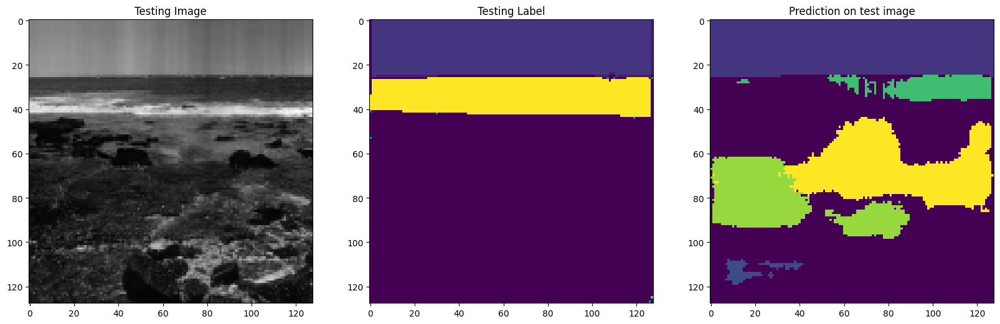

1/1 [==============================] - 0s 25ms/step
Unique Classes in Testing Image  [ 0  2  3  5  7 10 11]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  5  6 11 12 13]


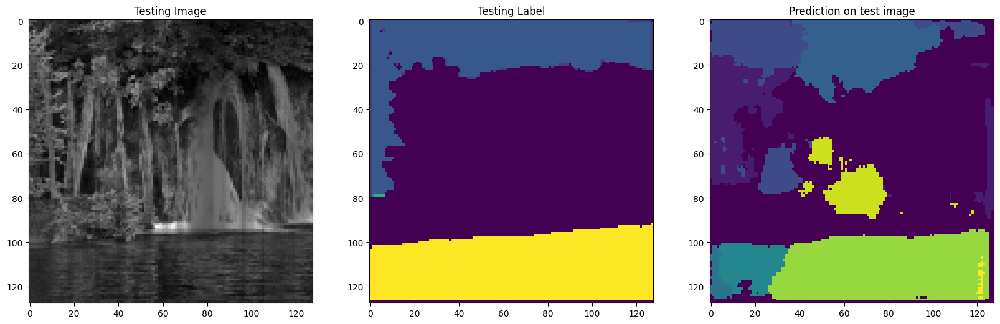

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [0 1 2 3 7 9]


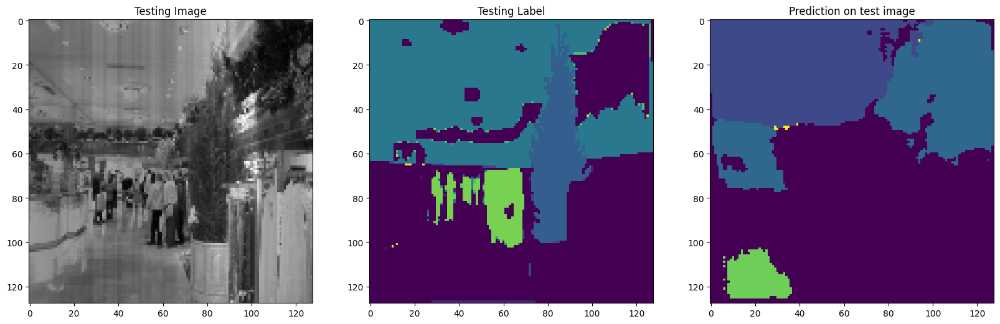

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 13]
Unique Classes in predicted taesting image  [0 1 2 3 4 5 7]


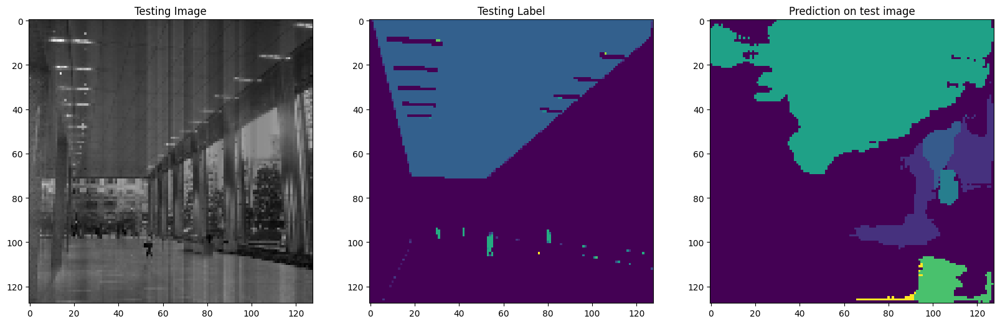

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10 11 12]
Unique Classes in predicted taesting image  [0 4]


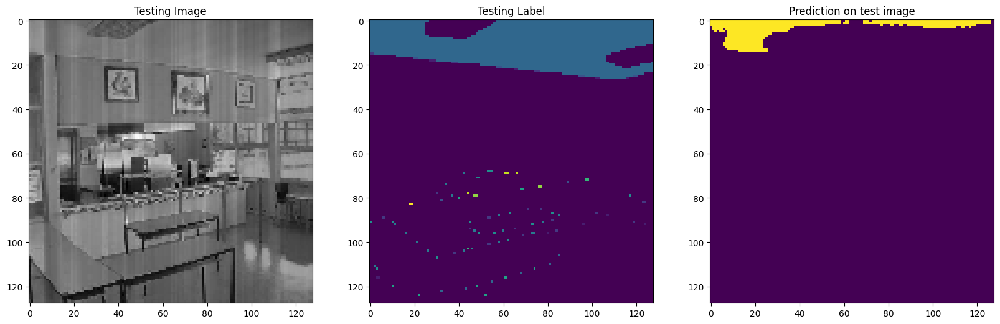

1/1 [==============================] - 0s 24ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  7  8 10]
Unique Classes in predicted taesting image  [0 1 2 3 4 5 6]


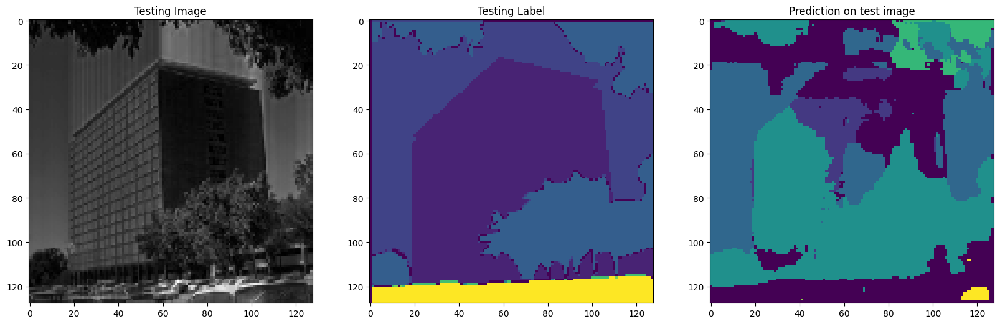

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 6 7]
Unique Classes in predicted taesting image  [0 1 2 3 5 7]


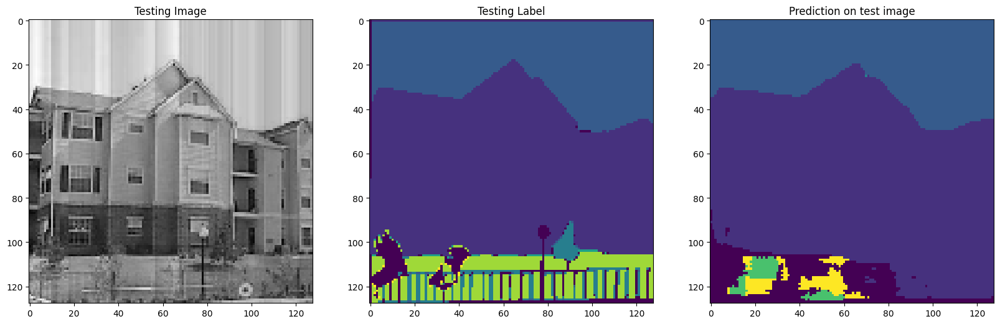

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  5  6  7  9 12]
Unique Classes in predicted taesting image  [ 0  1  2  3  6  9 11 12]


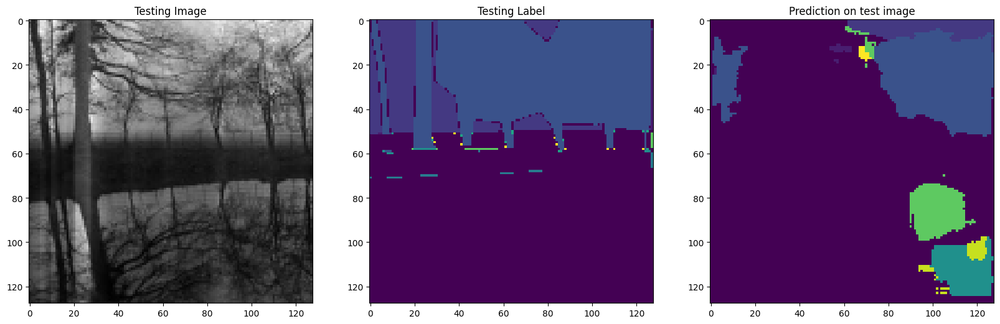

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10]
Unique Classes in predicted taesting image  [0 1 2 3 5 7 8]


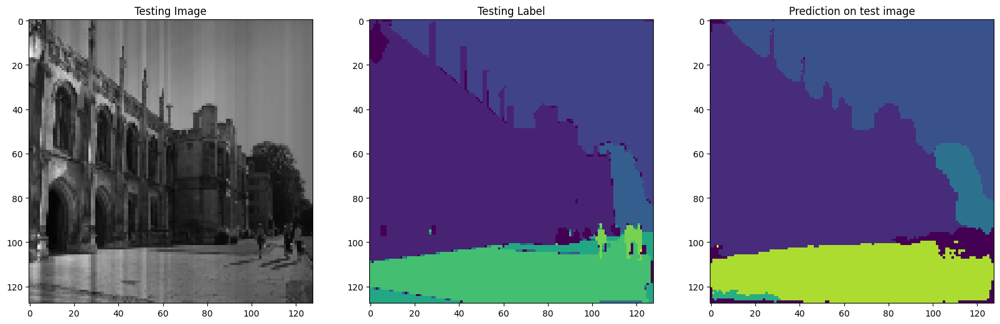

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  4  5  7  8 11 12]
Unique Classes in predicted taesting image  [0 1 2 4 5 7]


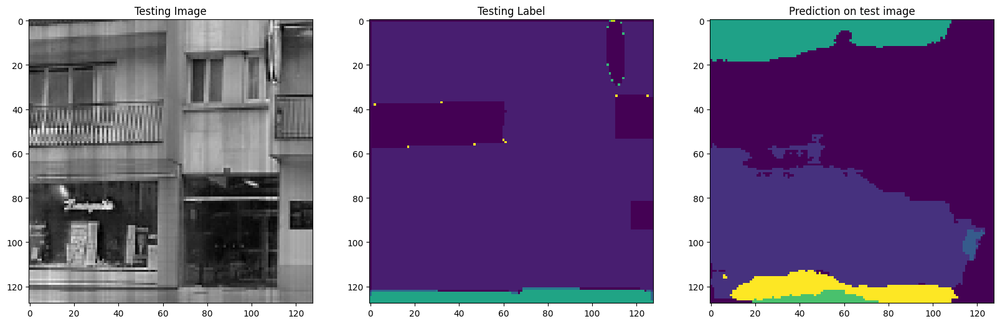

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 2 3 4 8]


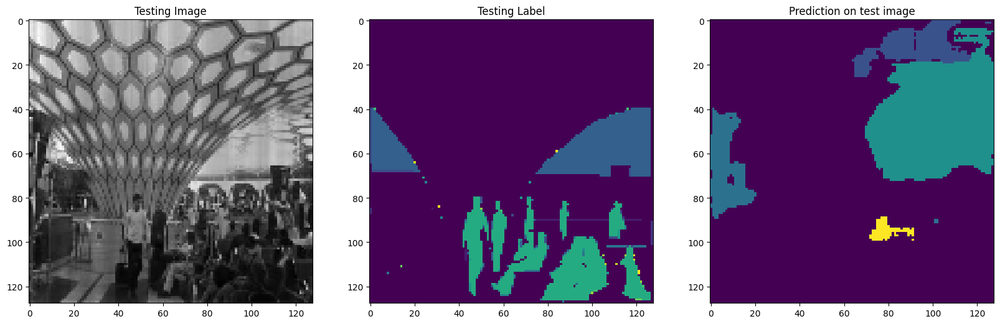

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6]
Unique Classes in predicted taesting image  [0 1 2 3 5 6]


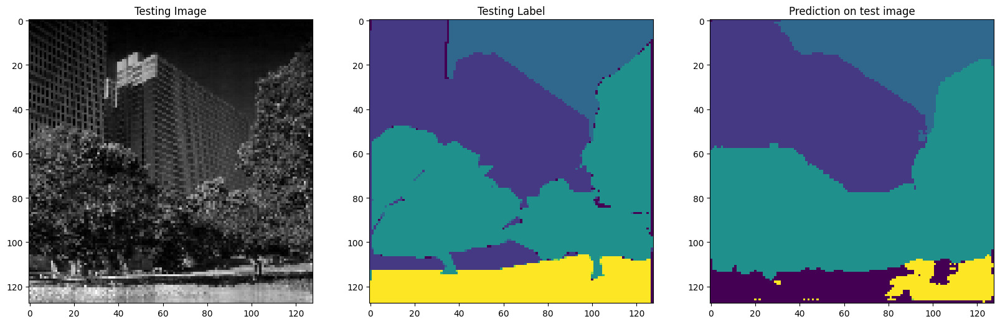

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7  8 10]


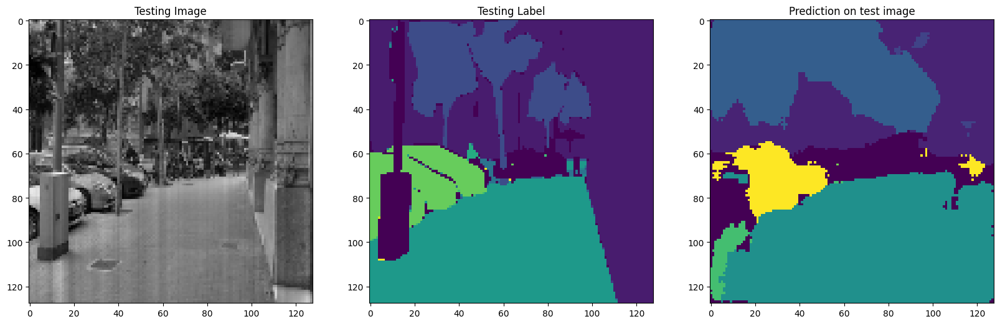

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2]
Unique Classes in predicted taesting image  [ 0  1  2  3  4 12]


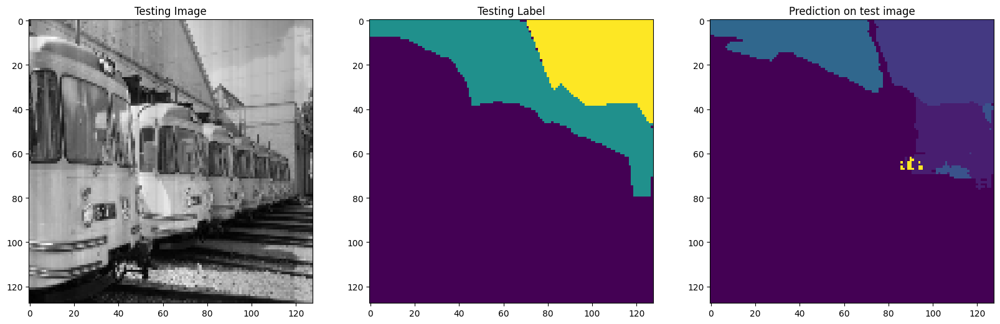

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 13]
Unique Classes in predicted taesting image  [0 4]


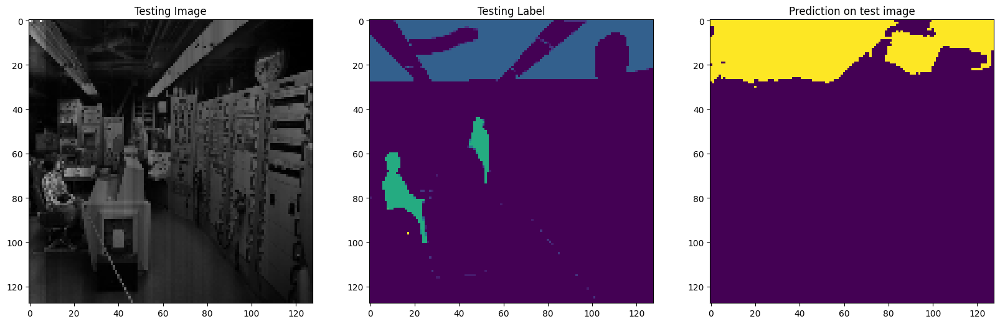

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 11 13]
Unique Classes in predicted taesting image  [ 0  2  3  4  9 12]


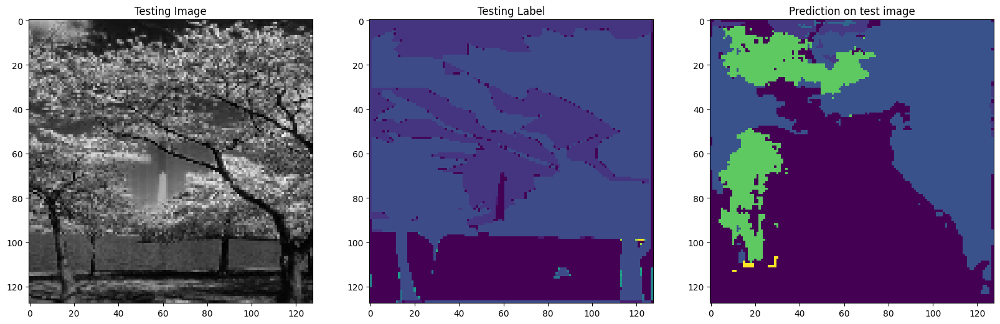

1/1 [==============================] - 0s 28ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 11 12]
Unique Classes in predicted taesting image  [ 0  2  3  6  9 13]


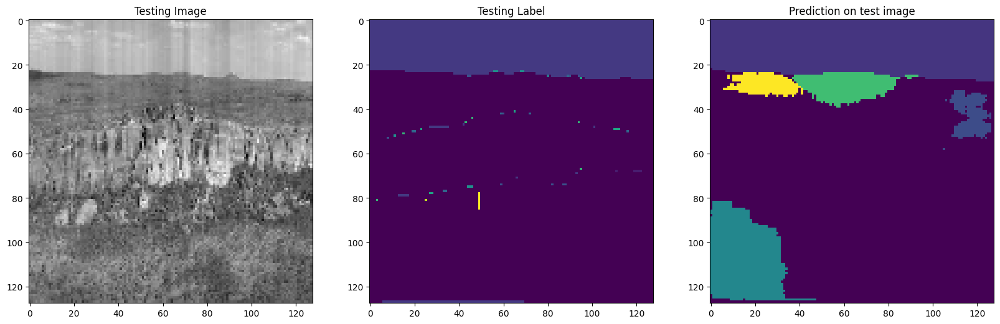

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 12]
Unique Classes in predicted taesting image  [ 0  2  3  5  7 11]


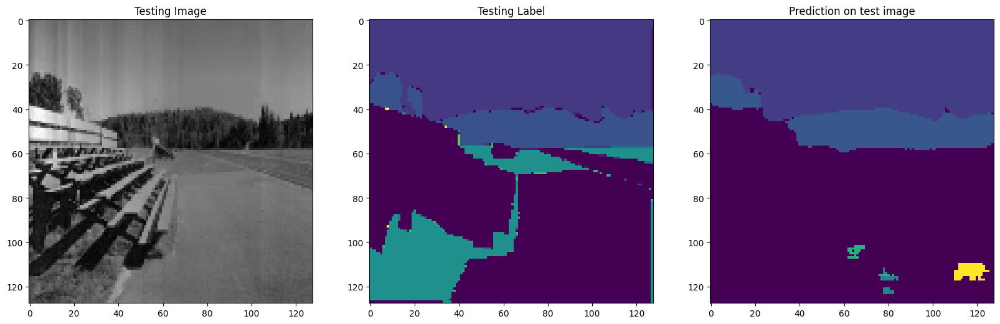

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 8 9]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 12]


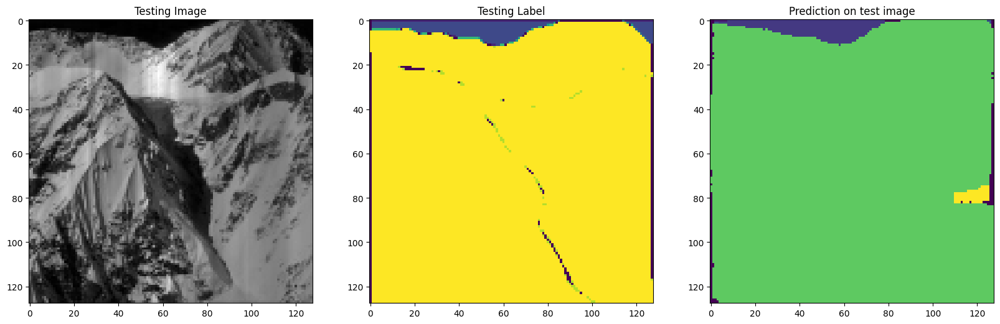

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  6 12]


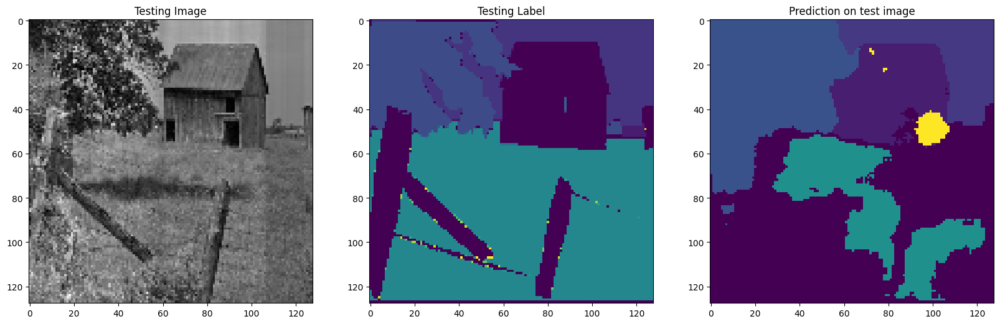

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11]
Unique Classes in predicted taesting image  [0 1 4]


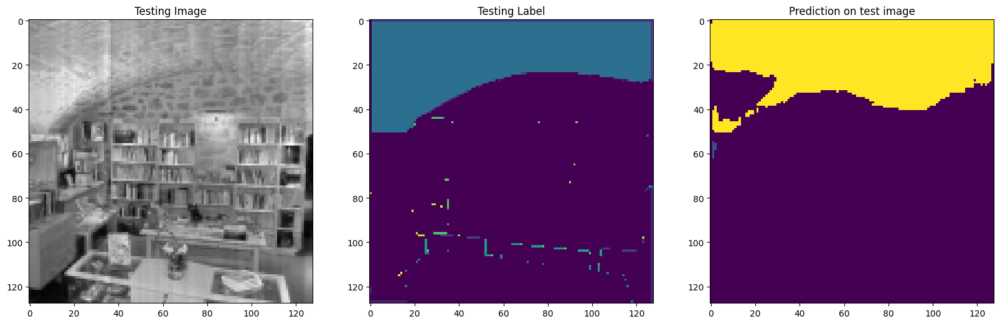

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7  8 10]


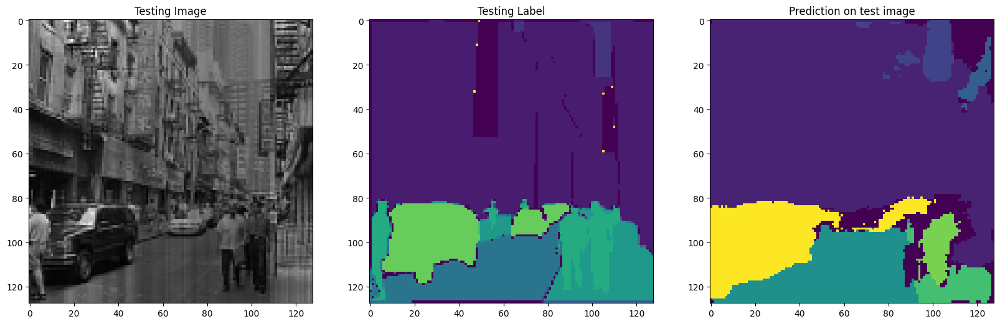

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  5  7 12]


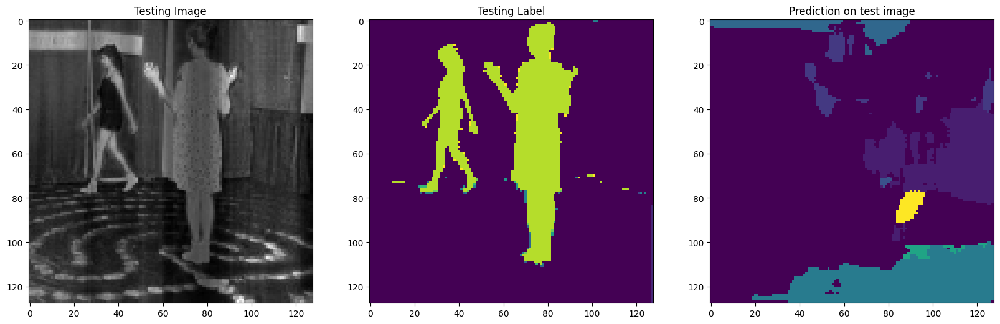

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


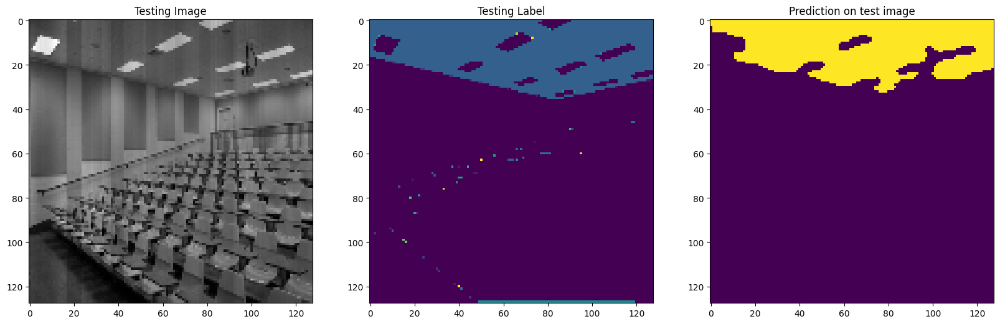

1/1 [==============================] - 0s 28ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 11]
Unique Classes in predicted taesting image  [ 0  1  2  9 12]


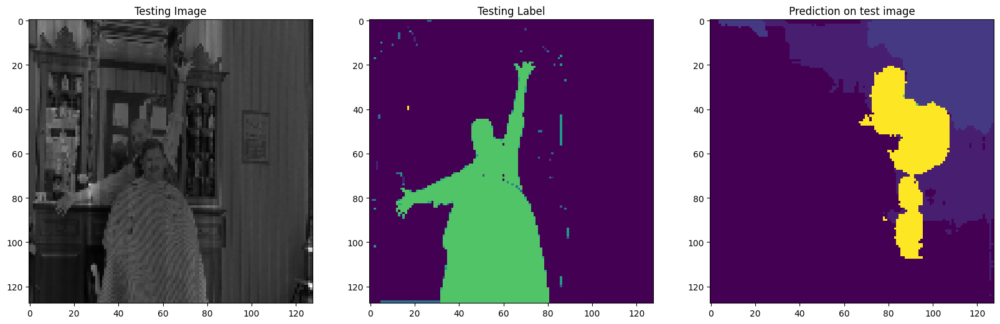

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 13]
Unique Classes in predicted taesting image  [0 2 4 5 6]


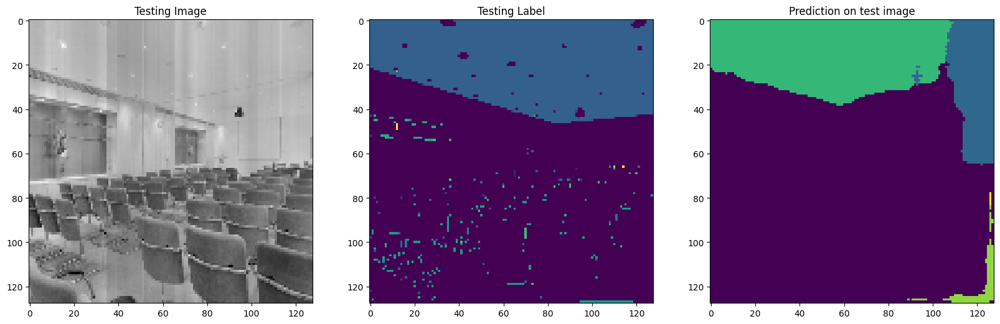

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 2 3 8]


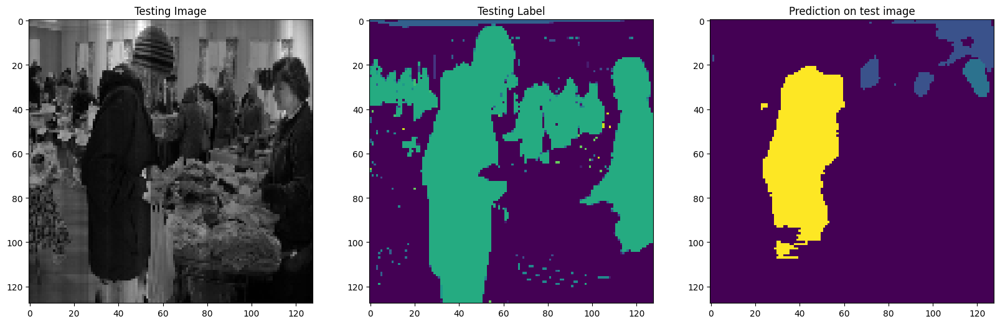

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10 11]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  9 12]


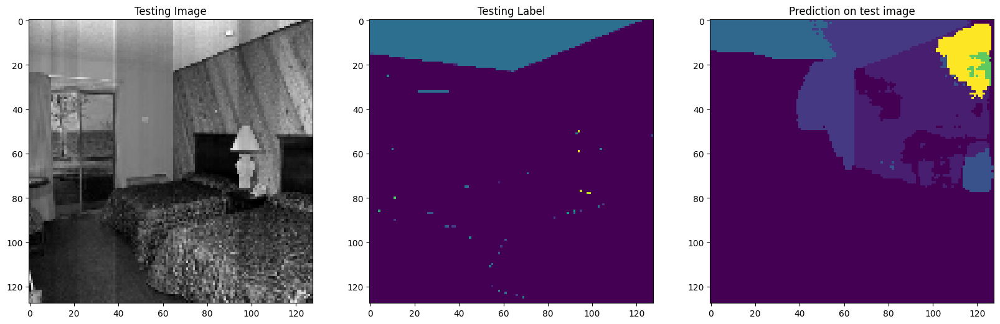

1/1 [==============================] - 0s 19ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  8 12]


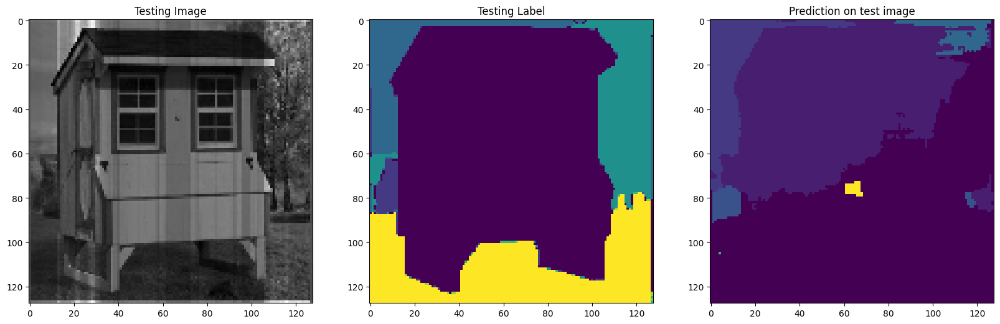

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 13]
Unique Classes in predicted taesting image  [0 2 3 4 7]


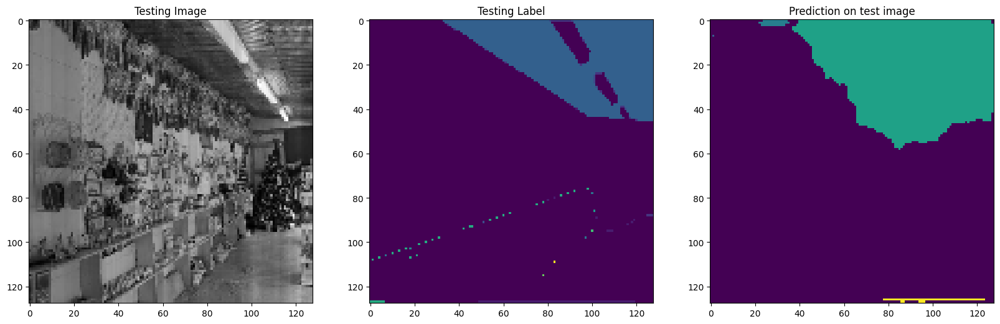

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7  8 10]


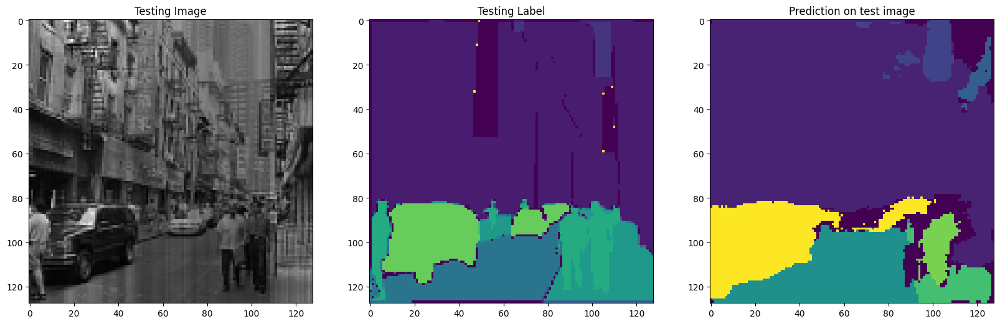

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


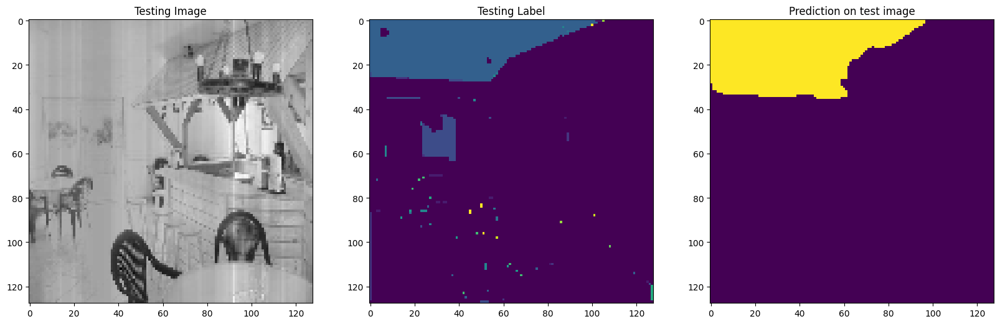

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6 10]


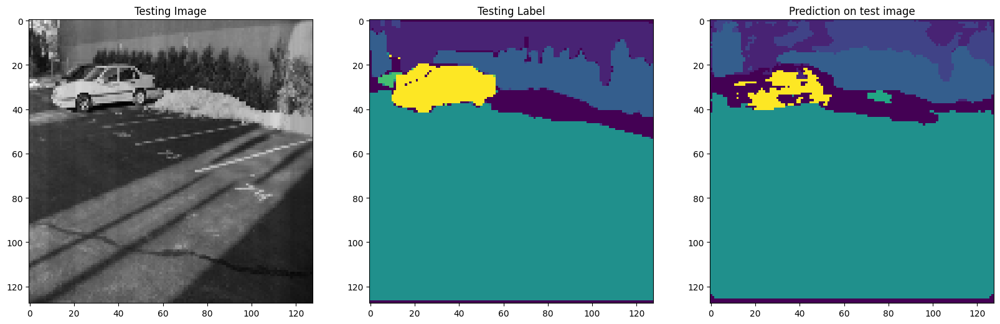

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 11]
Unique Classes in predicted taesting image  [ 0  1  3  4  6 12]


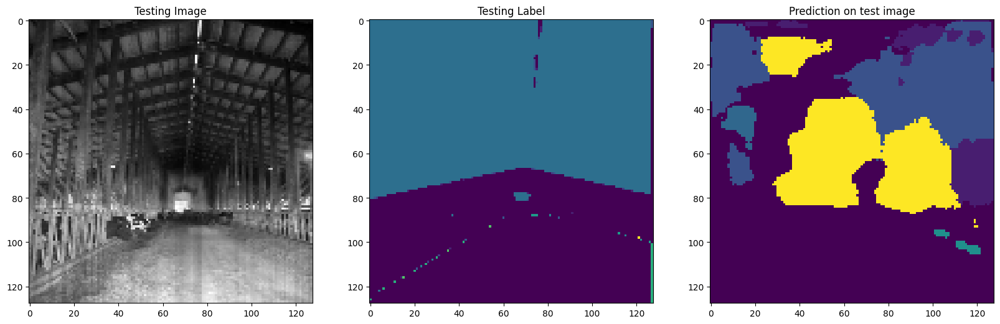

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11]
Unique Classes in predicted taesting image  [0 4 7]


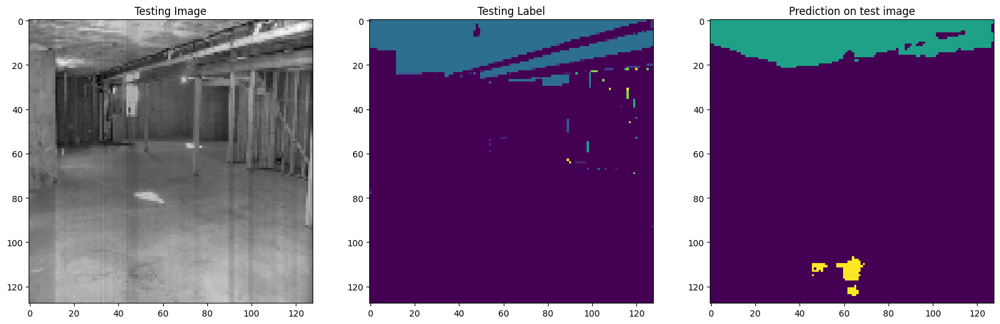

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  6  7  9 11]
Unique Classes in predicted taesting image  [0 4]


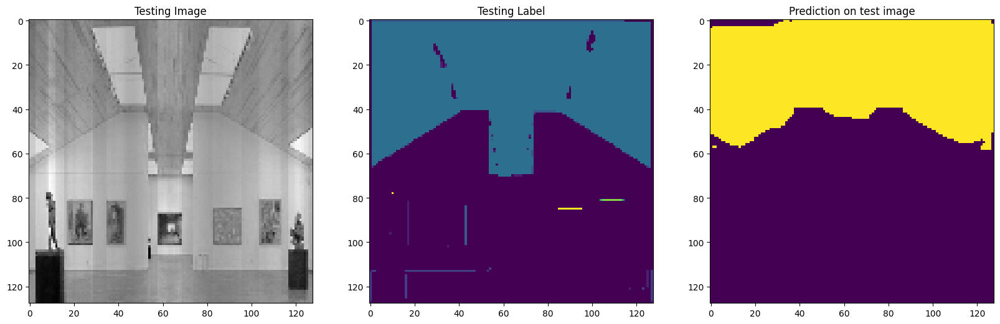

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5 10]
Unique Classes in predicted taesting image  [0 4]


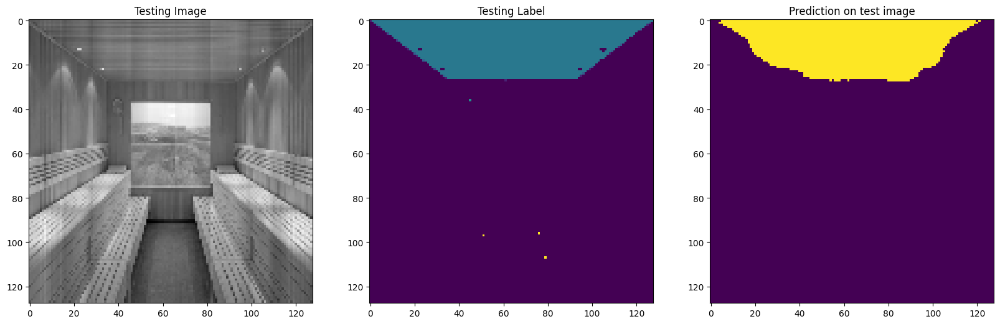

1/1 [==============================] - 0s 24ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 10]
Unique Classes in predicted taesting image  [0 2 3 9]


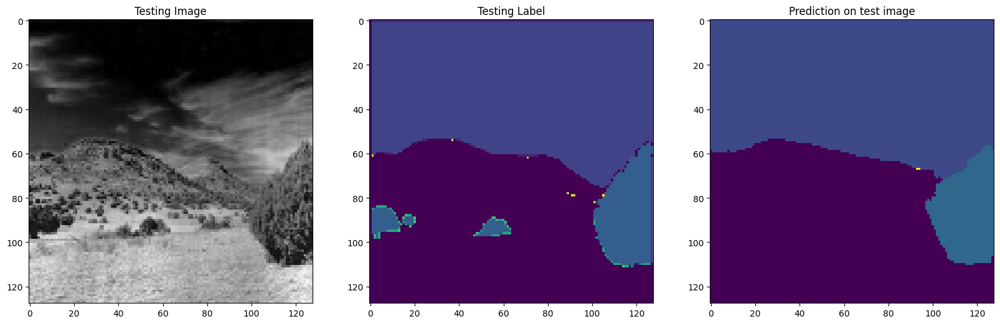

1/1 [==============================] - 0s 27ms/step
Unique Classes in Testing Image  [0 1 2 3 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 11]


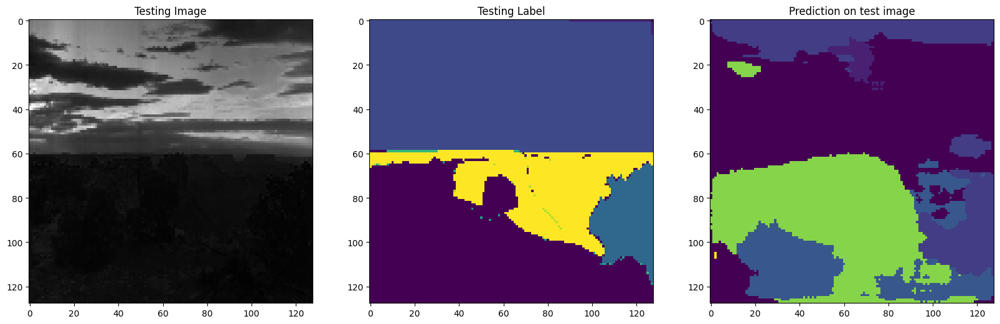

1/1 [==============================] - 0s 24ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 11]
Unique Classes in predicted taesting image  [0 1 2 3]


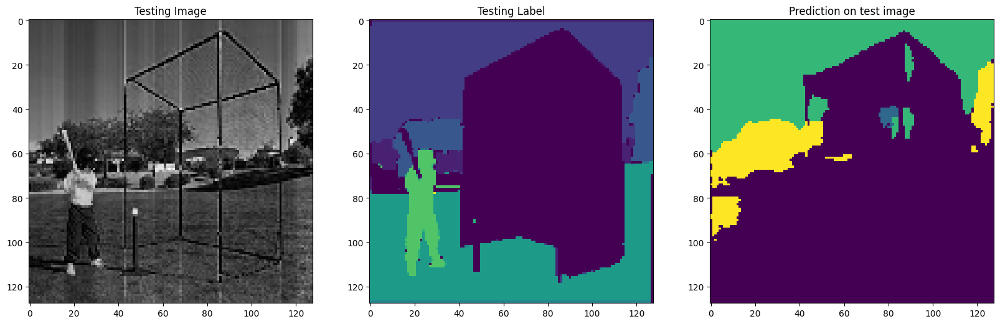

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  4 12]


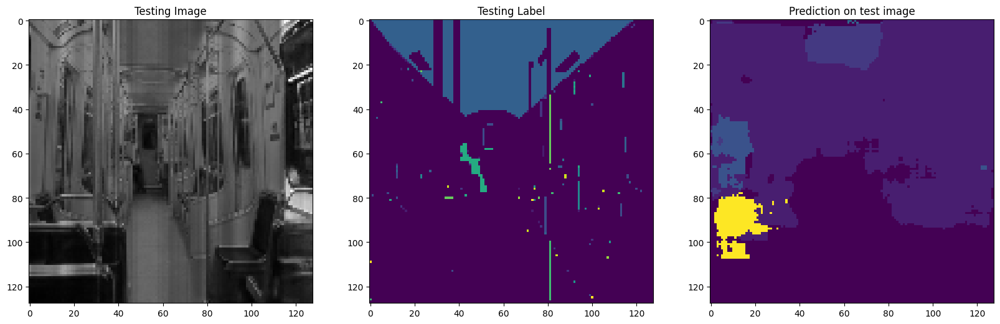

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12]
Unique Classes in predicted taesting image  [ 0  2  3  6  9 11]


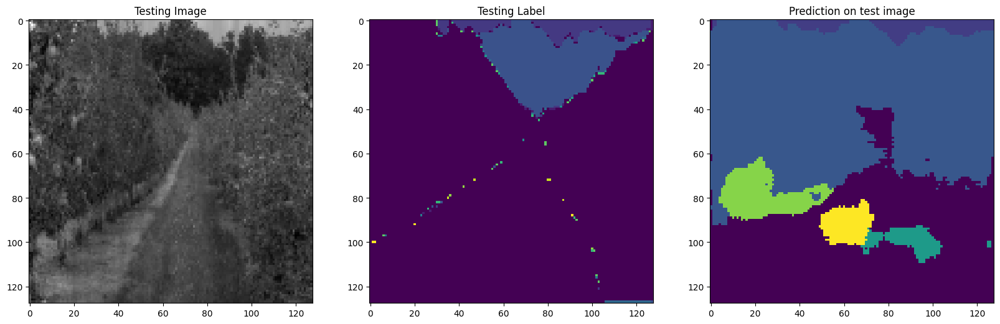

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  6  7 13]
Unique Classes in predicted taesting image  [0 1 2 3 4]


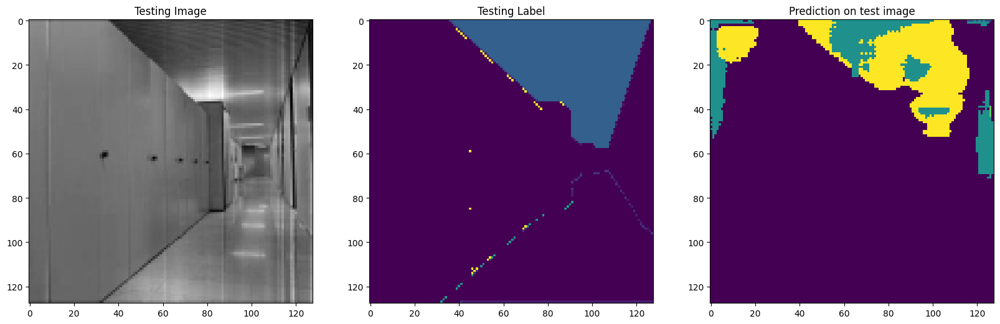

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11]
Unique Classes in predicted taesting image  [ 0  2  6  9 11]


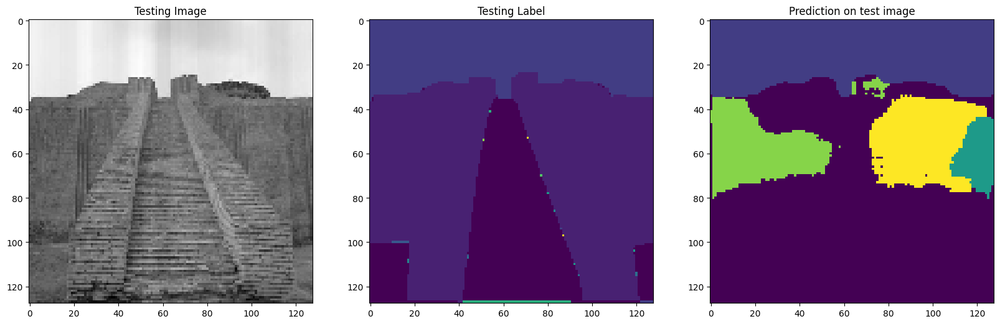

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10]


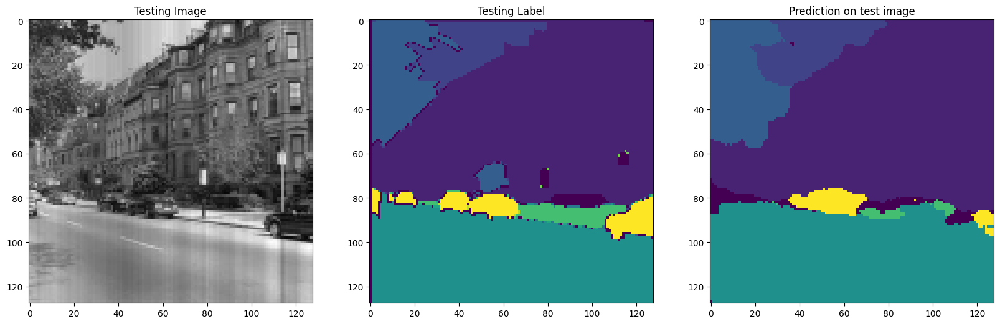

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 12]


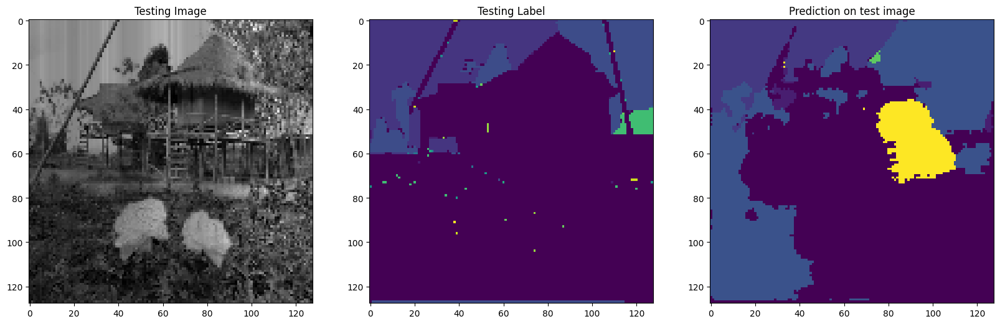

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2]
Unique Classes in predicted taesting image  [0 1 2 3 9]


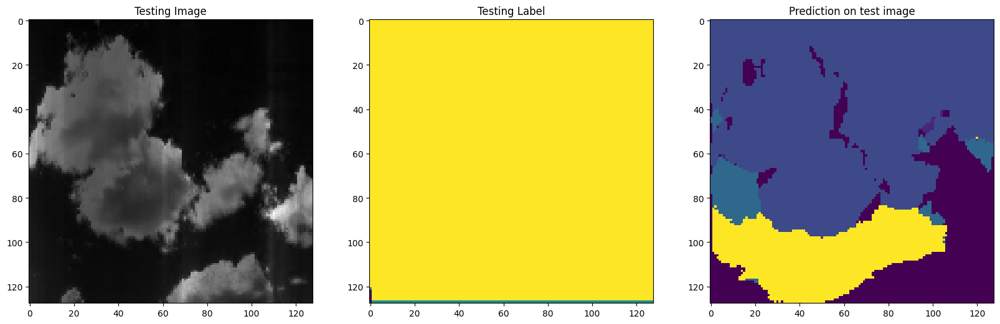

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  8  9 12 13]
Unique Classes in predicted taesting image  [0 2 3 6 9]


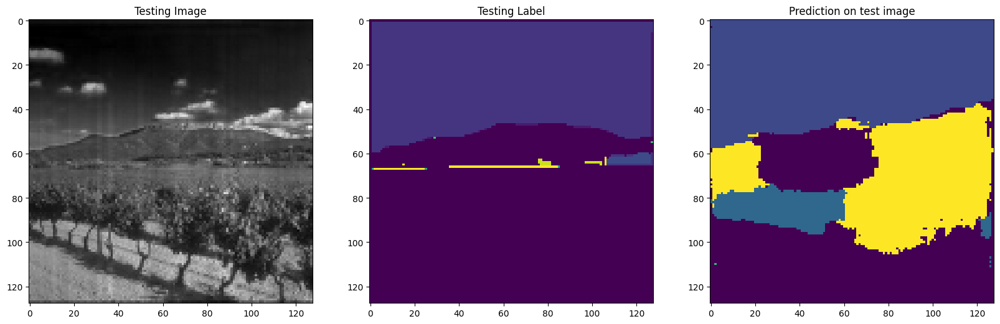

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3]
Unique Classes in predicted taesting image  [ 0  2  3  9 13]


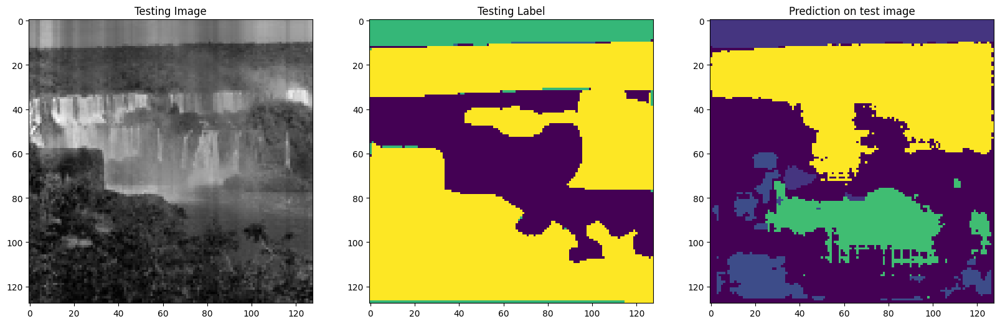

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  8  9 10 11 12]
Unique Classes in predicted taesting image  [0 4 5]


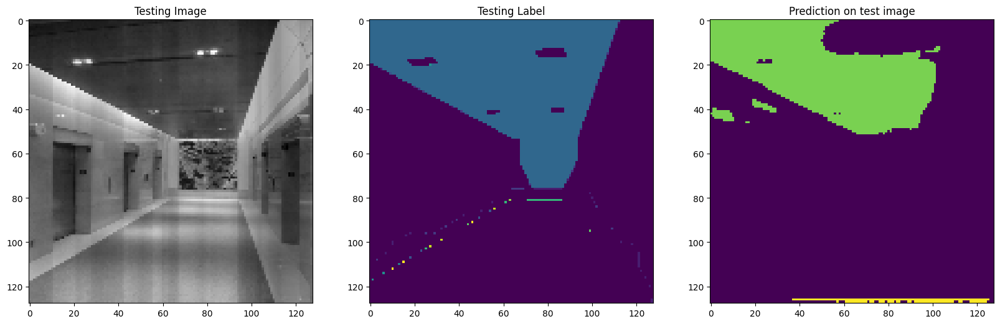

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


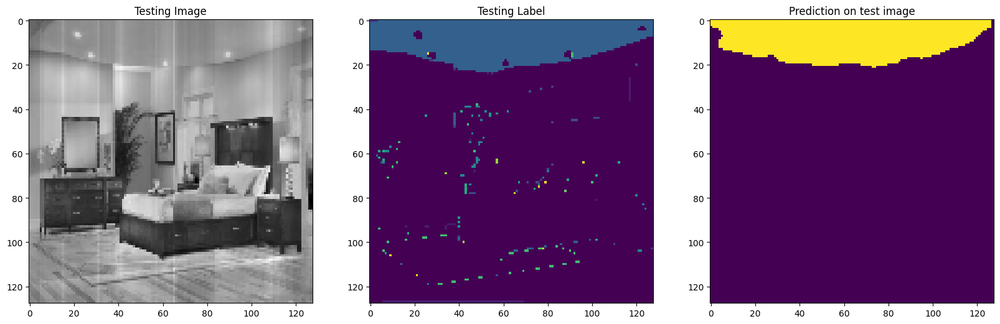

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 12]


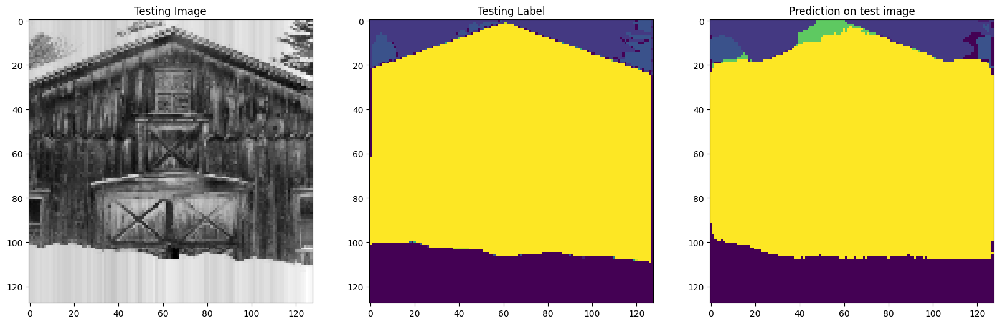

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


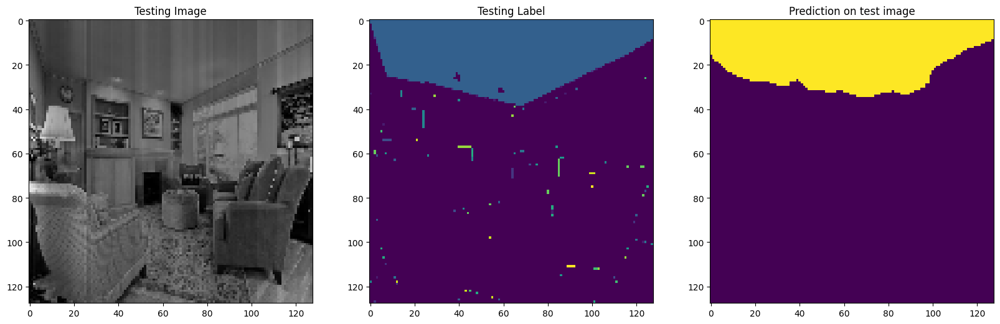

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  8 11]


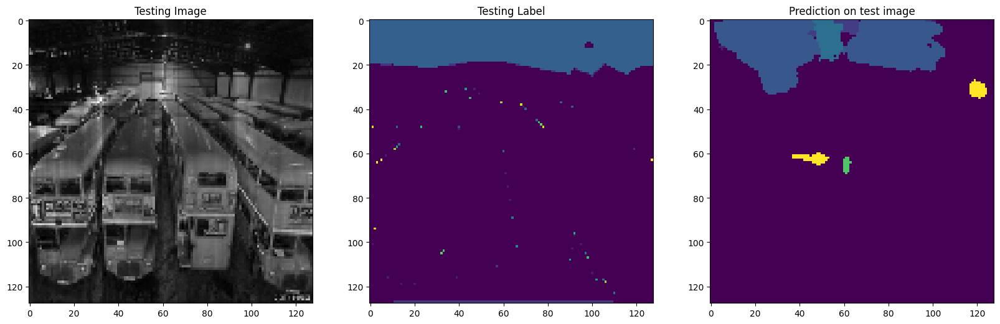

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 11]


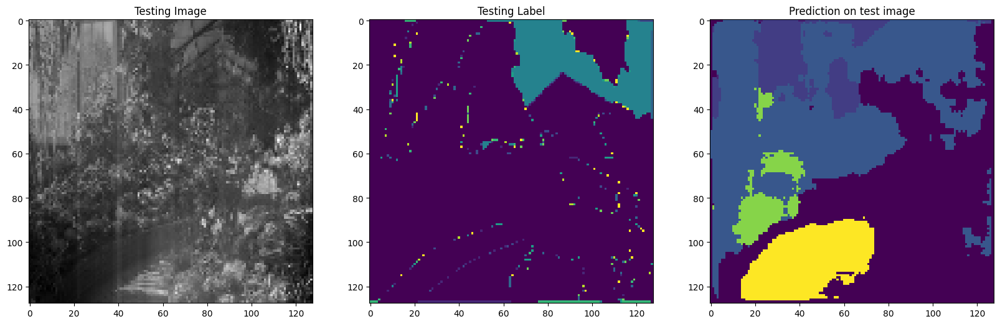

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7  9 10 12]


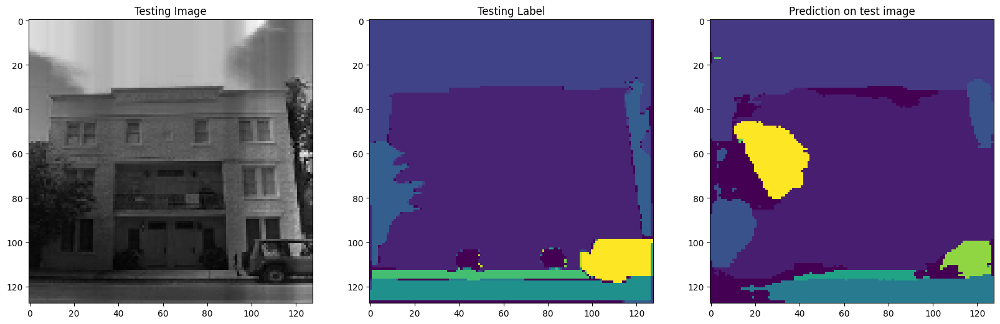

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  7  8 10]


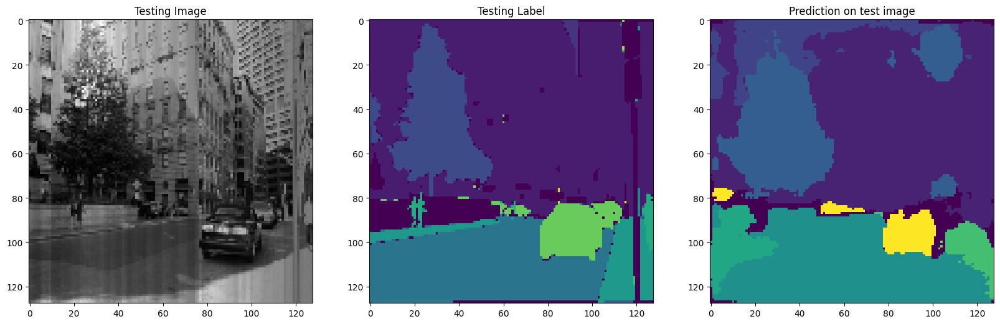

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10 12 13]
Unique Classes in predicted taesting image  [ 0  2  4  5  7 12]


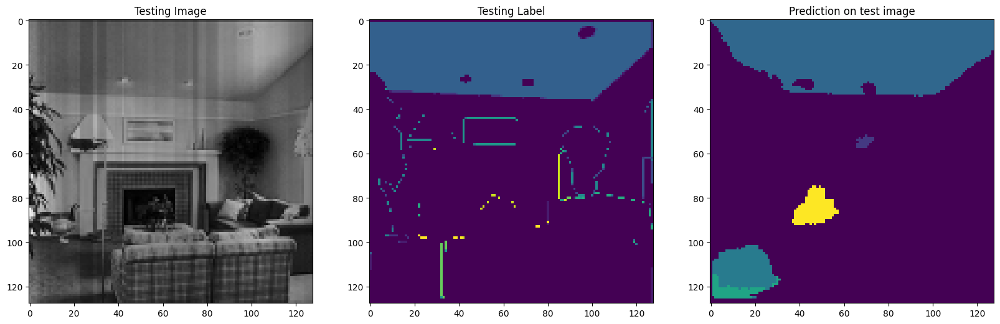

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5 10]


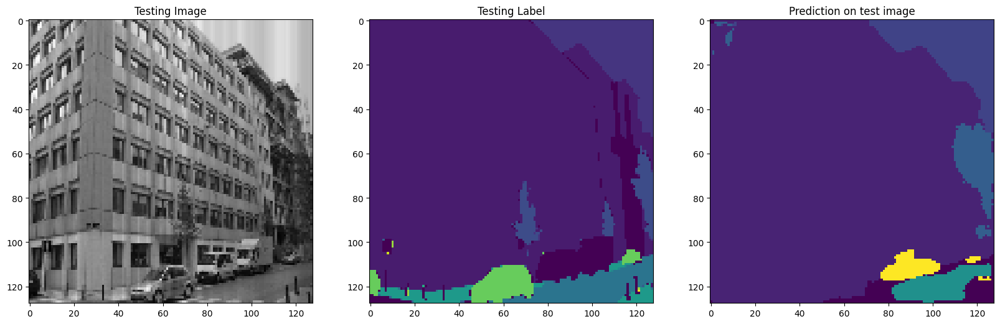

1/1 [==============================] - 0s 34ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 10 12]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 12]


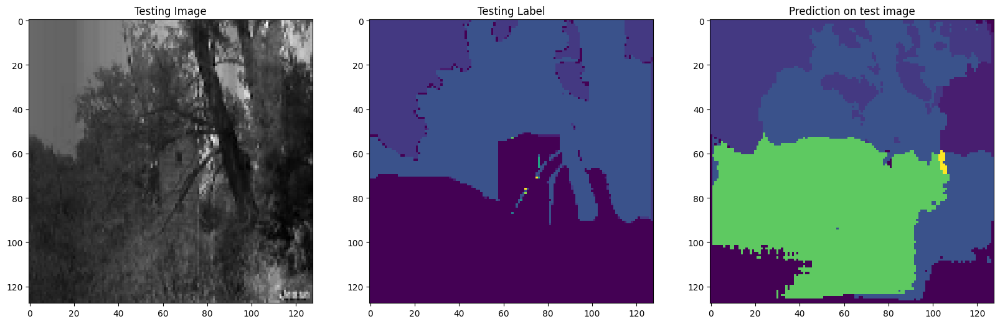

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 13]
Unique Classes in predicted taesting image  [0 2 3 4]


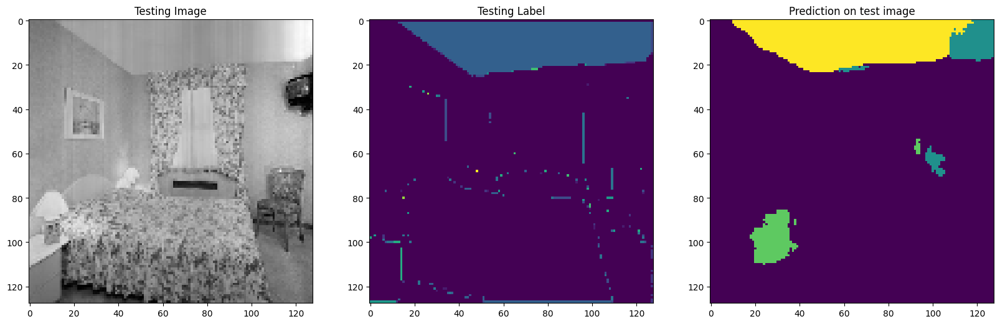

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  5  8  9 11 13]
Unique Classes in predicted taesting image  [ 0  2  3  9 11 13]


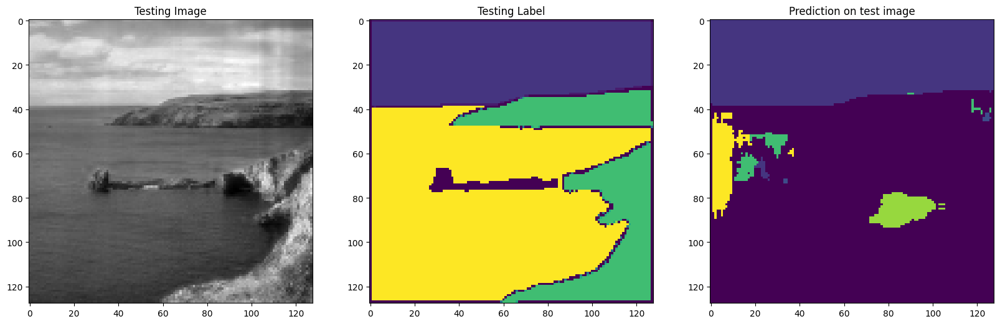

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  5  6  8 13]
Unique Classes in predicted taesting image  [0 2 3 4 9]


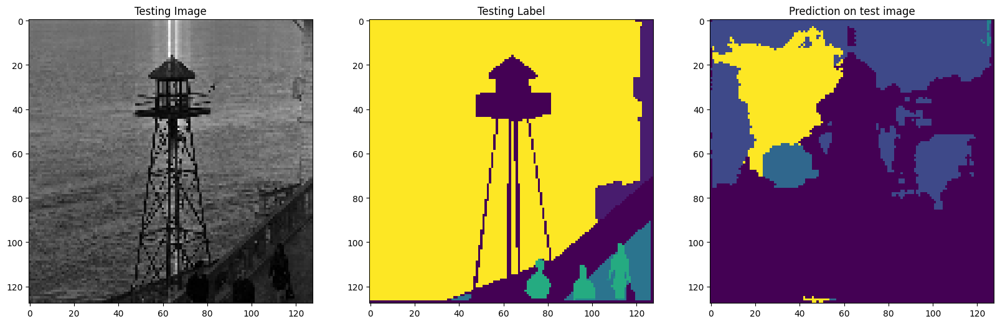

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8]
Unique Classes in predicted taesting image  [0 1 2 4 9]


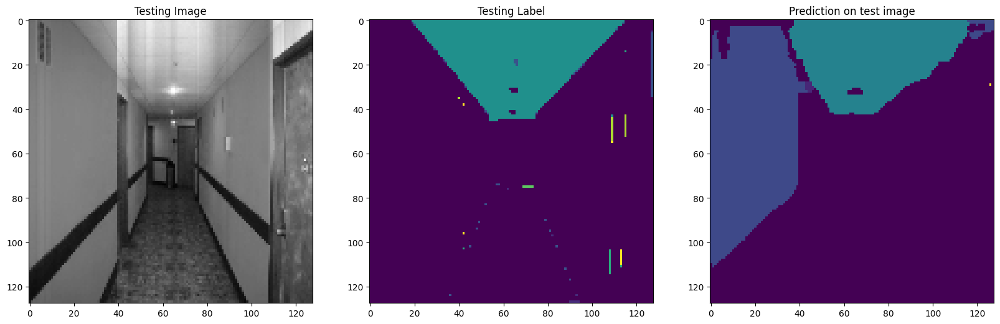

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2]
Unique Classes in predicted taesting image  [ 0  1  2  3  8 12]


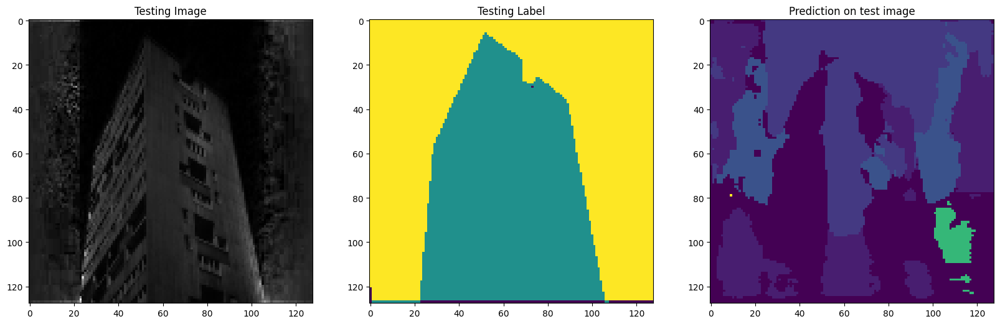

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 8 9]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 12]


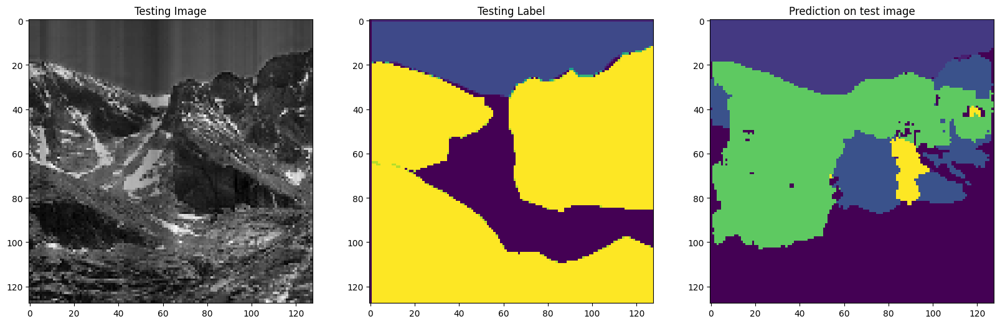

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 10]
Unique Classes in predicted taesting image  [0 4]


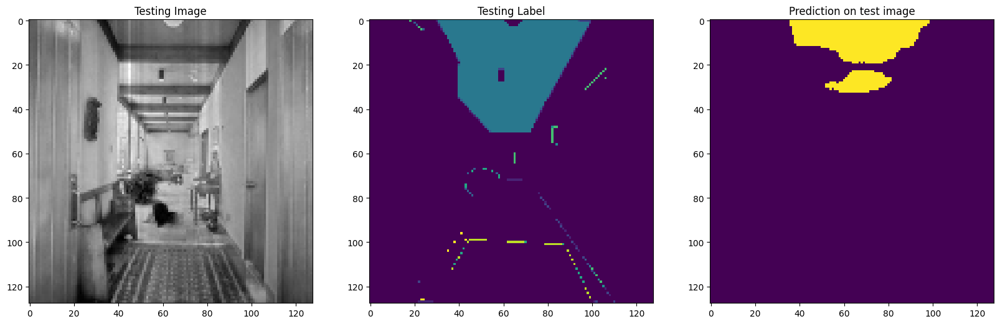

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10]


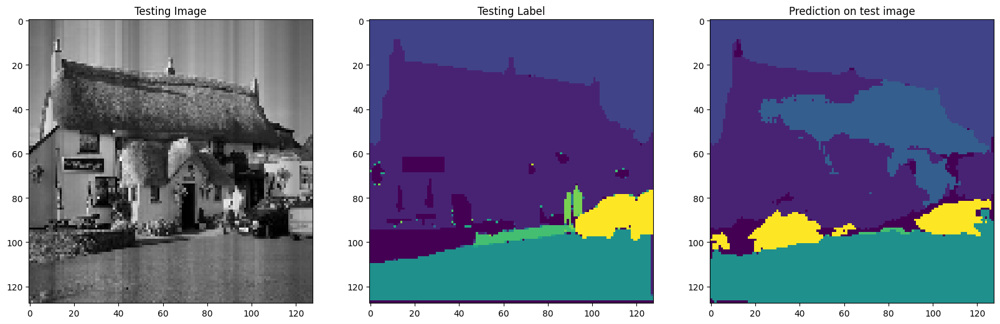

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8]
Unique Classes in predicted taesting image  [0 4]


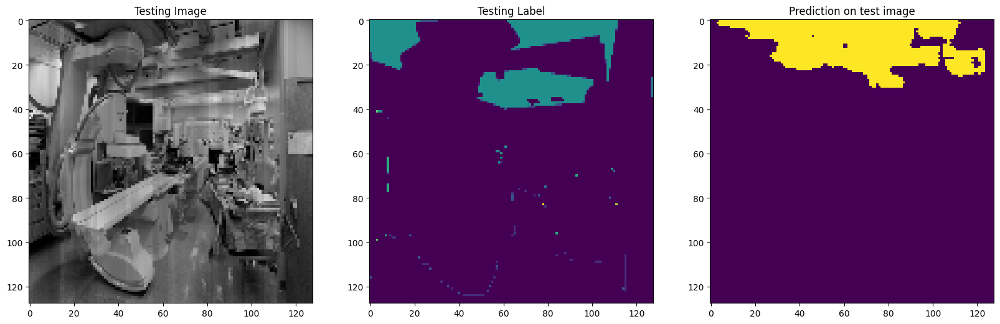

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  5  7  9 10 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  9 10 11 12 13]


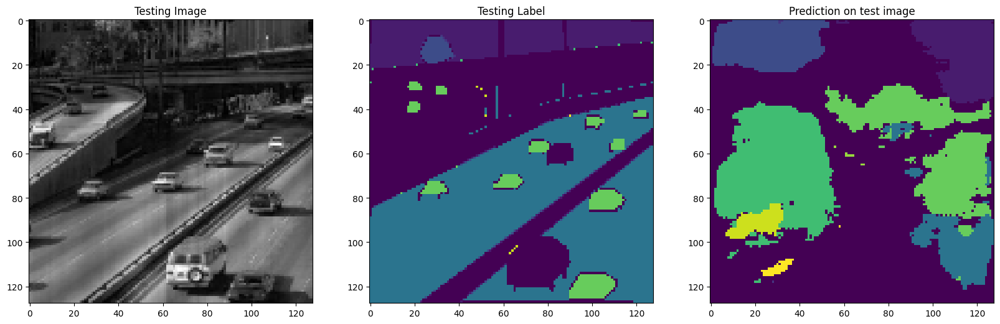

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  7  8 12]


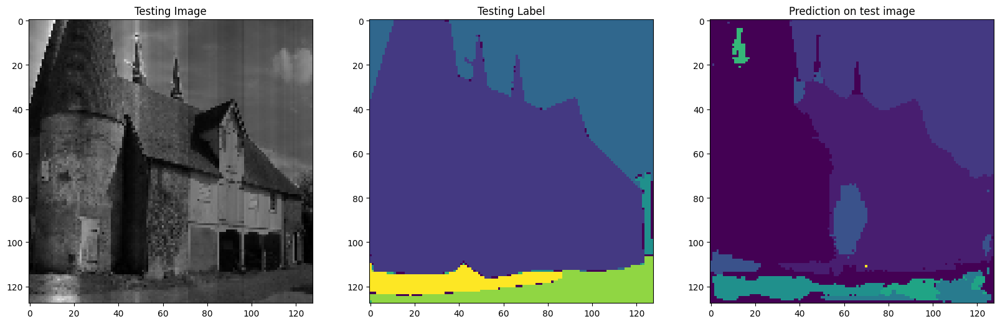

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6 13]
Unique Classes in predicted taesting image  [0 1 2 3 5 6 7]


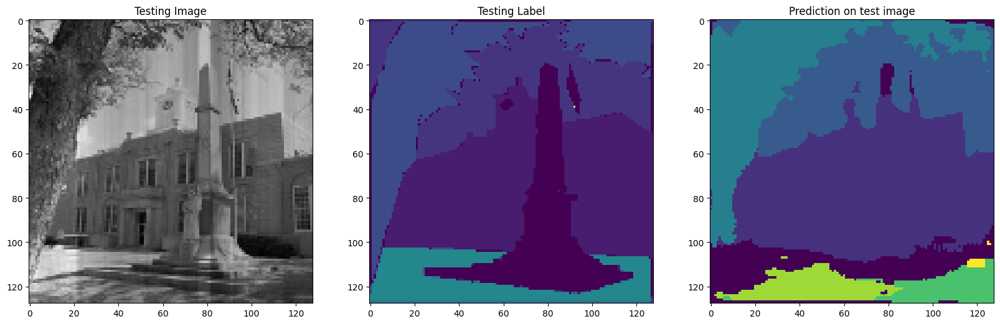

1/1 [==============================] - 0s 19ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12 13]
Unique Classes in predicted taesting image  [0 1 2 7 8]


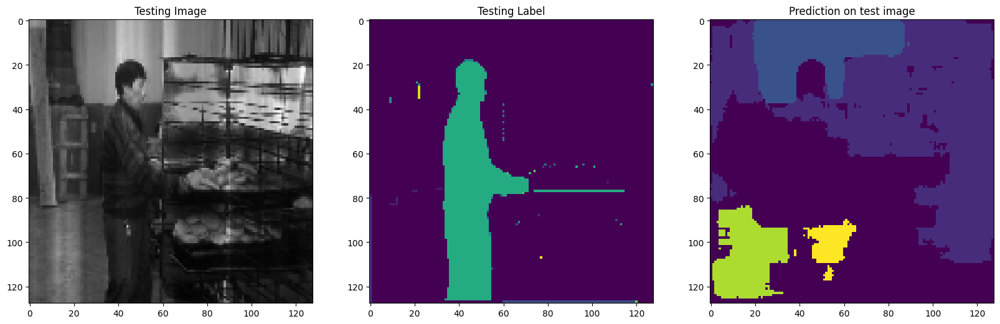

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 13]
Unique Classes in predicted taesting image  [ 0  1  2  4  5  6 11]


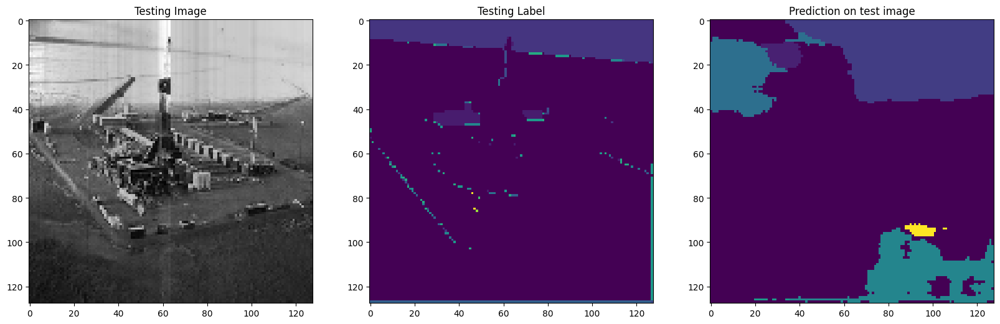

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


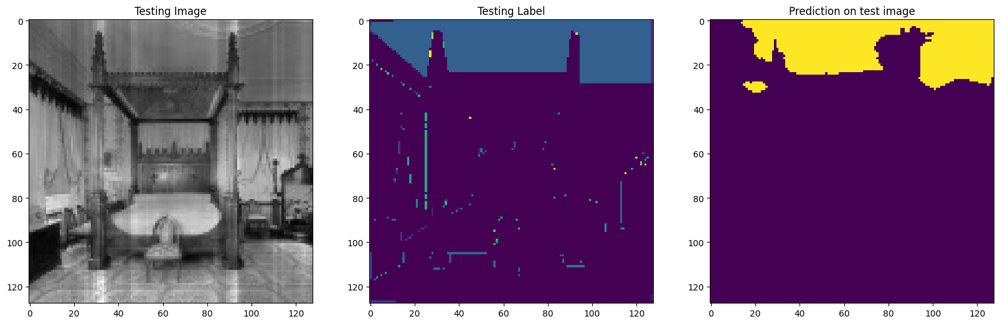

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


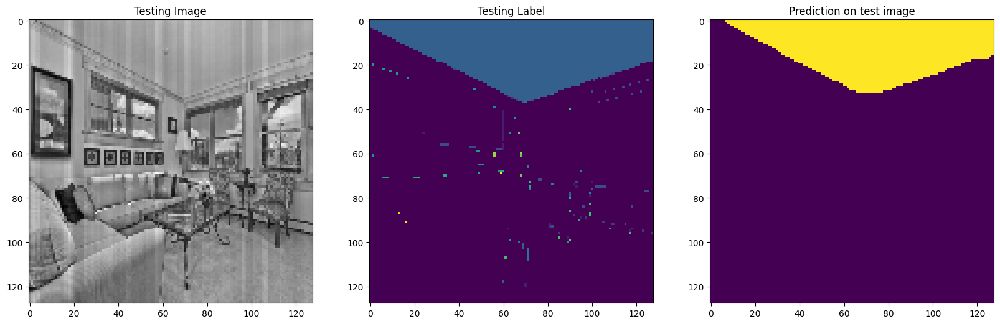

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  6  9 11]


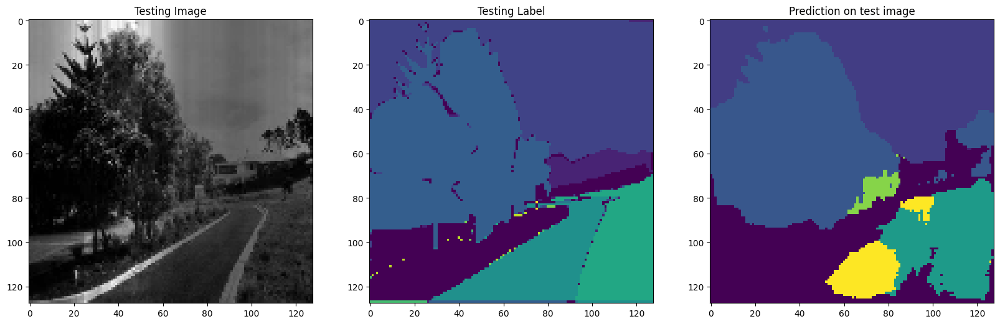

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7 10 11]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  9 10]


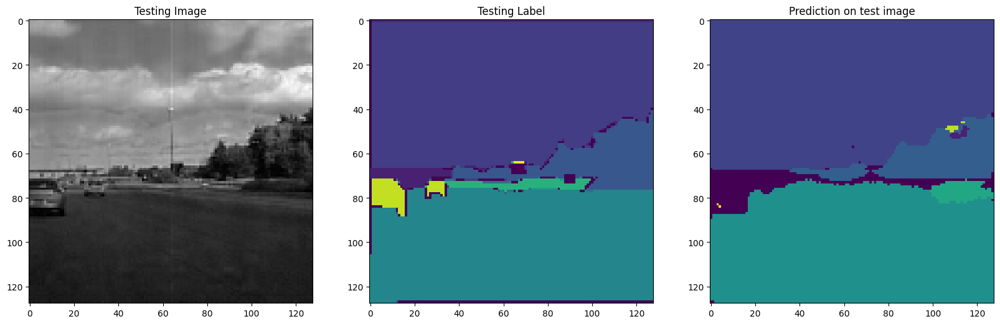

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6 11 12]


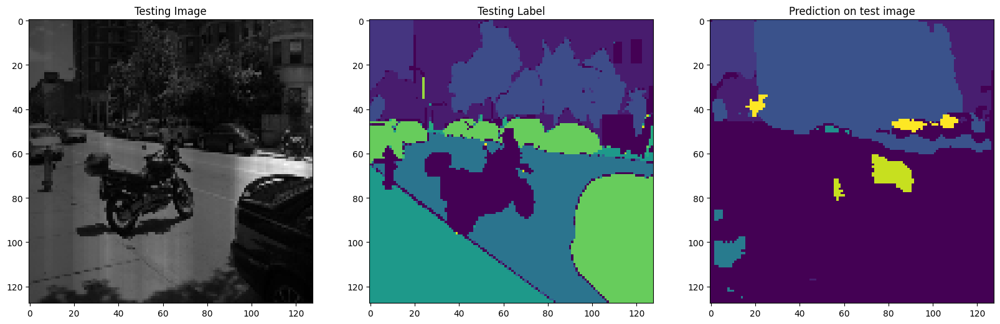

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 12]


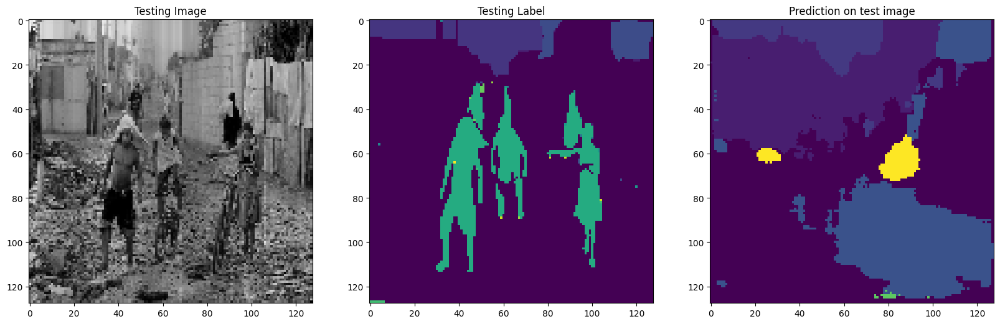

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [0 4]


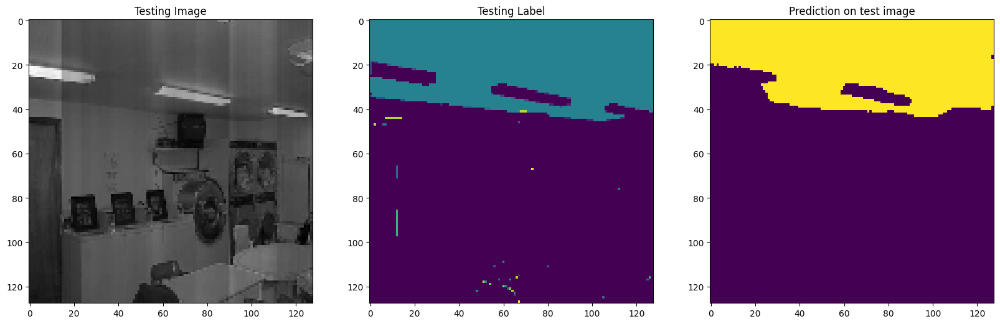

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 1 3 4 8 9]


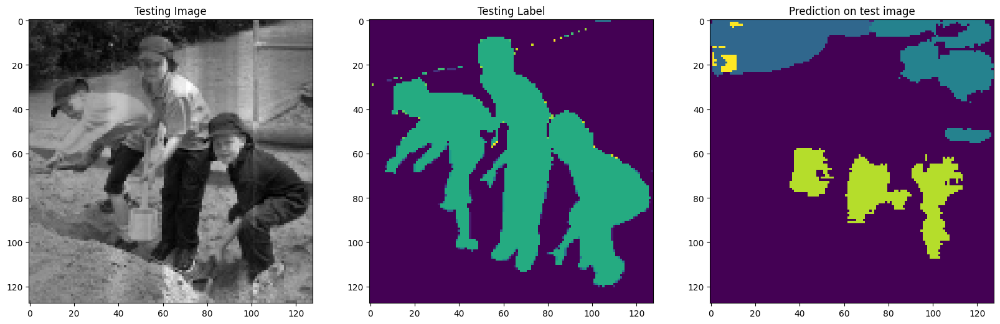

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [0 1 2 3]


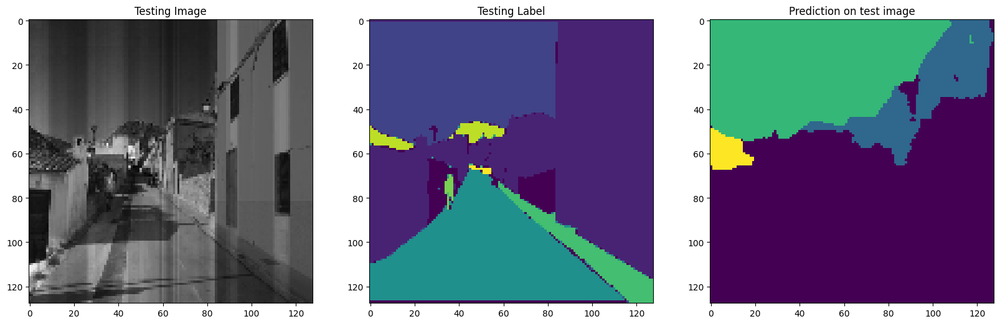

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10]


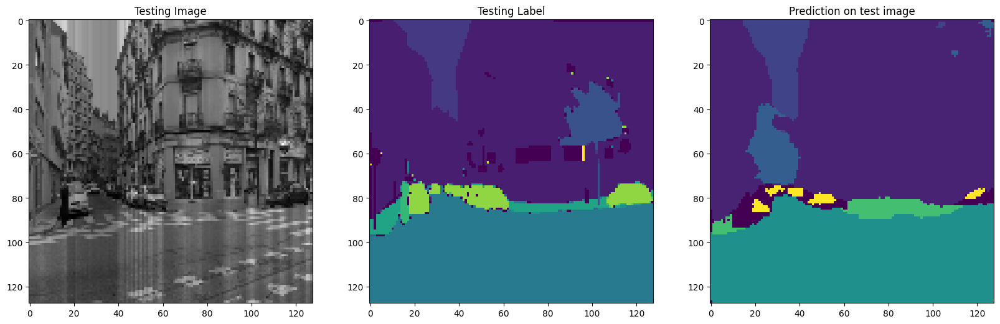

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 10 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  6 11]


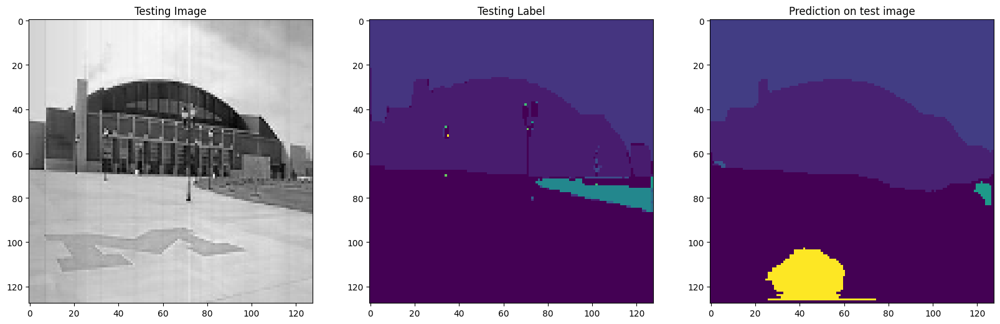

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  2  3  5  6  9 11 12]


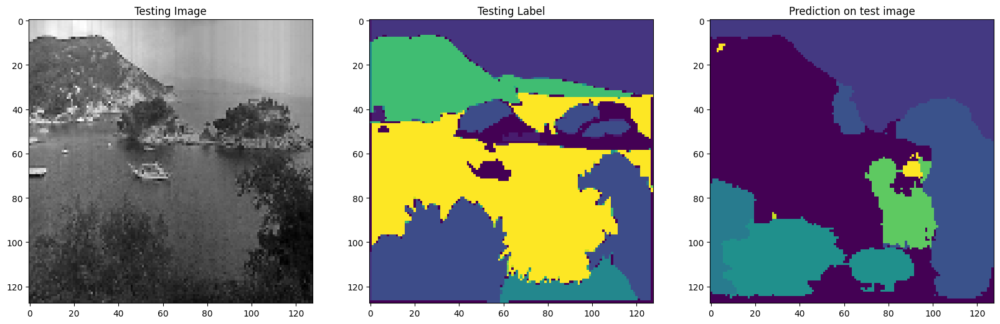

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  8  9 10 11 12]


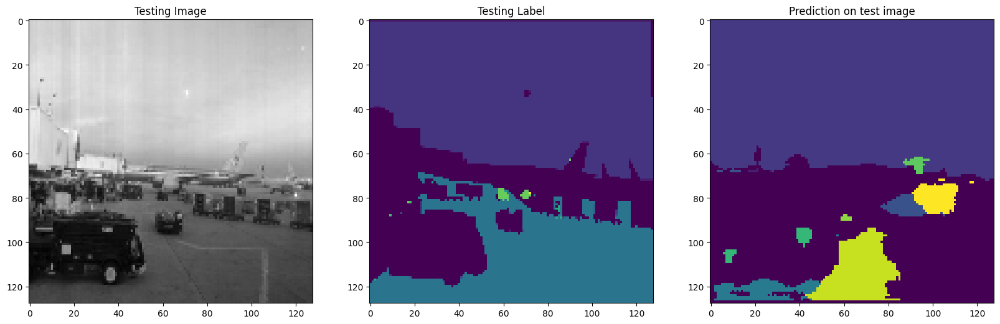

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 10 11 12]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  9 10]


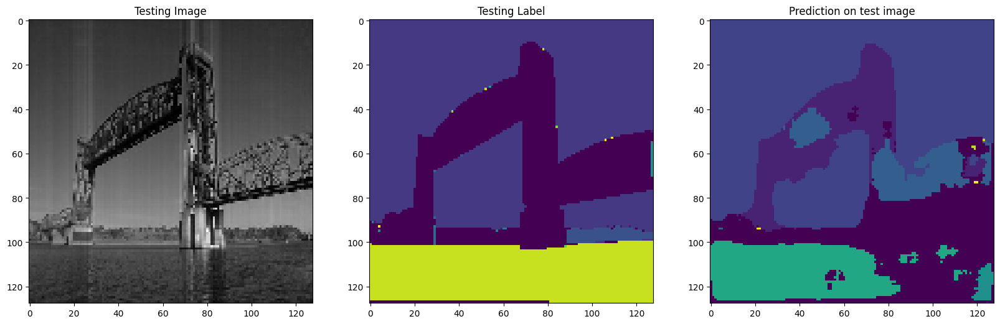

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  7  9 10 12 13]
Unique Classes in predicted taesting image  [0 2 4]


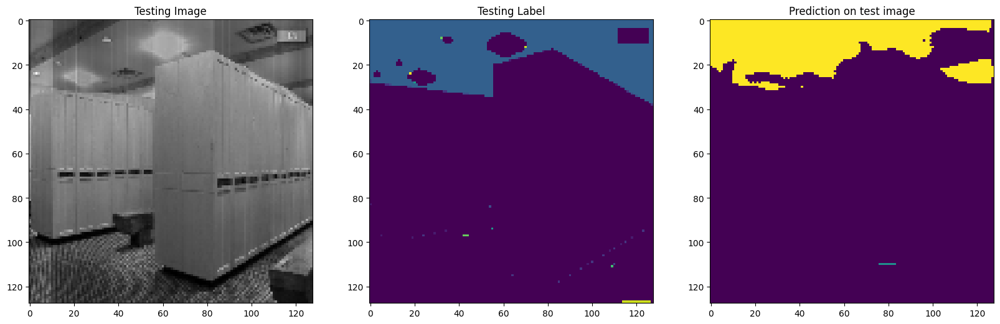

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 1 2 4 5 8]


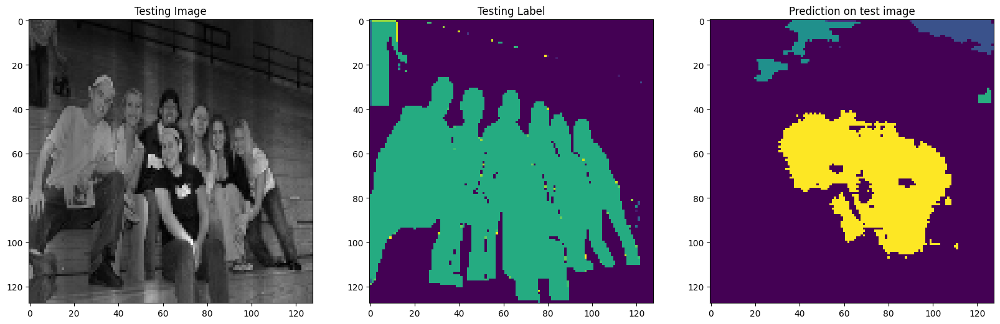

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  8  9 11 13]
Unique Classes in predicted taesting image  [ 0  2  3  9 11]


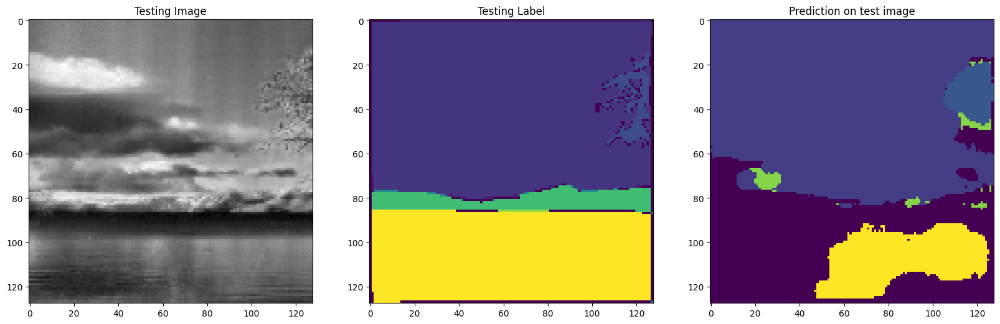

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  5  6  7  8  9 11]
Unique Classes in predicted taesting image  [ 0  2  3  9 11]


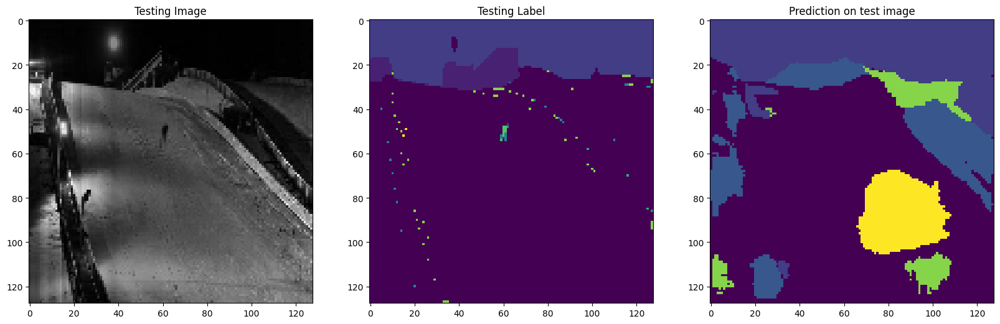

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 2 3 4 6]
Unique Classes in predicted taesting image  [ 0  1  3  9 12]


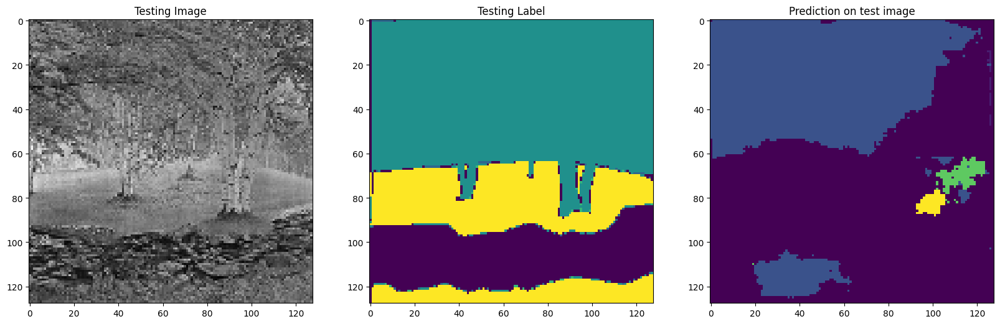

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12 13]
Unique Classes in predicted taesting image  [0 4]


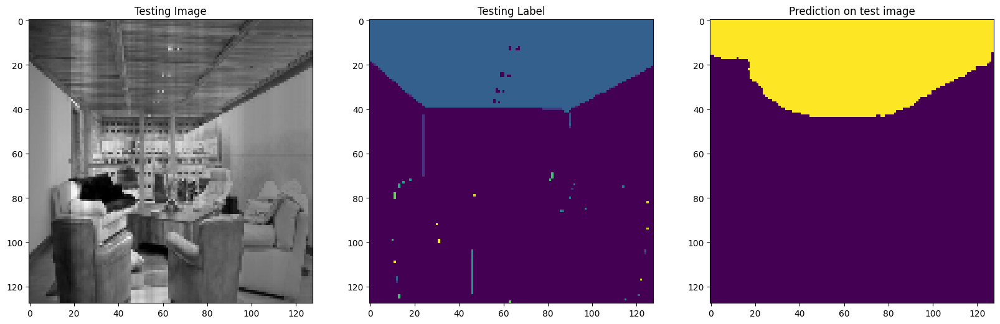

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [0 1 2 3 9]


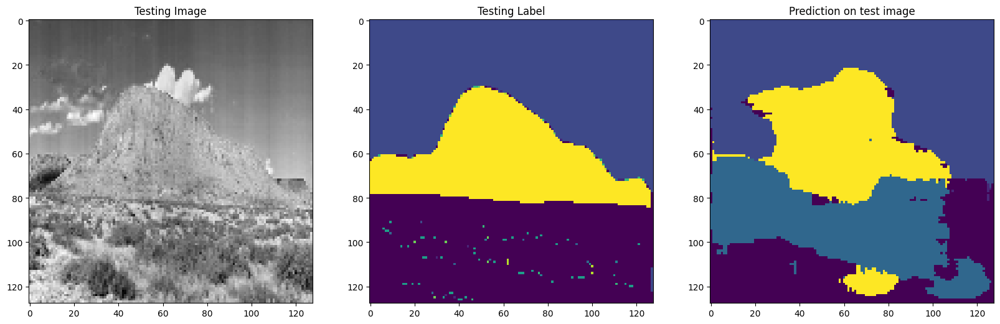

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10]


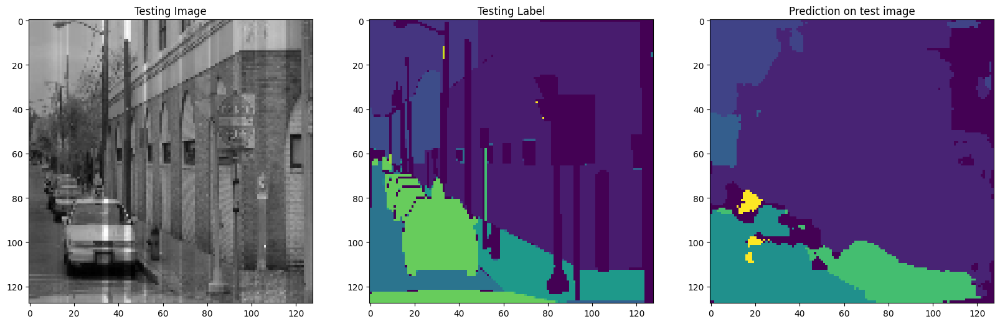

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  6 12]


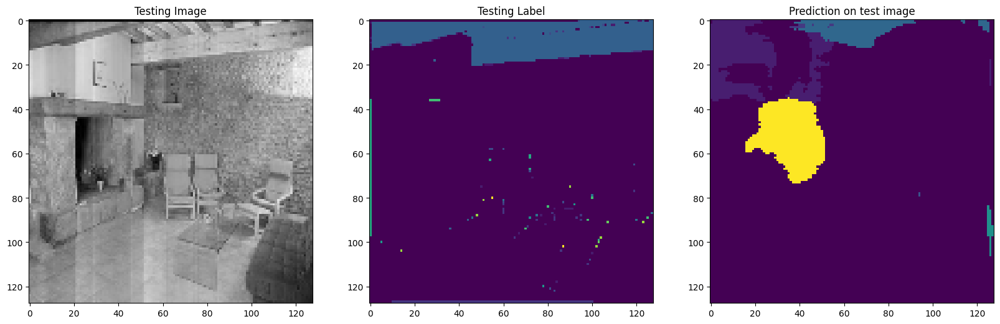

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 6]
Unique Classes in predicted taesting image  [0 1 2 4 5 6 7]


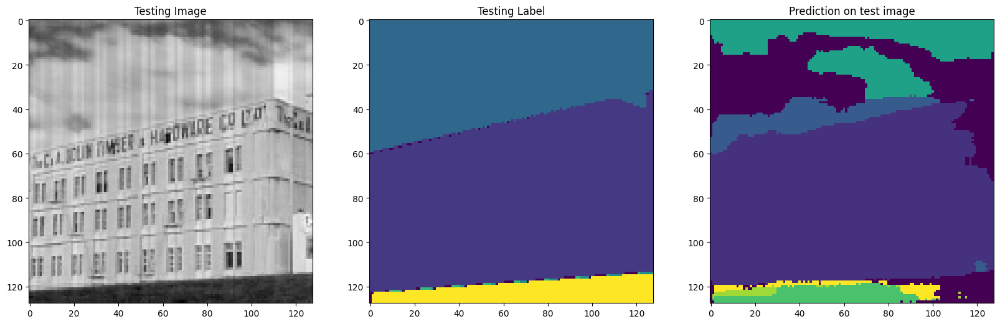

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


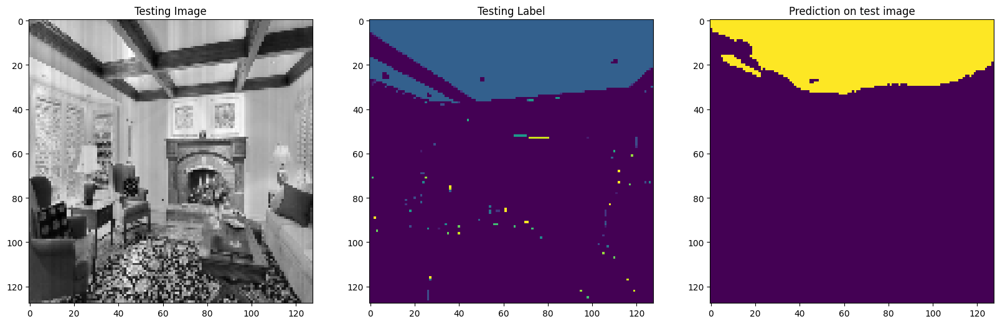

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10 11]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  7  9 11 12]


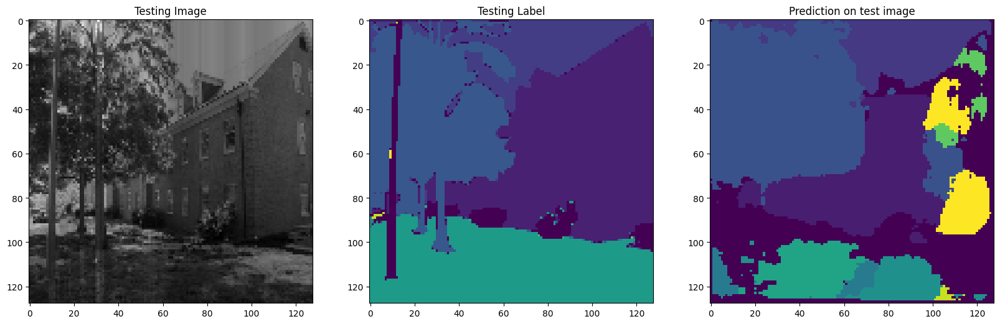

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 13]
Unique Classes in predicted taesting image  [0 1 2 3 4 8]


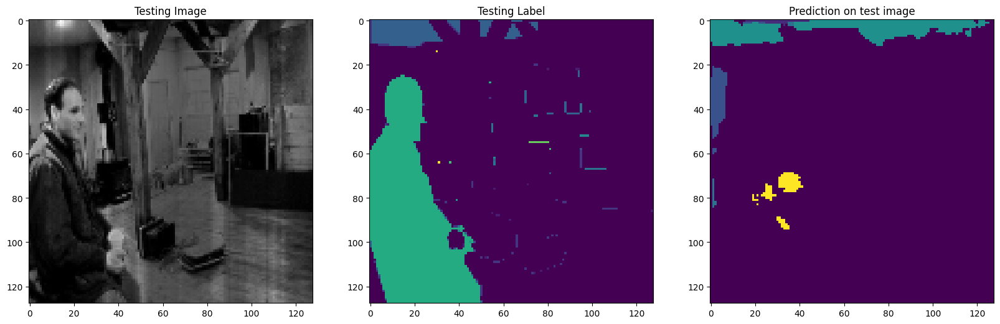

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 13]
Unique Classes in predicted taesting image  [ 0  2  3  4 11 12 13]


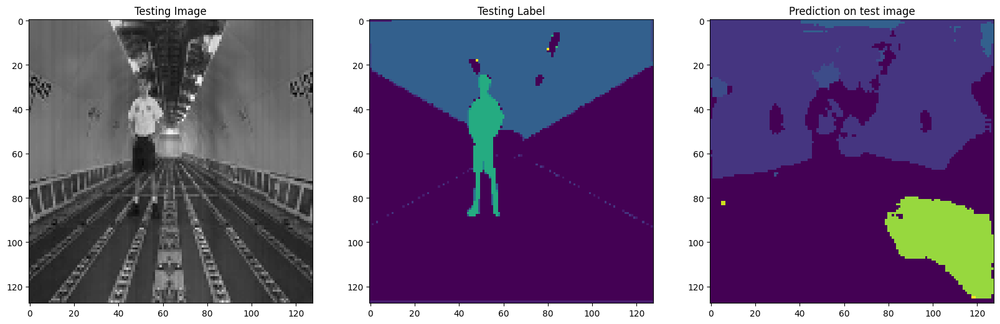

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 13]
Unique Classes in predicted taesting image  [0 1 3 8]


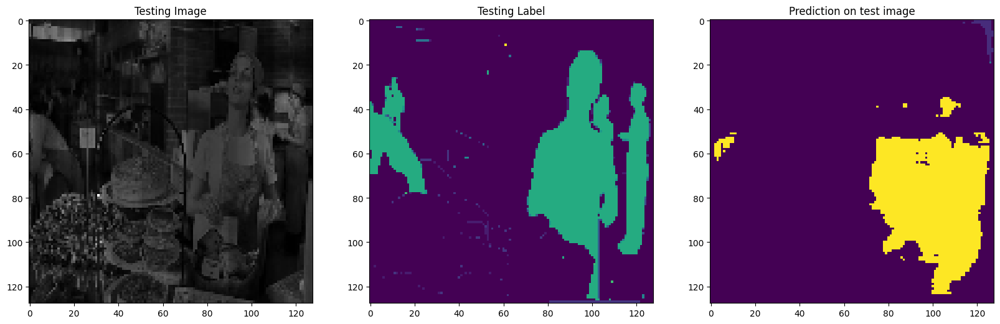

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 6 7 8 9]
Unique Classes in predicted taesting image  [0 4 5 7]


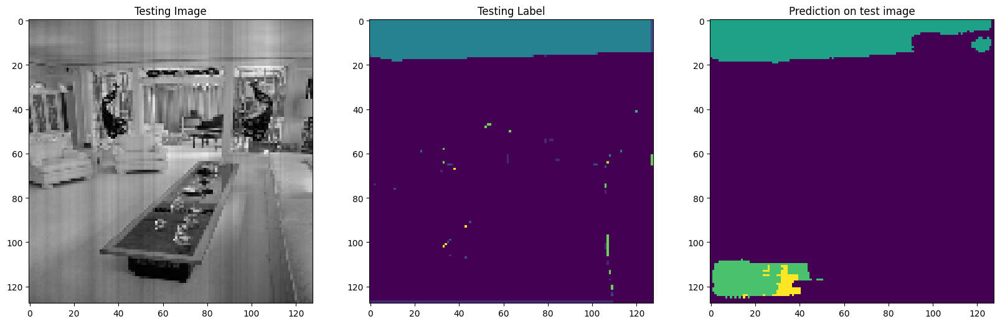

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  6  8  9 10 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 11 13]


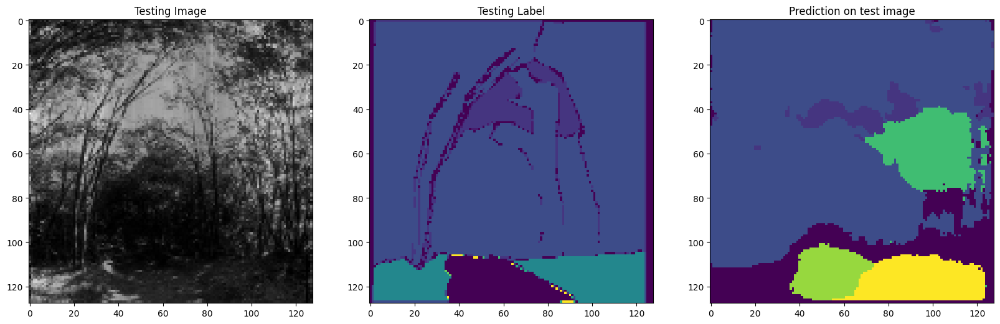

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12]
Unique Classes in predicted taesting image  [ 0  1  3  4  5  6 10 11]


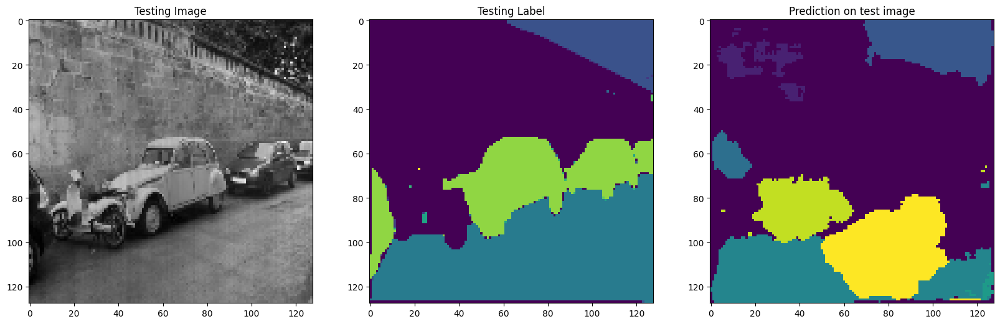

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 2 4 8]


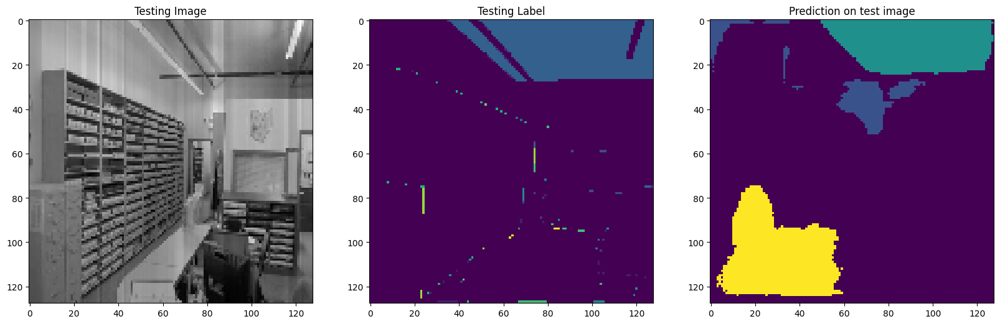

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10]


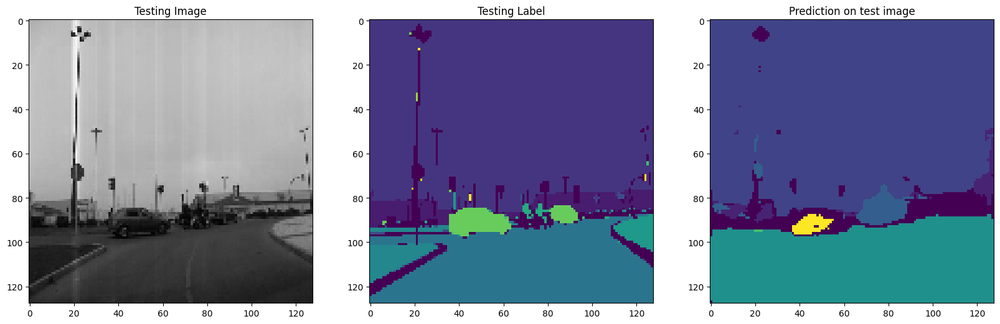

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  5  6  8  9 10 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  6  9 11 12]


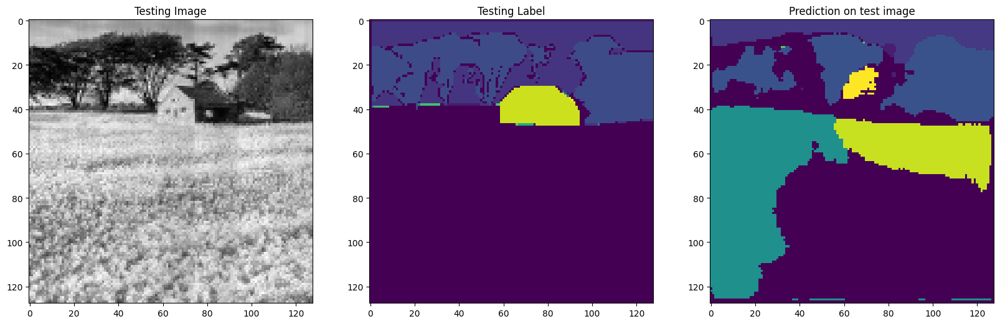

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  7  8 11]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7  8 12]


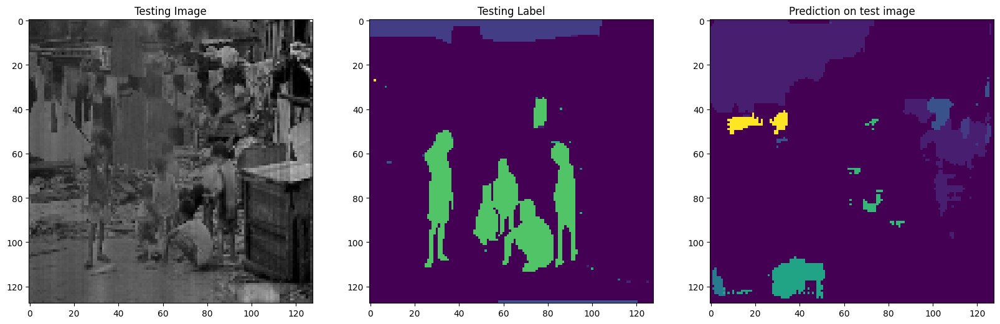

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  1  2  3  5 10 12]


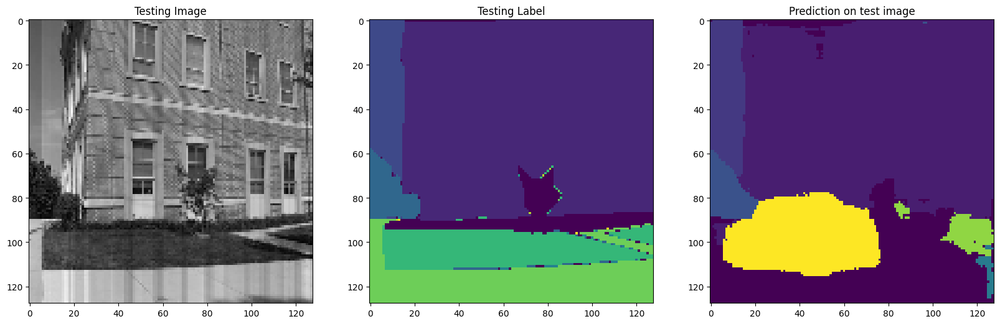

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10]


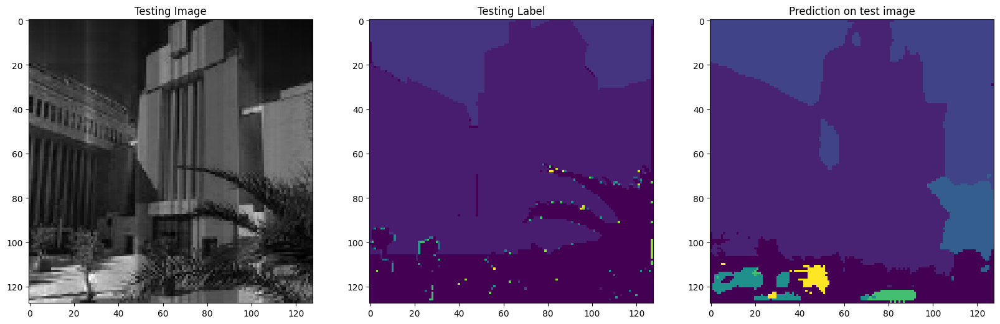

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 12]


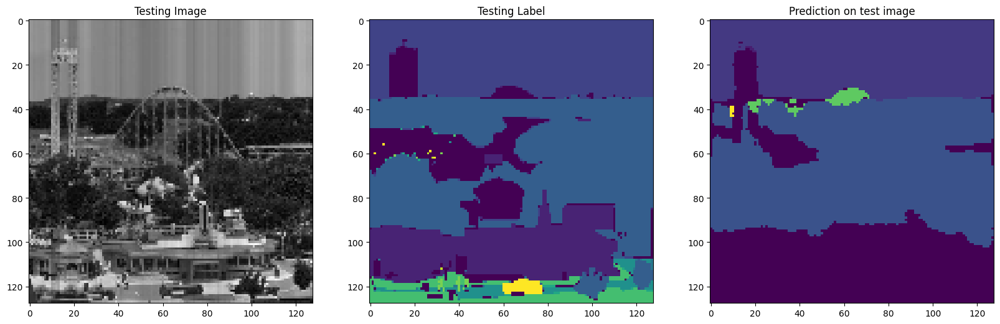

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10 12]


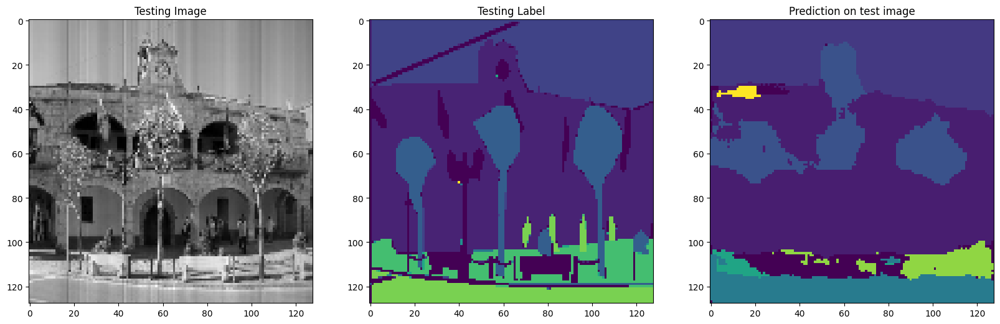

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11]
Unique Classes in predicted taesting image  [ 0  1  2  3  6  9 12]


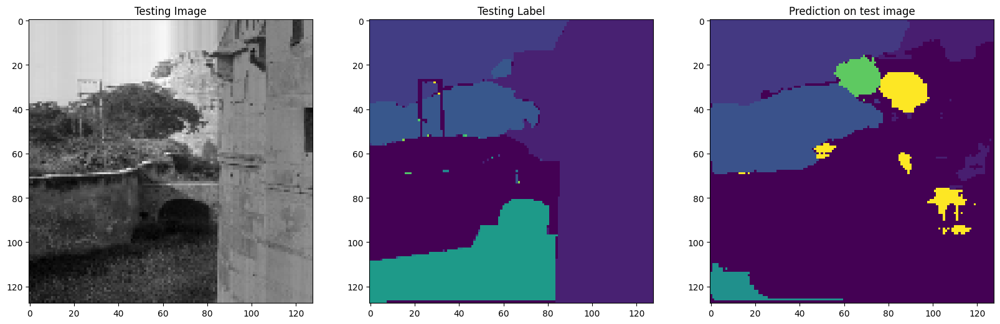

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8]
Unique Classes in predicted taesting image  [ 0  2  3  9 12]


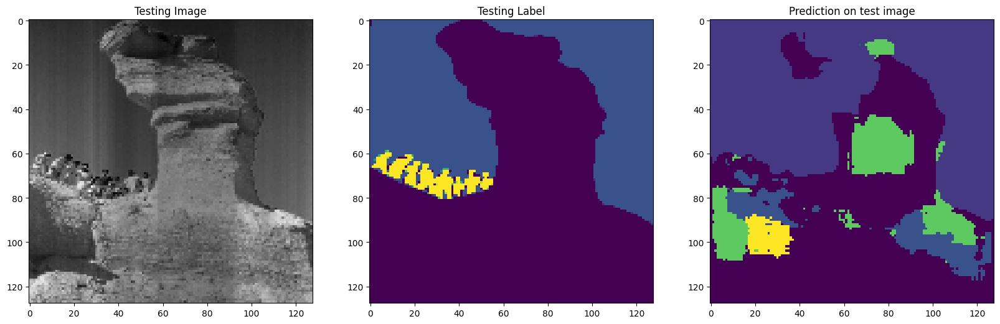

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  4  6  7  8 12]
Unique Classes in predicted taesting image  [0 1 2 3 5 6 7]


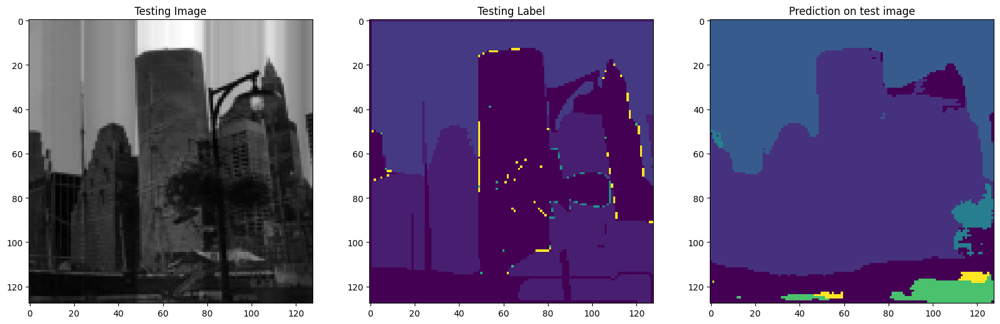

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 12 13]
Unique Classes in predicted taesting image  [0 1 4]


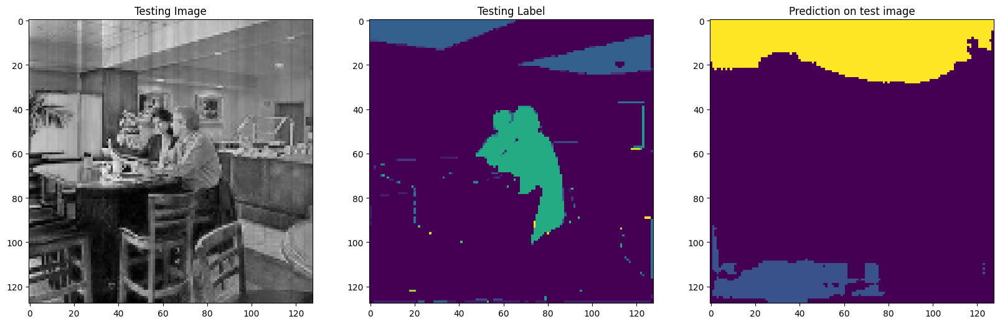

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12]
Unique Classes in predicted taesting image  [0 4]


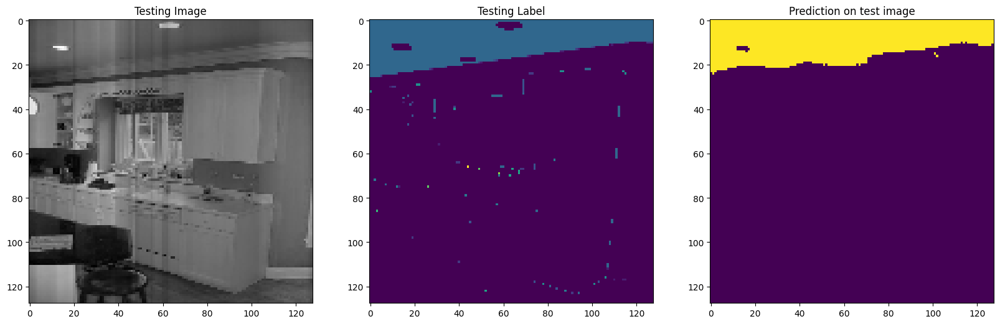

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 12]
Unique Classes in predicted taesting image  [0 2 4]


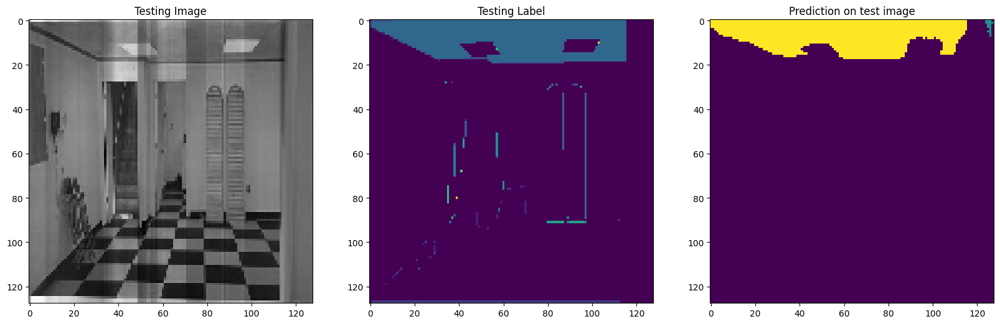

1/1 [==============================] - 0s 26ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  2  3  8 12]


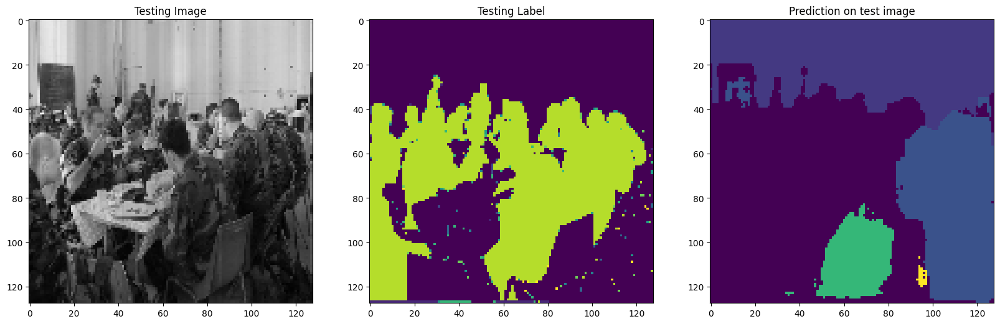

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


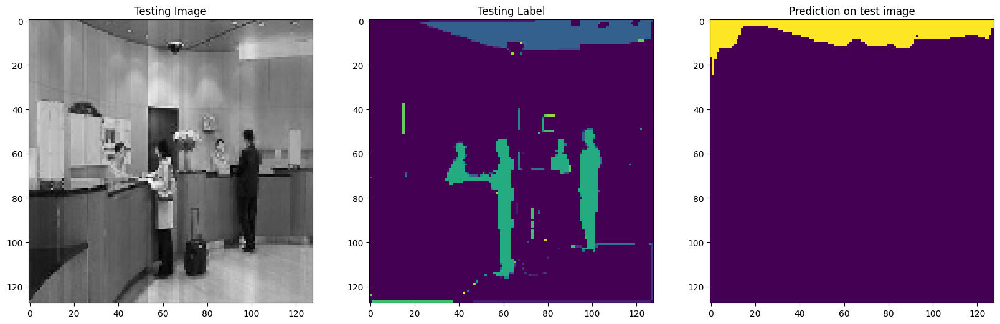

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12]
Unique Classes in predicted taesting image  [0 1 2 3 4 5 7]


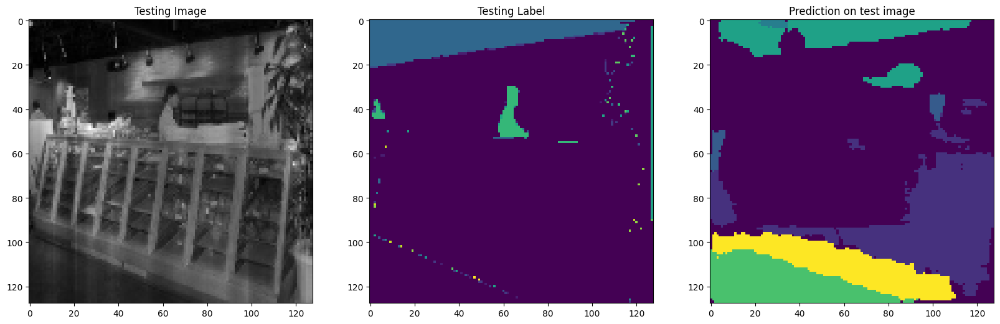

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7  8 10]


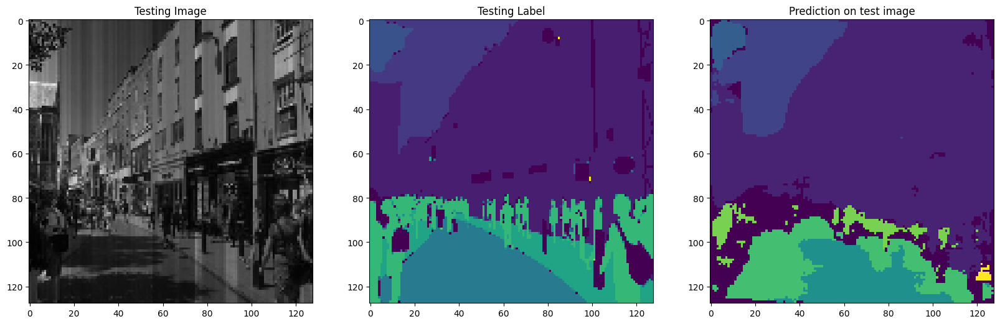

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6 13]
Unique Classes in predicted taesting image  [ 0  2  3  9 11]


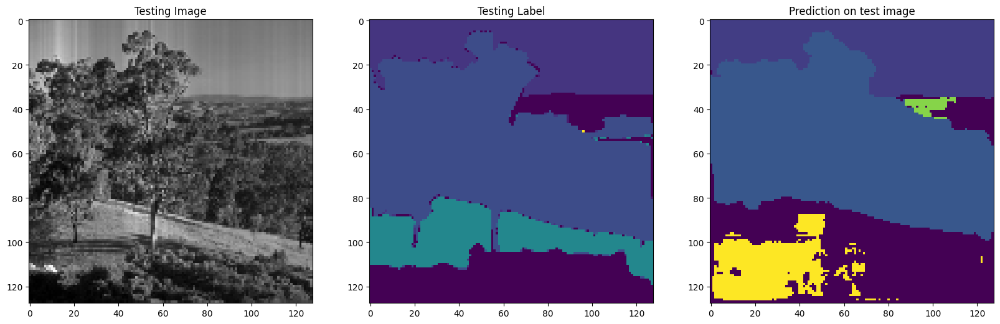

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


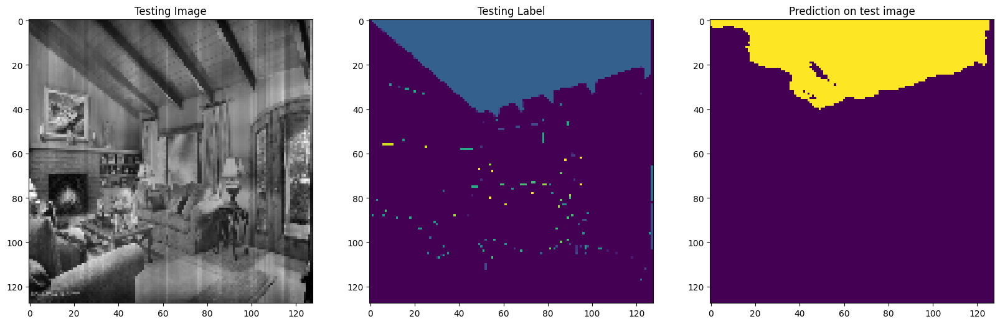

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2]
Unique Classes in predicted taesting image  [0 1 2 3]


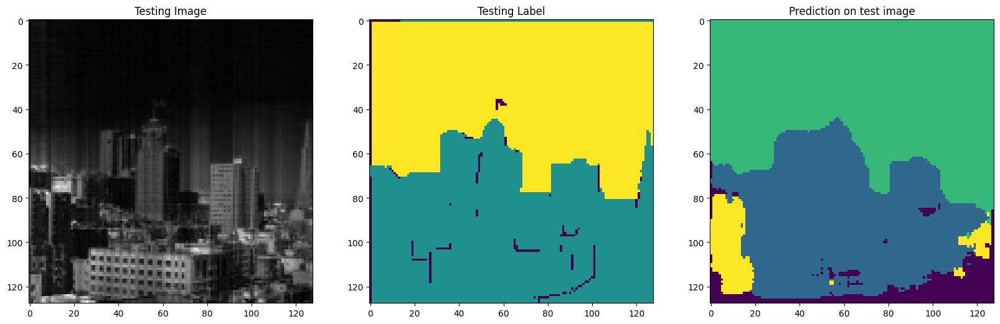

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  2  4  5  9 11 12]


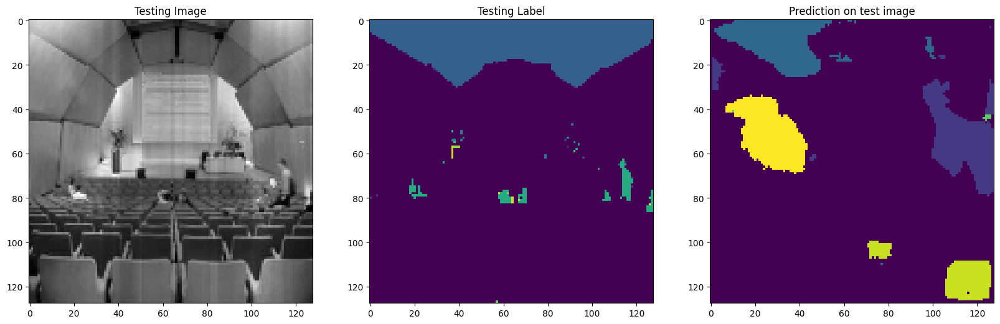

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 12 13]
Unique Classes in predicted taesting image  [0 1 2 3 9]


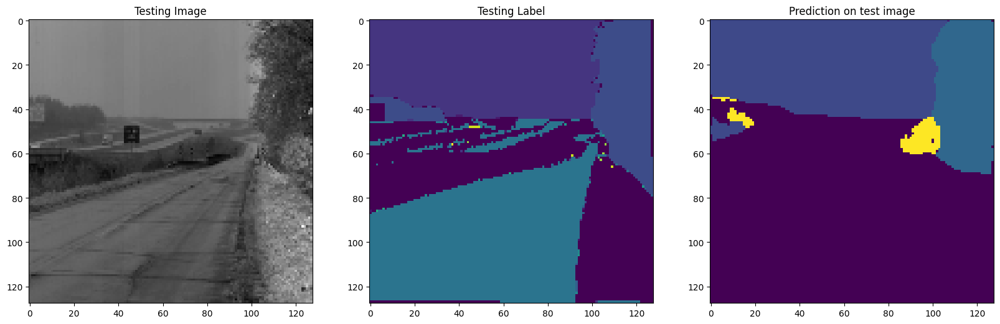

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 8 9]
Unique Classes in predicted taesting image  [ 0  2  3  9 12]


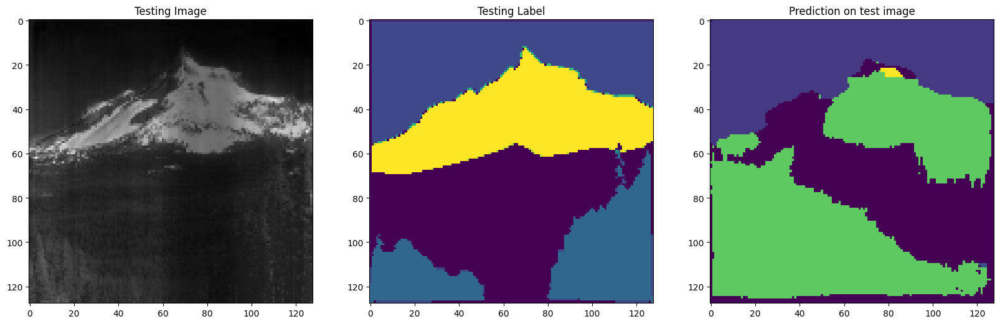

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 12]
Unique Classes in predicted taesting image  [0 1 2 3]


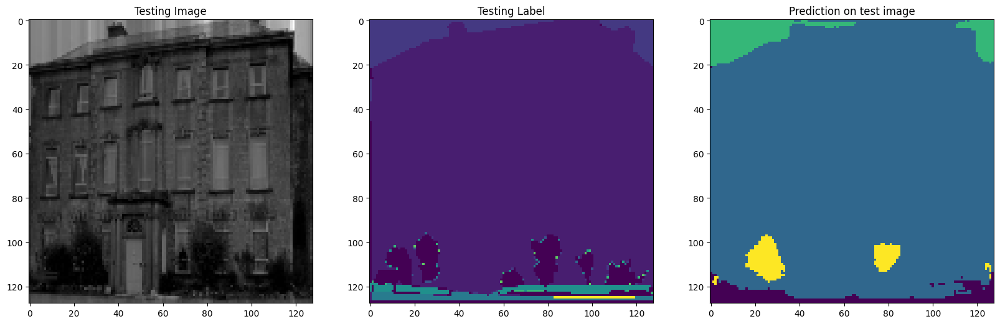

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  2 12]


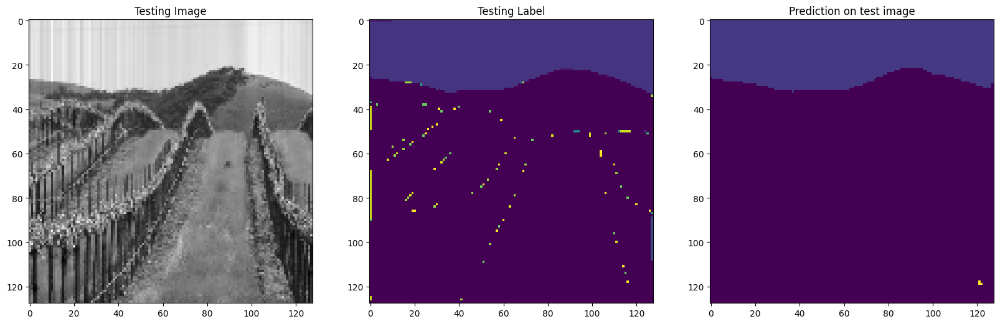

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7  9 12]


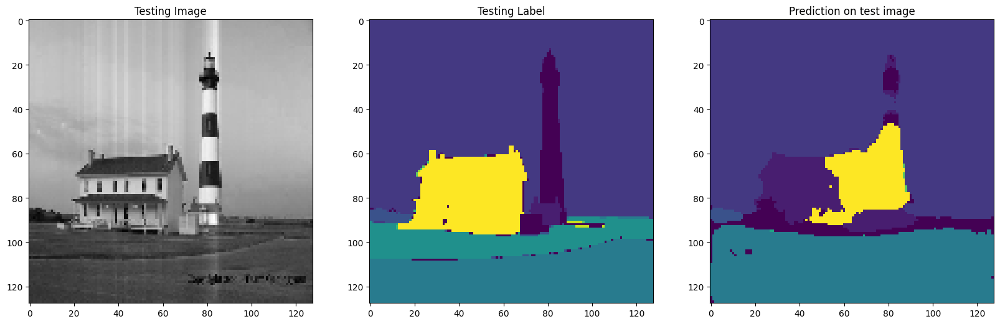

1/1 [==============================] - 0s 26ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [0 1 2 3]


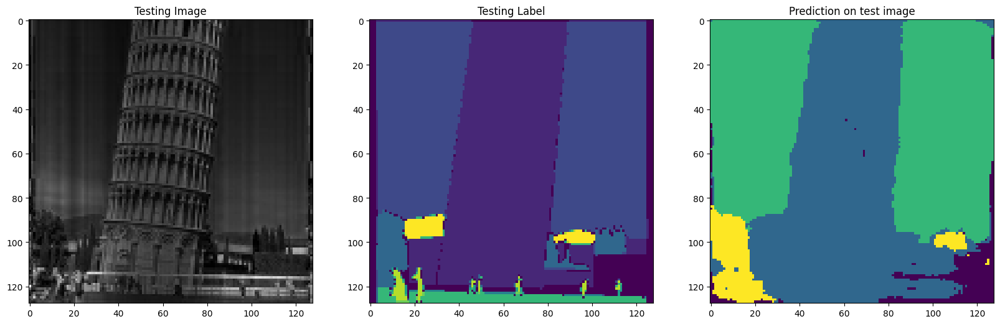

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  8  9 11 12]
Unique Classes in predicted taesting image  [0 1 2 3]


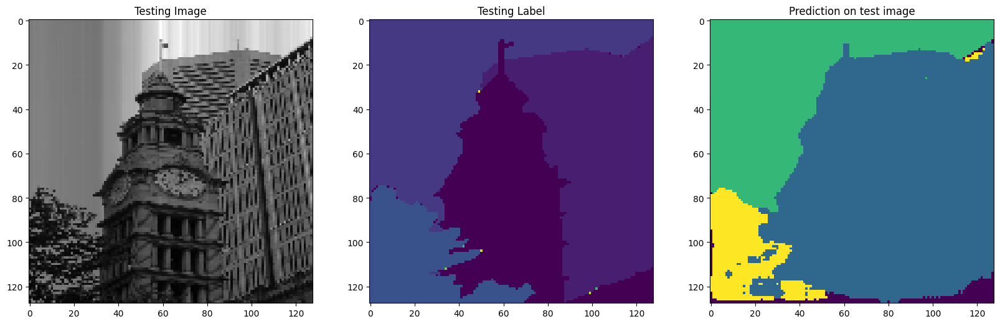

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8]
Unique Classes in predicted taesting image  [ 0  1  4  5 10 11]


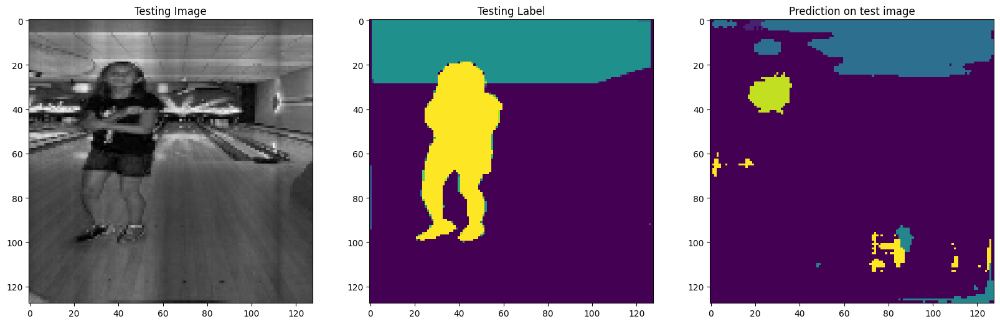

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8]
Unique Classes in predicted taesting image  [ 0  2  3  4 12]


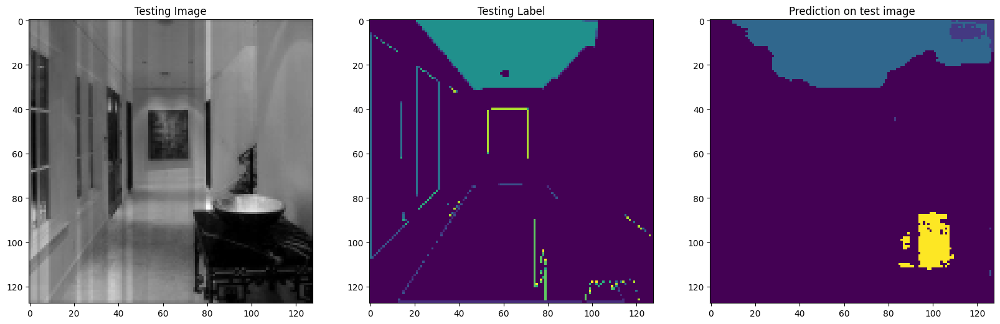

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  9 11 12]


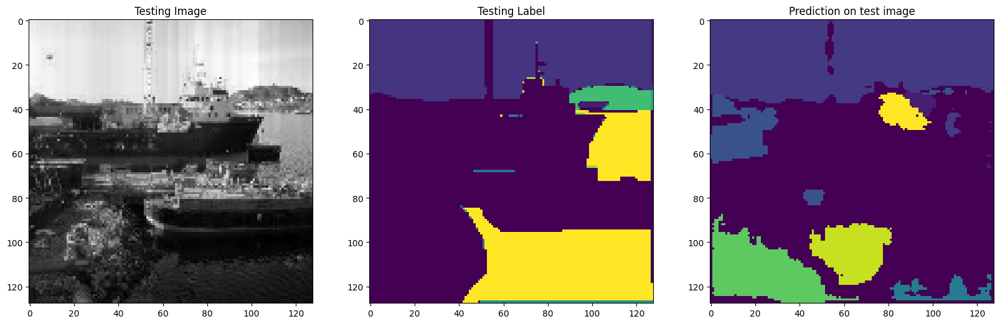

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11]
Unique Classes in predicted taesting image  [0 1 2 4]


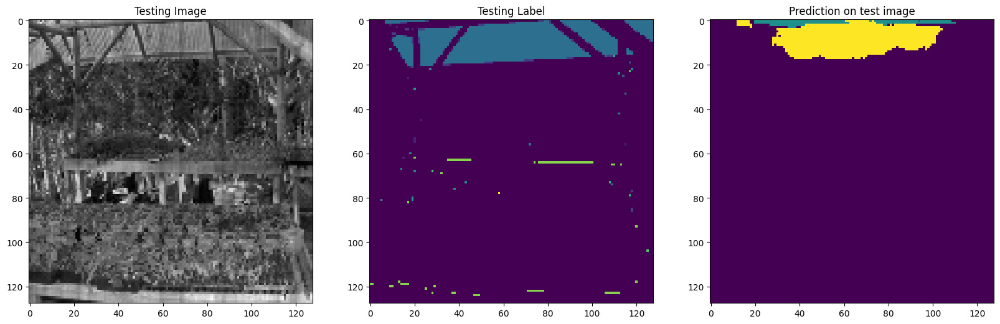

1/1 [==============================] - 0s 19ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 1 2 3]


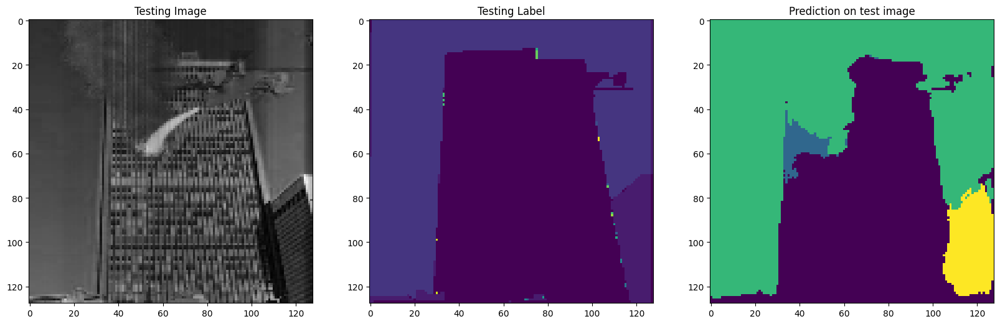

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 2 4]


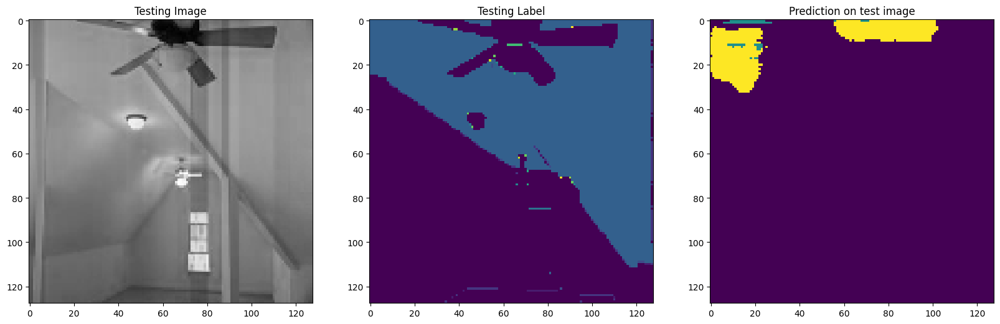

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [ 0  1  2  5  7 10]


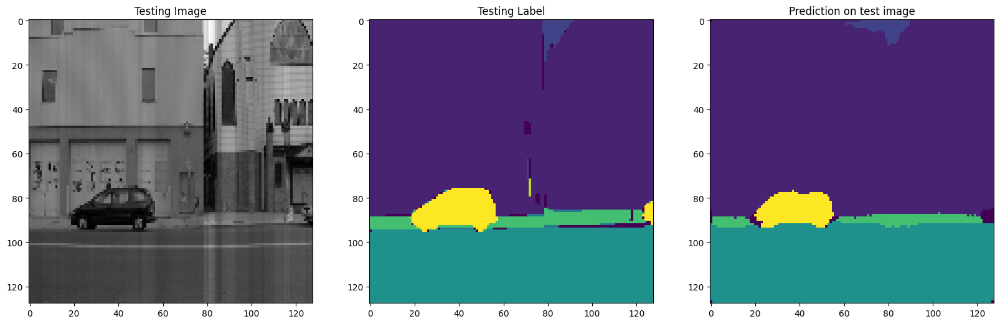

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [0 1 2 3 5]
Unique Classes in predicted taesting image  [ 0  1  2  3 12]


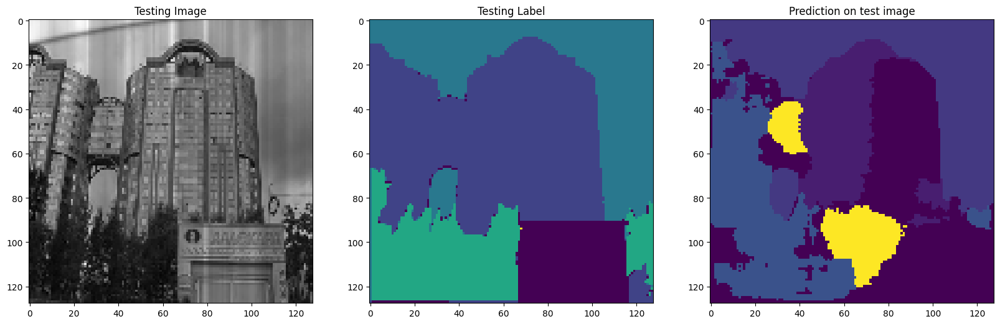

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10]


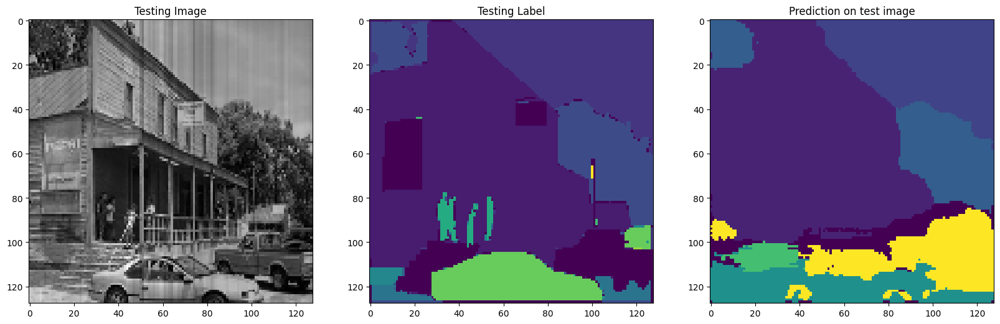

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  7 12]


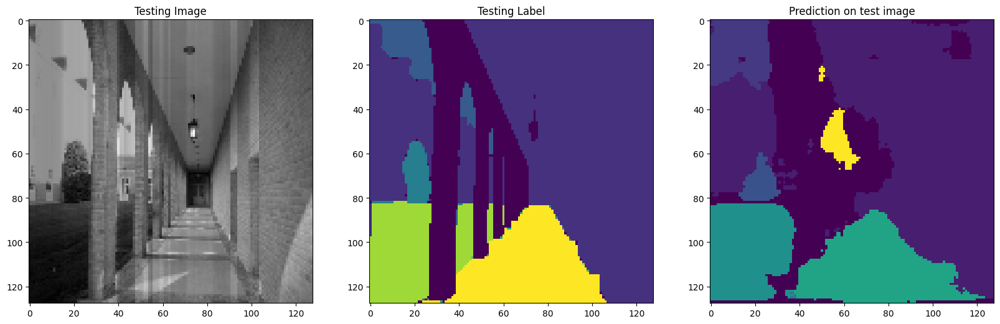

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 7 9]
Unique Classes in predicted taesting image  [0 2 3 6]


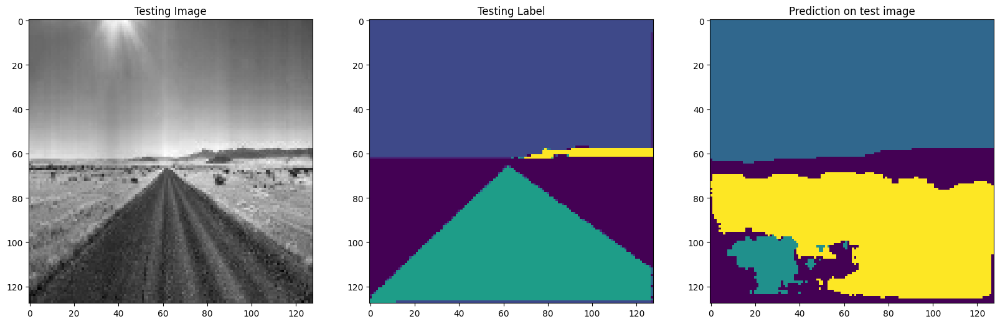

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [0 1 2]
Unique Classes in predicted taesting image  [0 1 2 3]


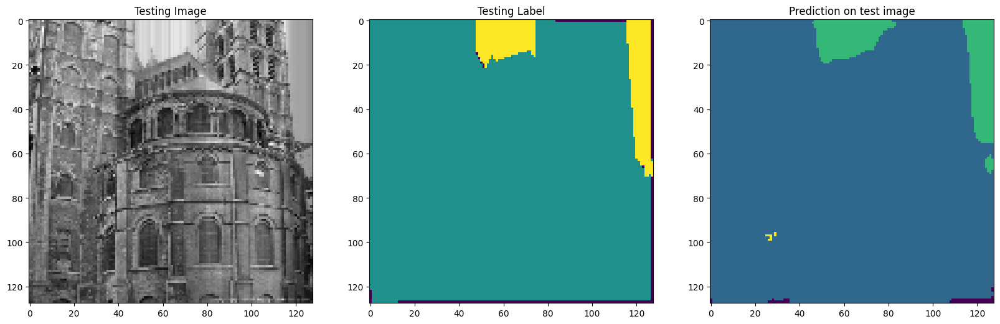

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 1 3 6 9]


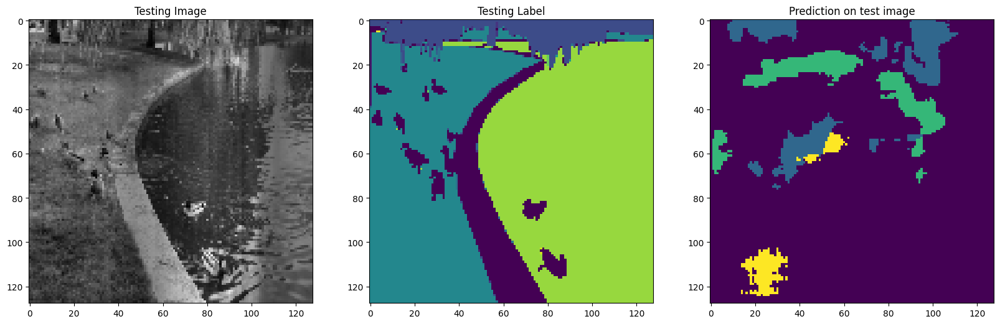

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8]
Unique Classes in predicted taesting image  [ 0  1  2  3 12]


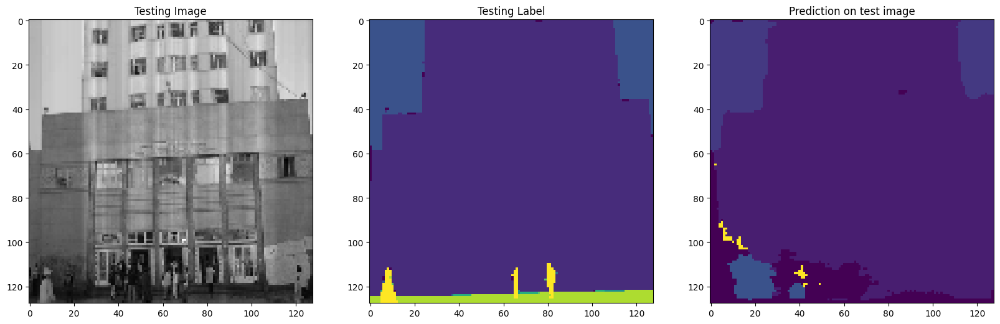

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 12]


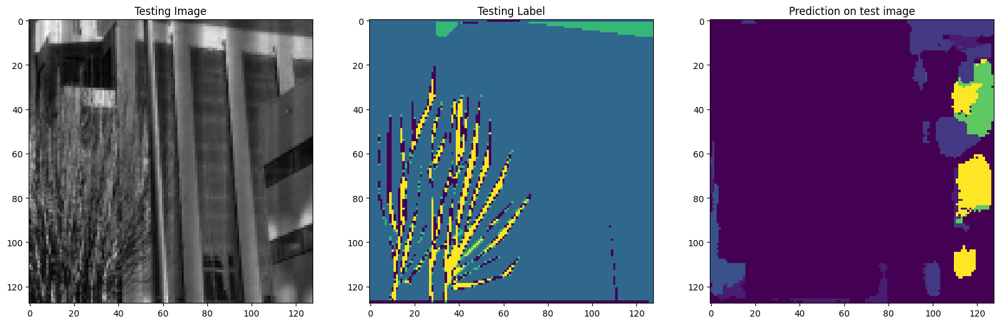

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 11 13]
Unique Classes in predicted taesting image  [0 1 2 3 6]


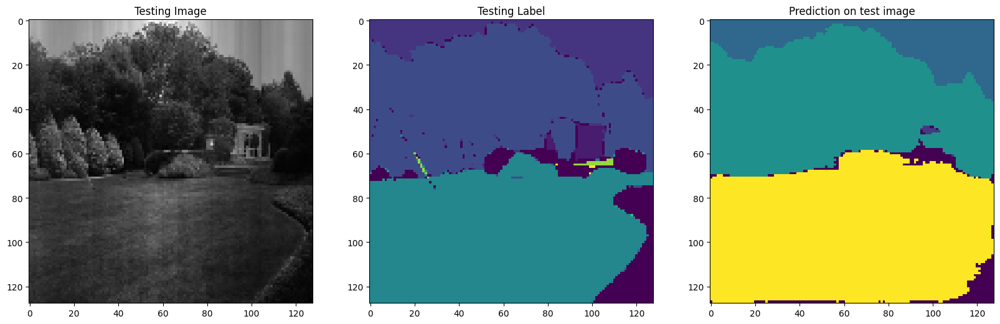

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 13]
Unique Classes in predicted taesting image  [0 1 2 3 5 6 7]


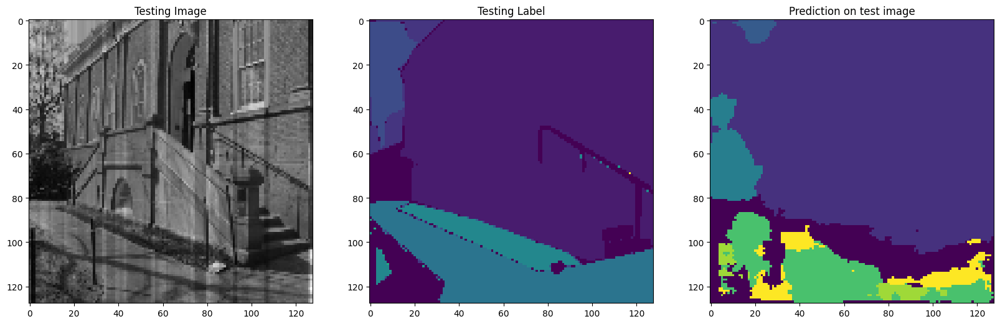

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  9 12]
Unique Classes in predicted taesting image  [ 0  1  2  5  7 10 12]


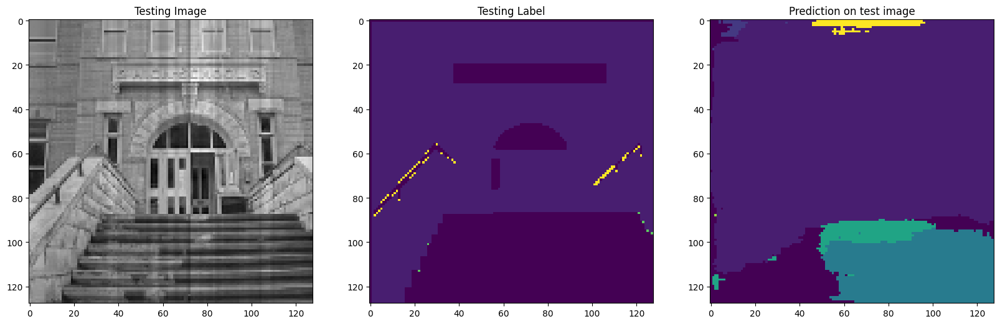

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 11 12 13]
Unique Classes in predicted taesting image  [0 1 2 3 5 7 9]


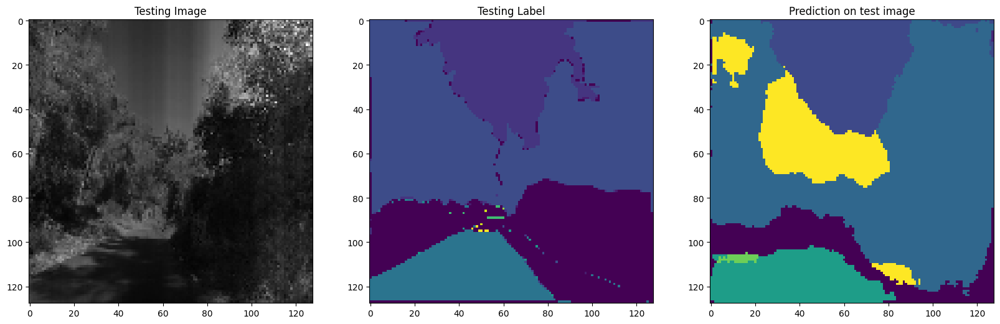

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  3  4  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 13]


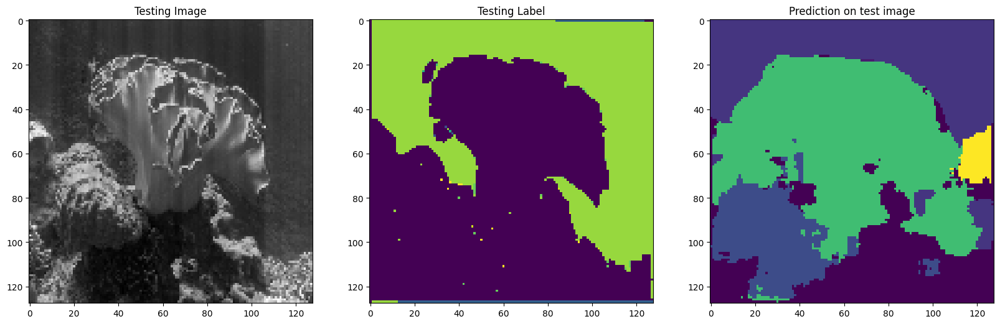

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 1 2 3 6]


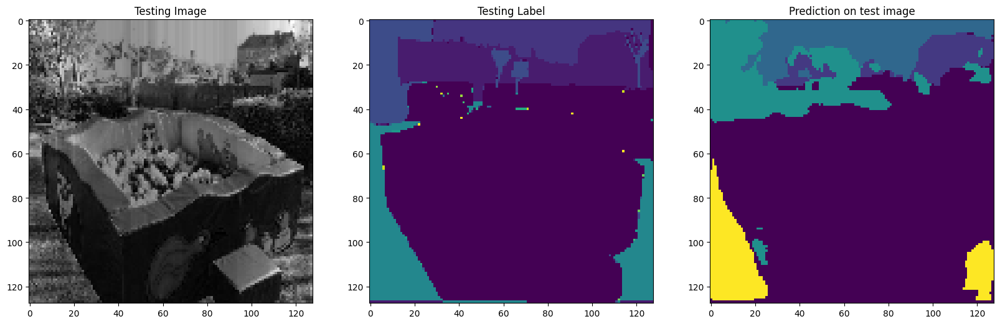

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10 11 13]
Unique Classes in predicted taesting image  [ 0  4 12]


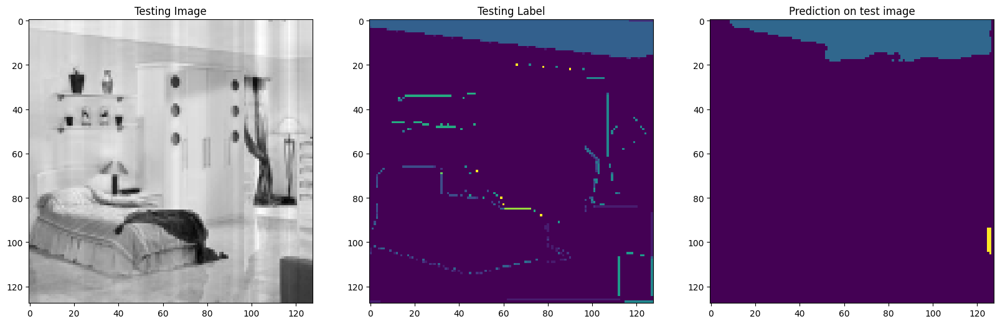

1/1 [==============================] - 0s 19ms/step
Unique Classes in Testing Image  [ 0  1  2  4  5  6  7  8  9 10 12]
Unique Classes in predicted taesting image  [0 4]


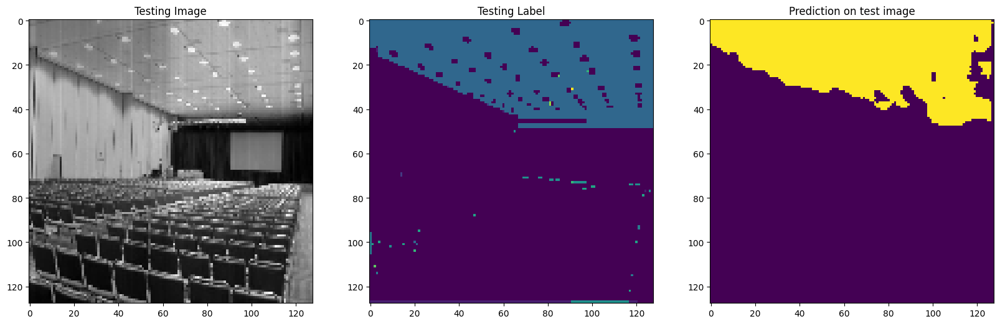

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  8  9 11 12]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 12]


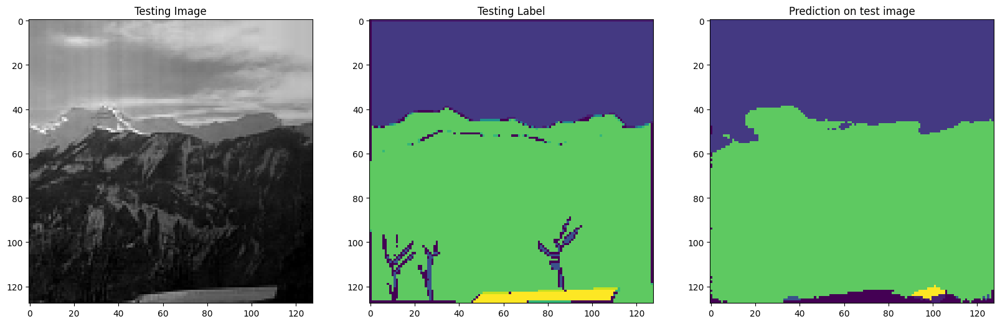

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  4  5  6  7 11 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10 12]


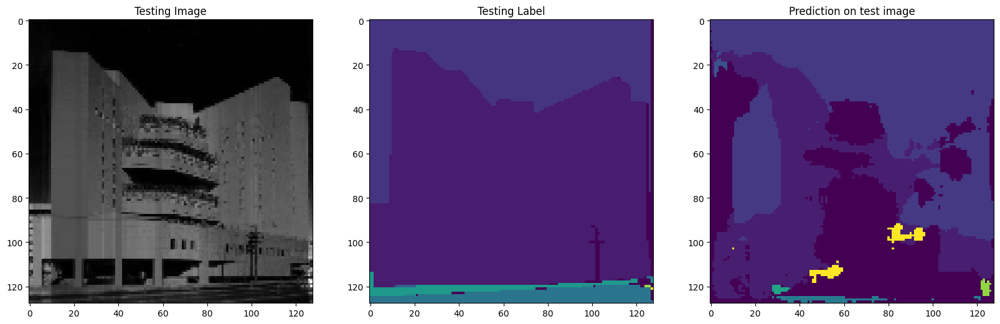

1/1 [==============================] - 0s 19ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  9 10 13]
Unique Classes in predicted taesting image  [0 4]


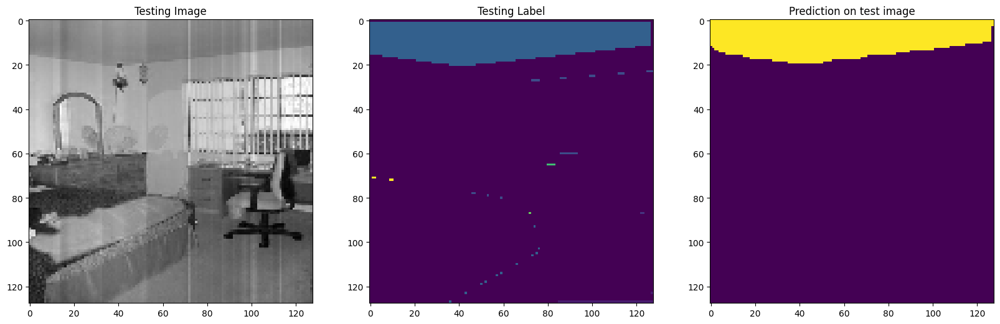

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11]
Unique Classes in predicted taesting image  [ 0  2  3  6 11]


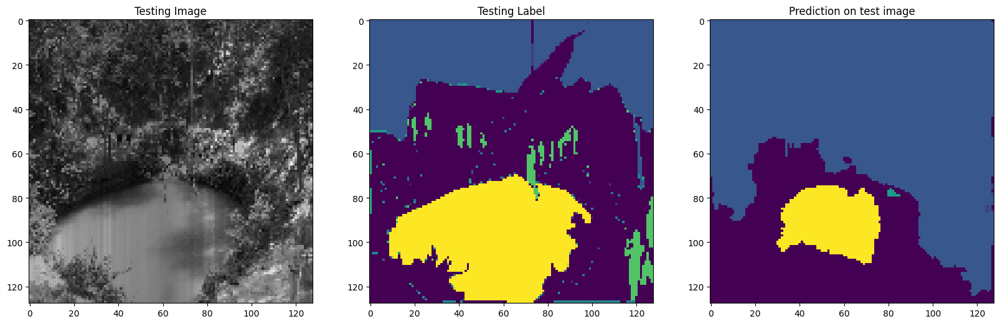

1/1 [==============================] - 0s 24ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  9 11 12 13]


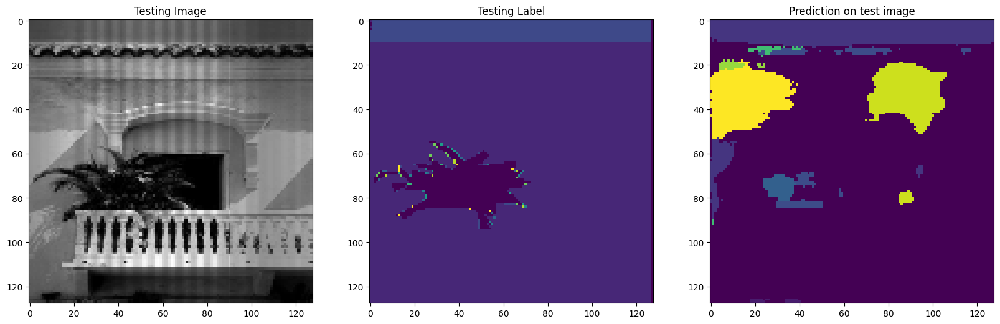

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  9 11]


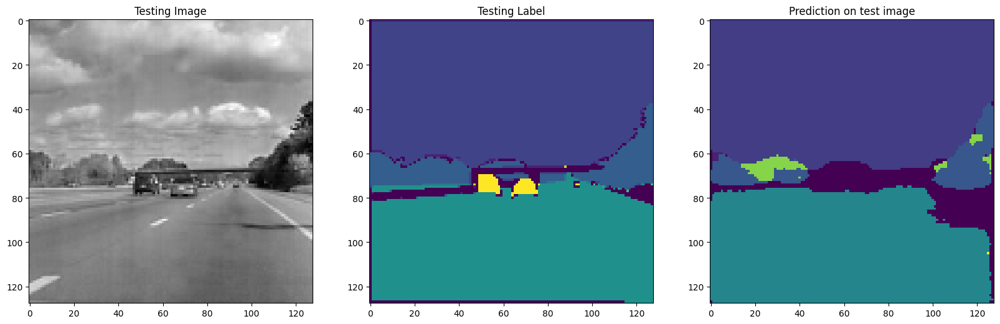

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  4 12]


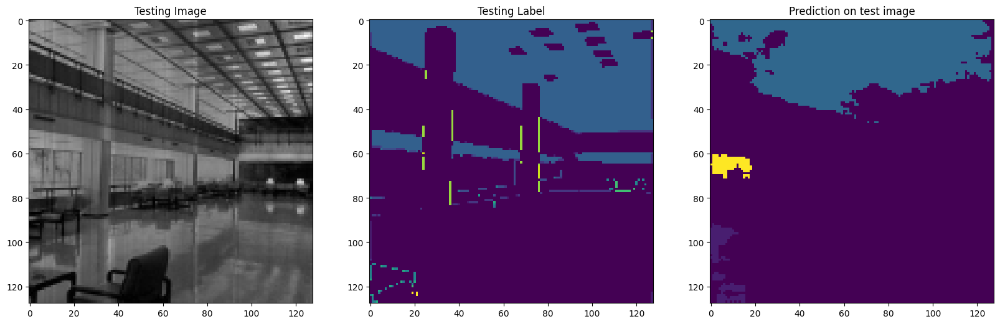

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 13]
Unique Classes in predicted taesting image  [0 1 2 3 5 7 8]


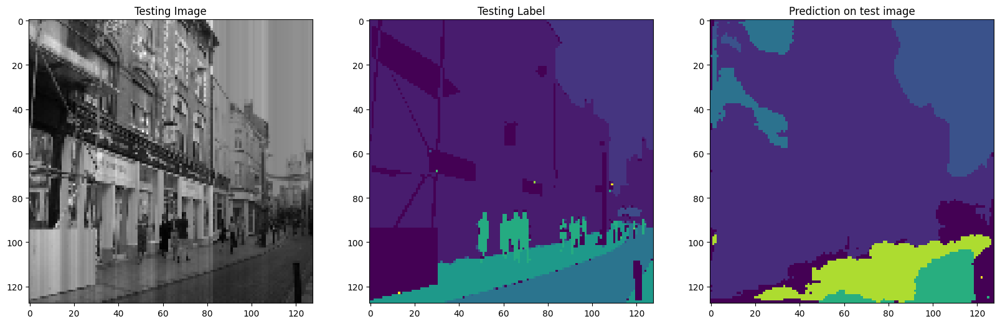

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  5  7  8 10 12]


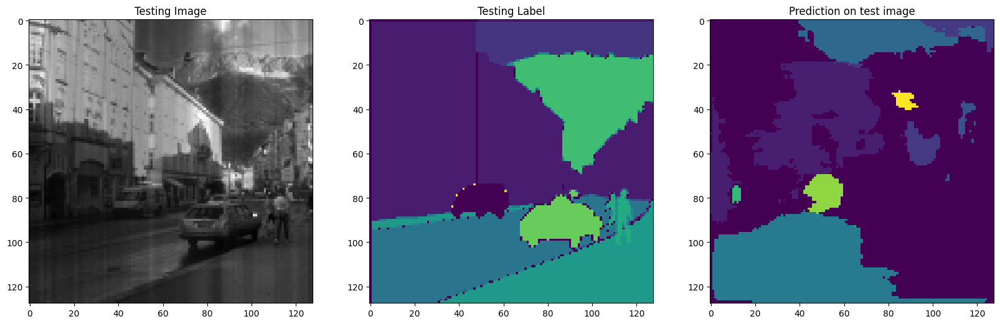

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5 10]


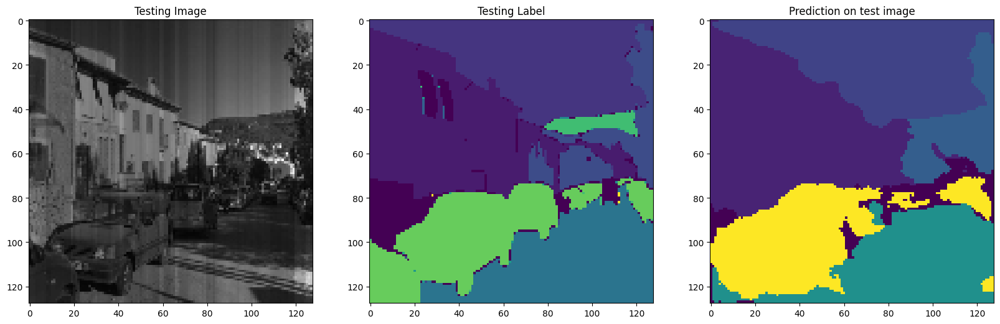

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  2  3  5  9 11 13]


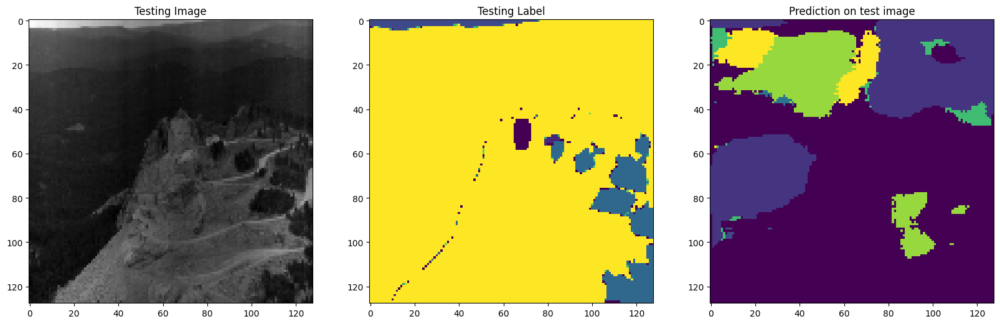

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 11]
Unique Classes in predicted taesting image  [0 4]


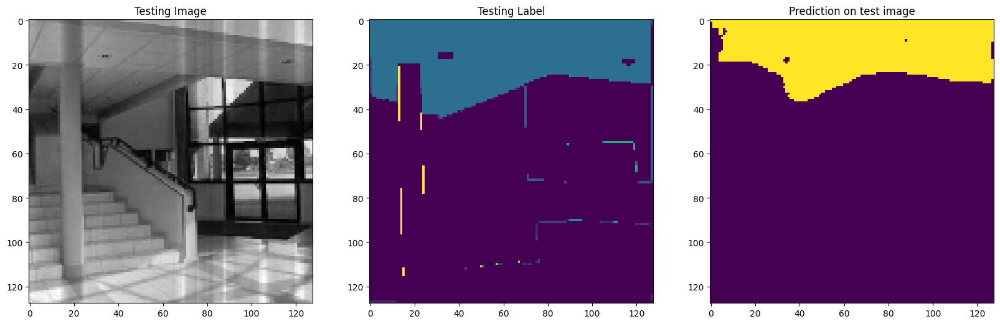

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 12 13]
Unique Classes in predicted taesting image  [ 0  1  7 12]


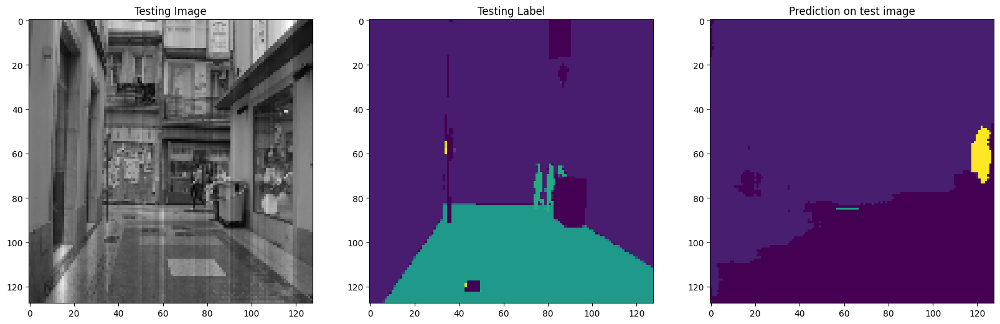

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 1 8]


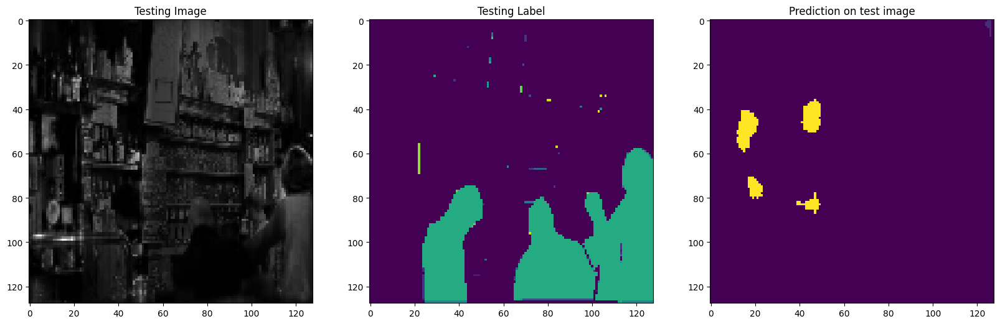

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  7  8  9 10]
Unique Classes in predicted taesting image  [0 1 2 3 5 9]


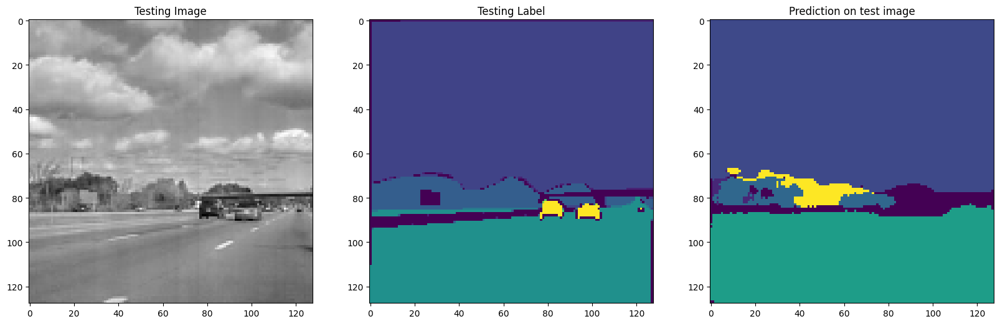

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10 12]


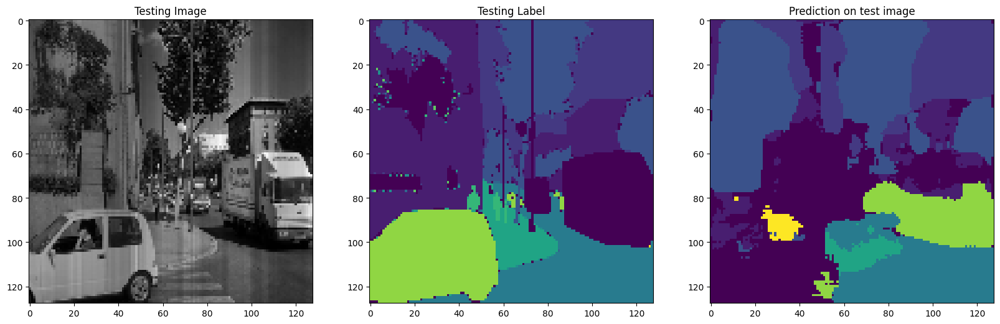

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  2  3  5  6  9 11]


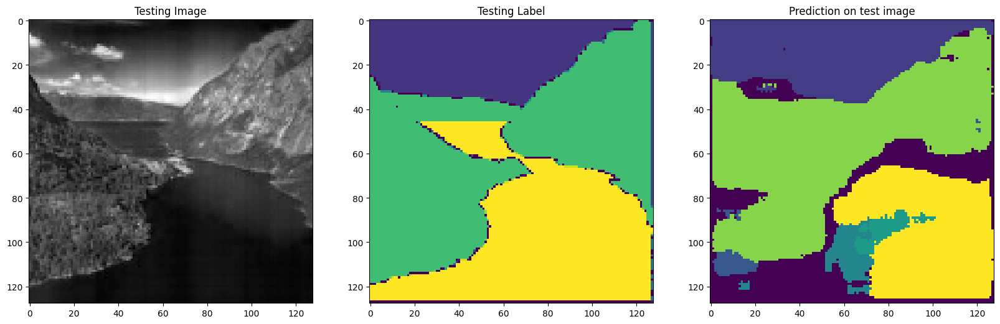

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10]
Unique Classes in predicted taesting image  [0 1 2 3 5 7]


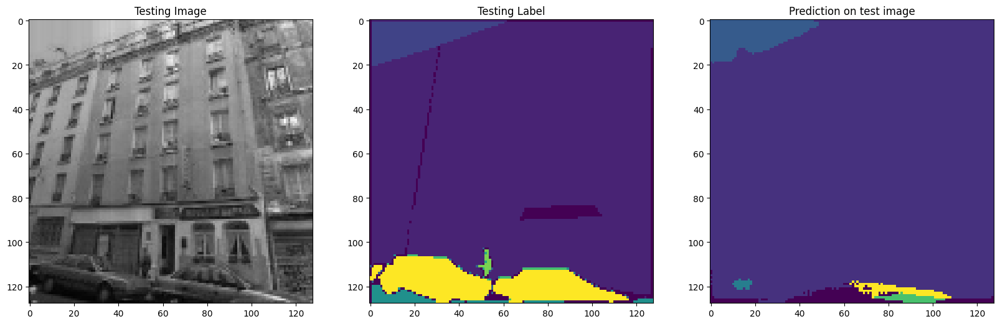

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 12]
Unique Classes in predicted taesting image  [0 1 4]


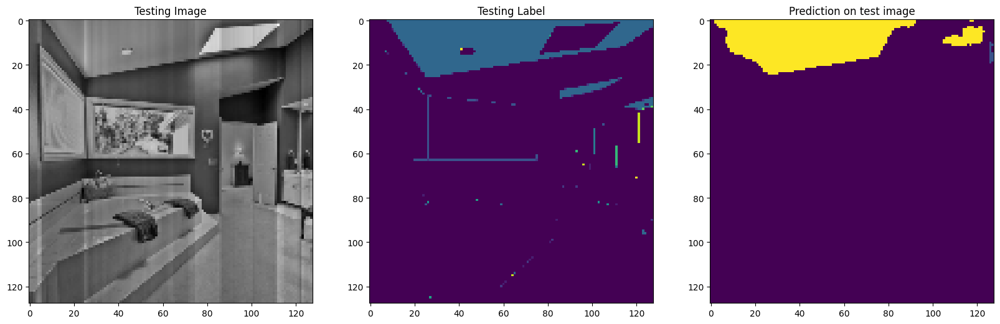

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 13]
Unique Classes in predicted taesting image  [0 1 2 3]


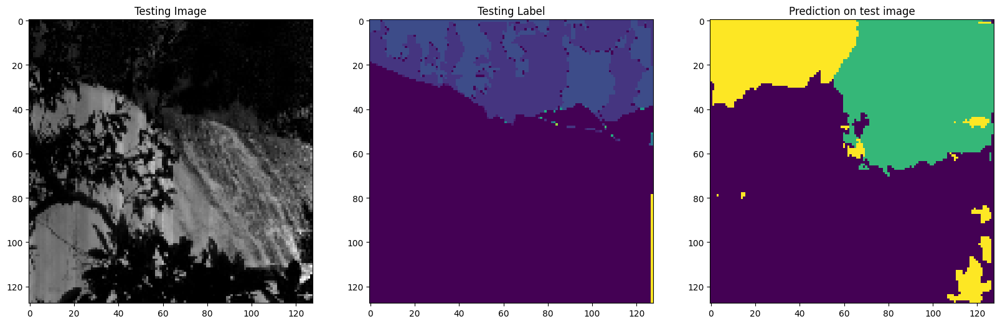

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  2  3  9 11 13]


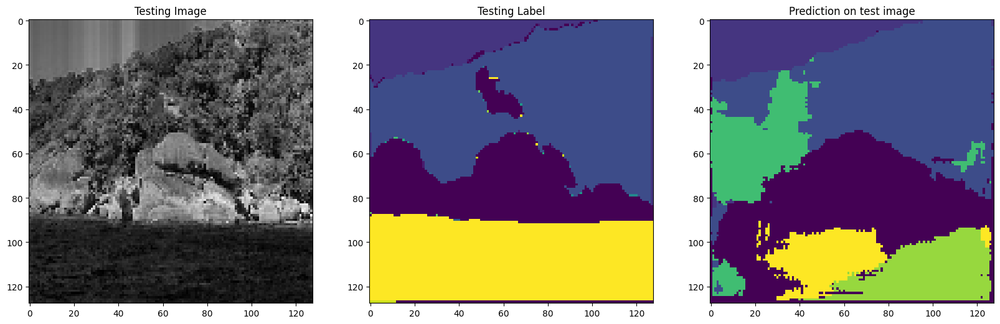

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10]


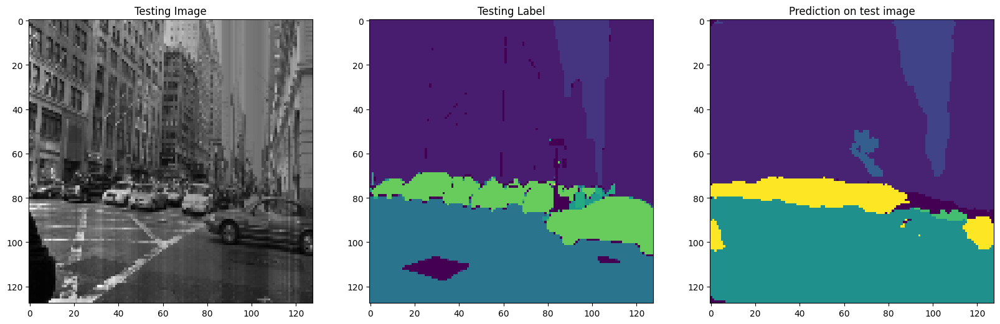

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10 11 12 13]
Unique Classes in predicted taesting image  [0 1 2 4 5 7 8]


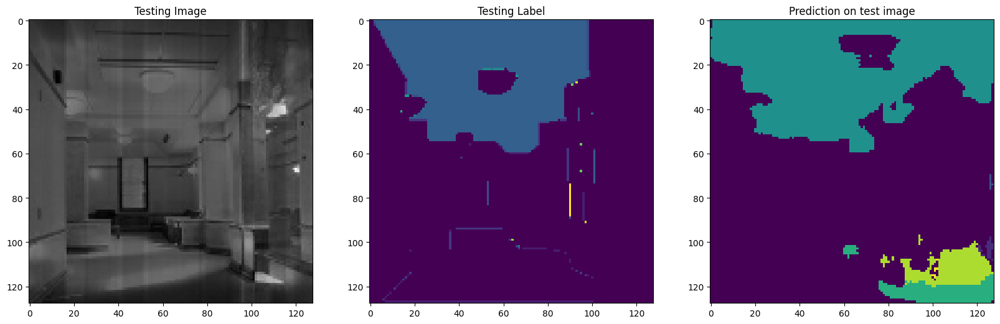

1/1 [==============================] - 0s 19ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 3 4]


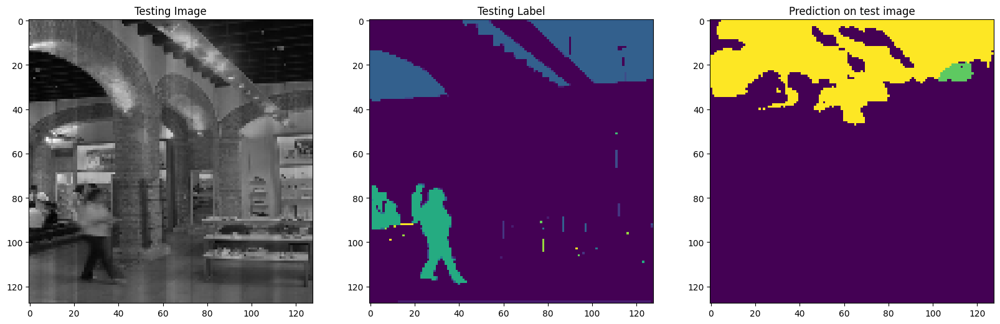

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 13]
Unique Classes in predicted taesting image  [0 1 2 3 6]


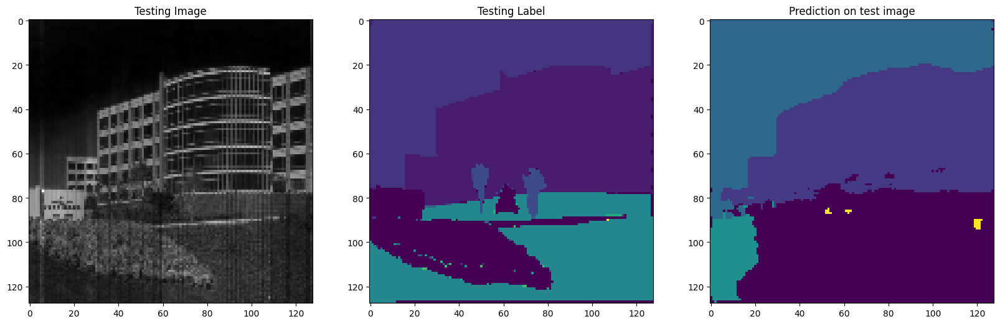

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12]
Unique Classes in predicted taesting image  [0 1 2 3 5 7]


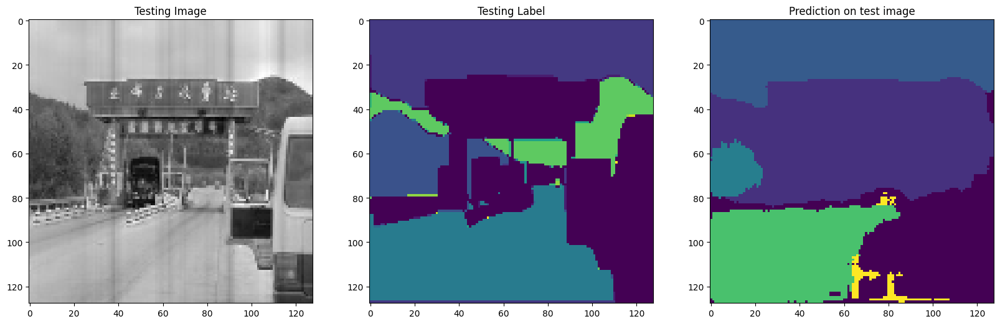

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [0 1 2 3 6]


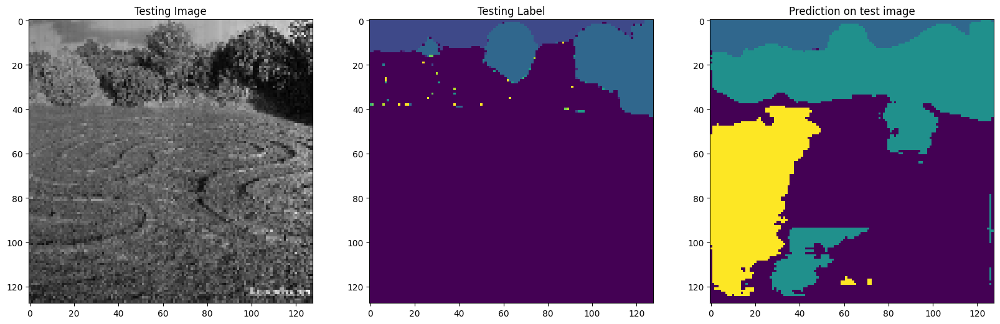

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [0 1 2 3]
Unique Classes in predicted taesting image  [ 0  2  3  4  5  6  9 11]


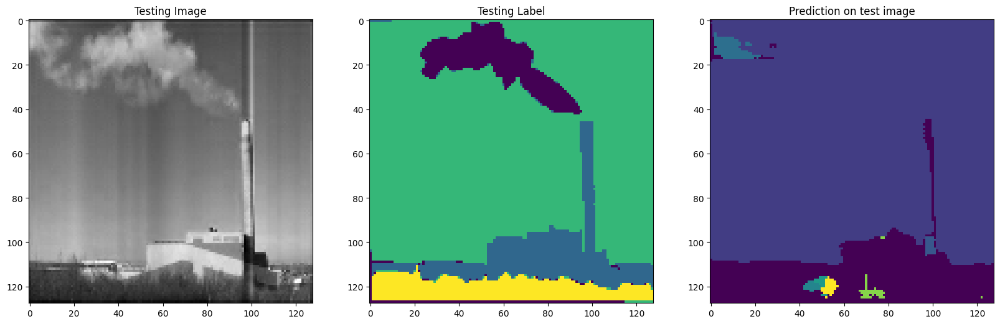

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 12 13]
Unique Classes in predicted taesting image  [0 1 4 5 6 7]


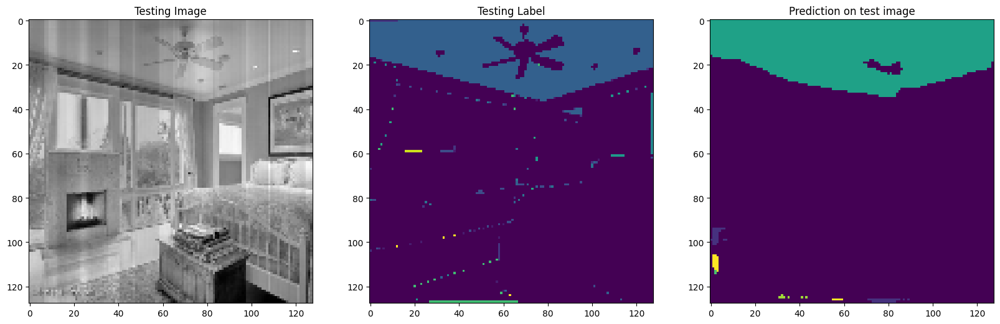

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5]
Unique Classes in predicted taesting image  [0 3 4]


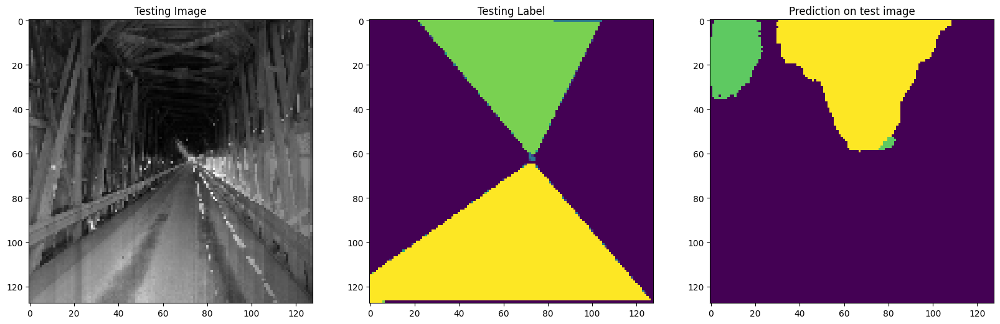

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 3 8 9]


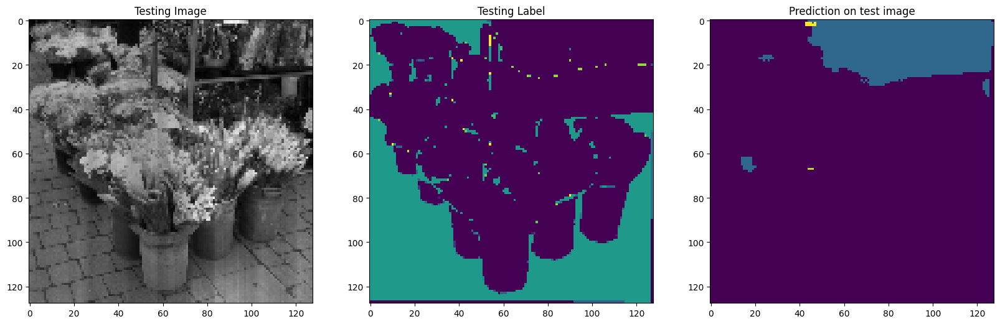

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  5  6  7 10]


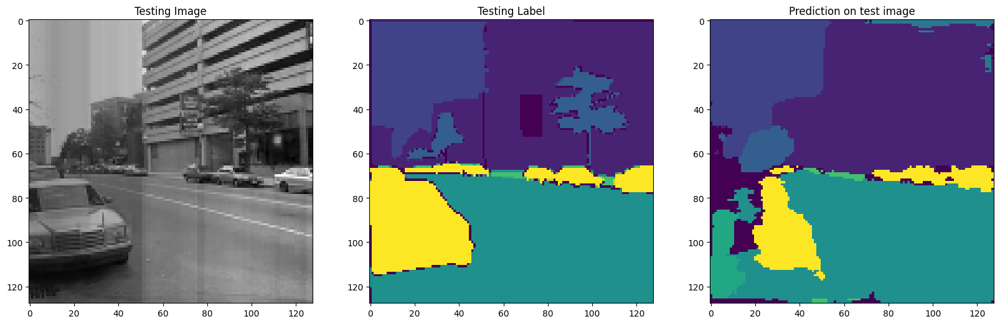

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  7  8 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  6  9 12]


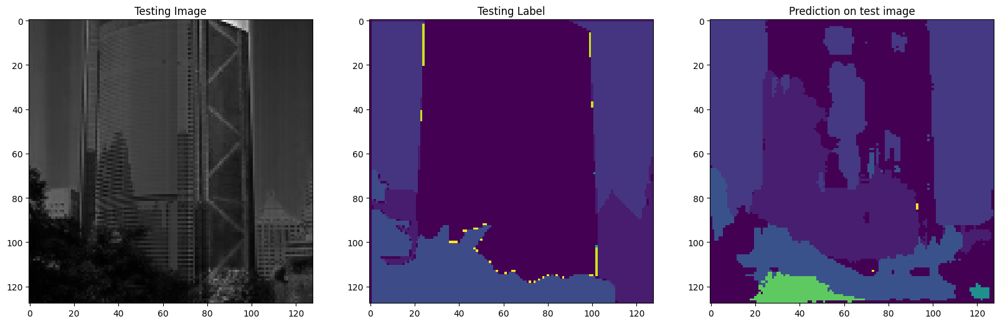

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 4 5 6 8 9]
Unique Classes in predicted taesting image  [0 1 2 3 9]


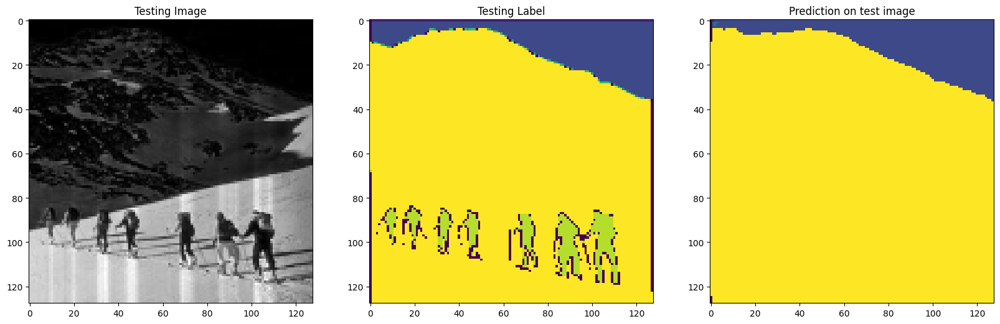

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [ 0  2  3  5  6  9 11]


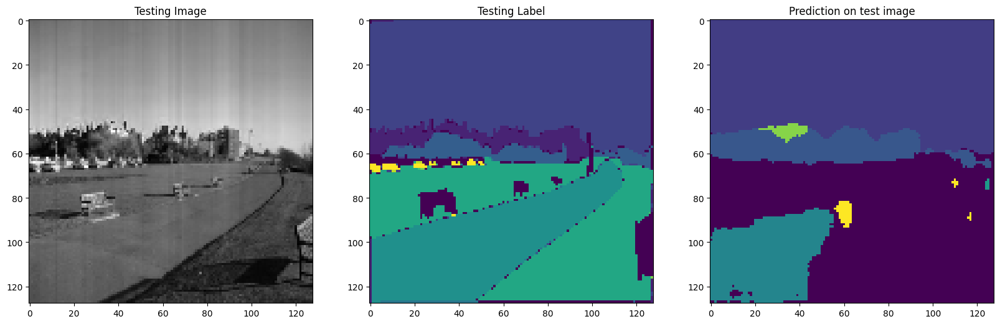

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 13]
Unique Classes in predicted taesting image  [ 0  1  2  4  5  7  9 12]


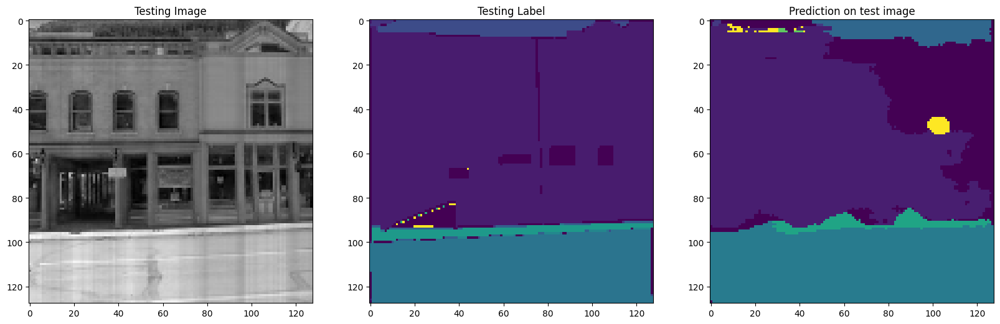

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  7  9 11 12]


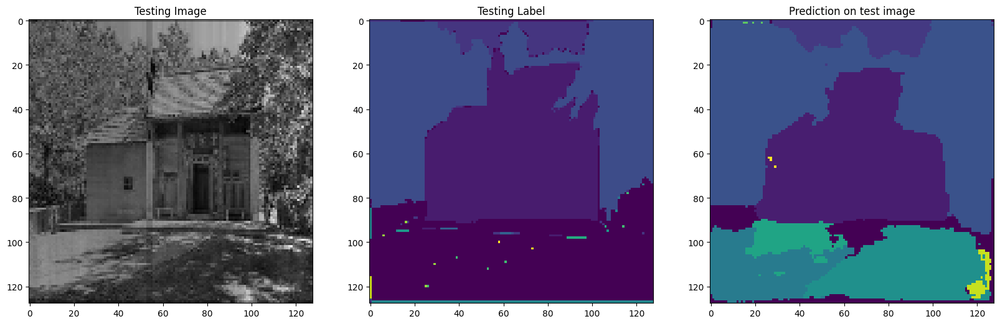

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


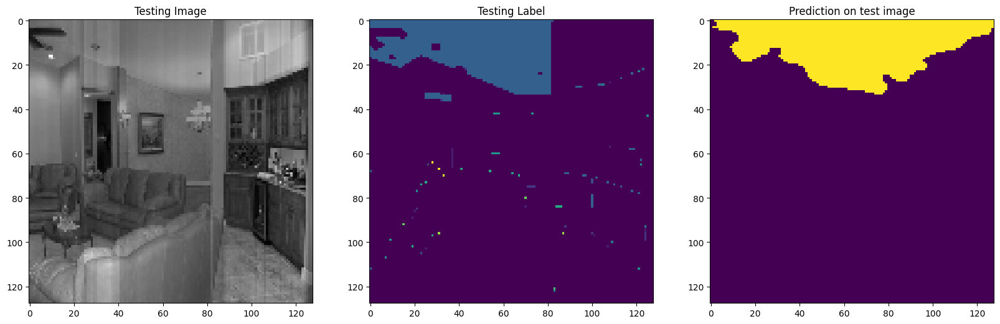

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10 13]
Unique Classes in predicted taesting image  [ 0  2 13]


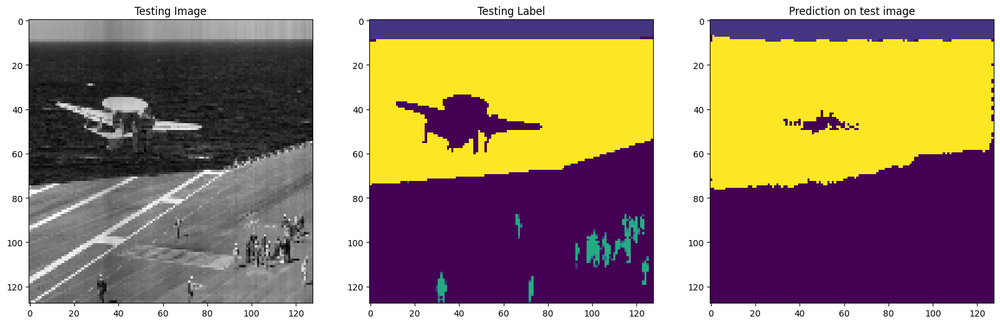

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 10]


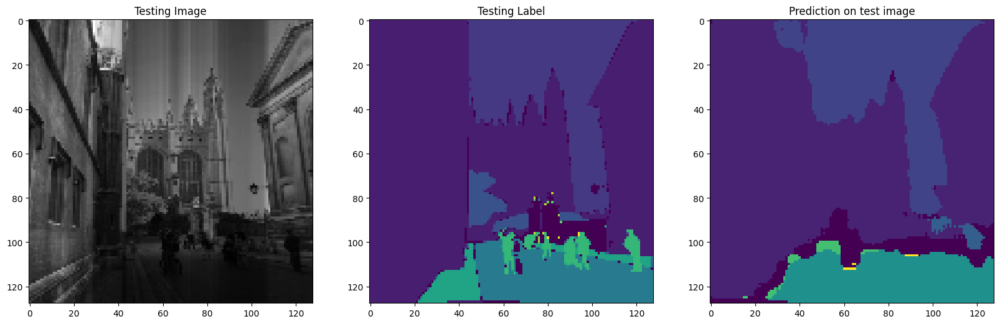

1/1 [==============================] - 0s 19ms/step
Unique Classes in Testing Image  [0 1 2 3]
Unique Classes in predicted taesting image  [ 0  2  3  9 13]


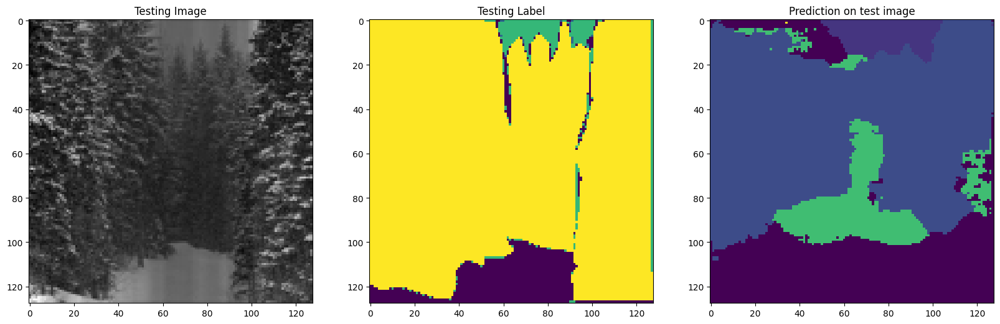

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 2 3 4]


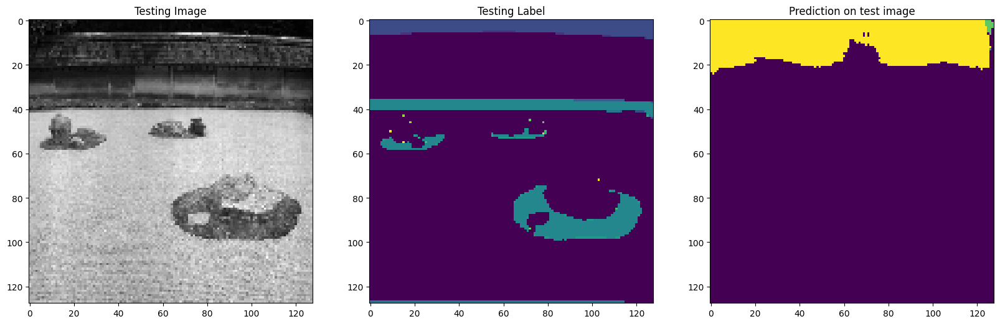

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  7  8  9 10 11]
Unique Classes in predicted taesting image  [0 1 2 3 5 6 7 8]


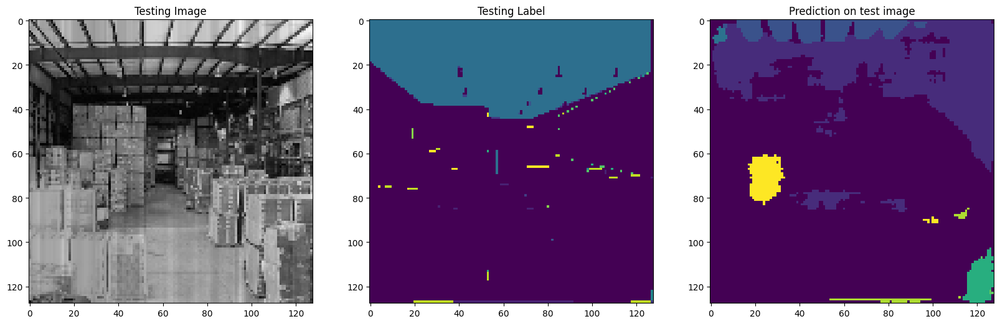

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  9 11]


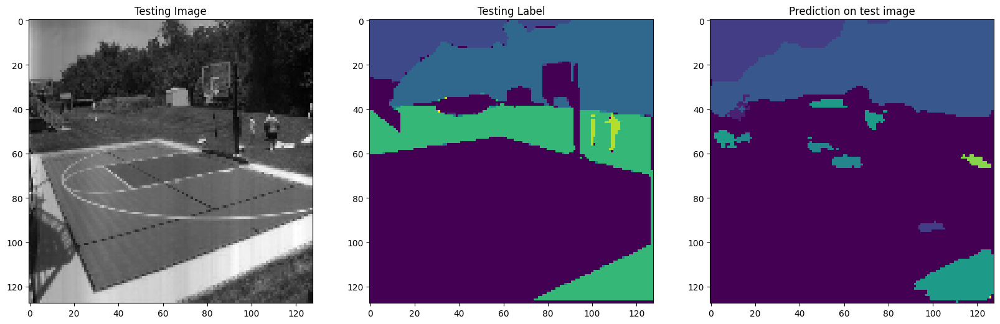

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  7  8 10]


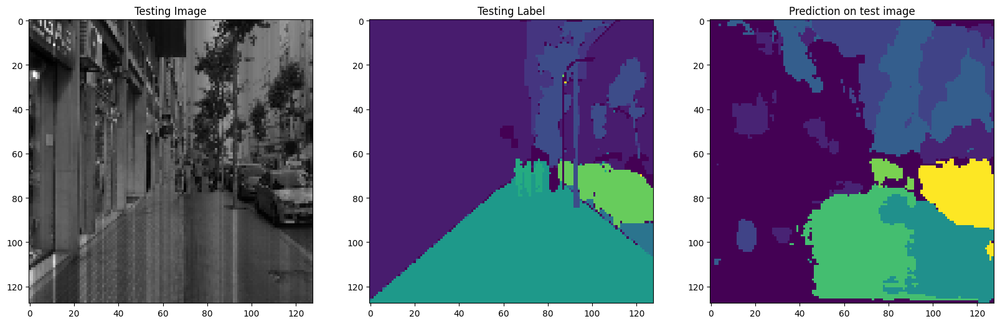

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [ 0  1  2  3 12]


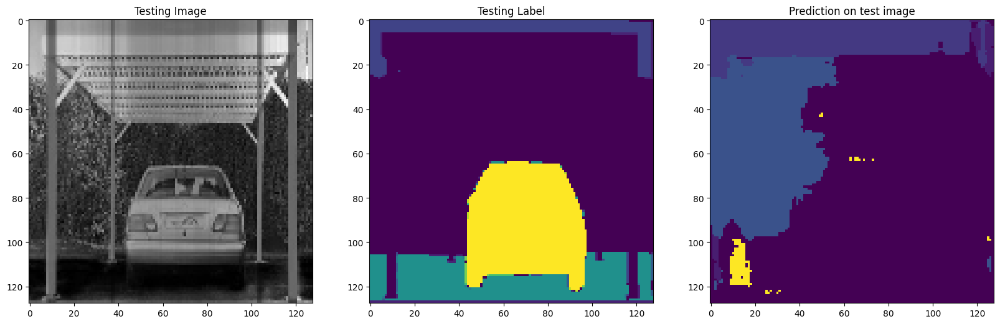

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6 11 12]


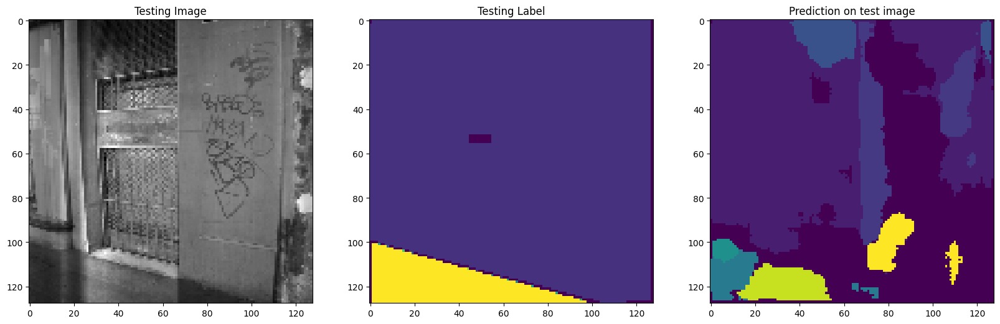

1/1 [==============================] - 0s 24ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 13]
Unique Classes in predicted taesting image  [ 0  2  3  5  6  9 10]


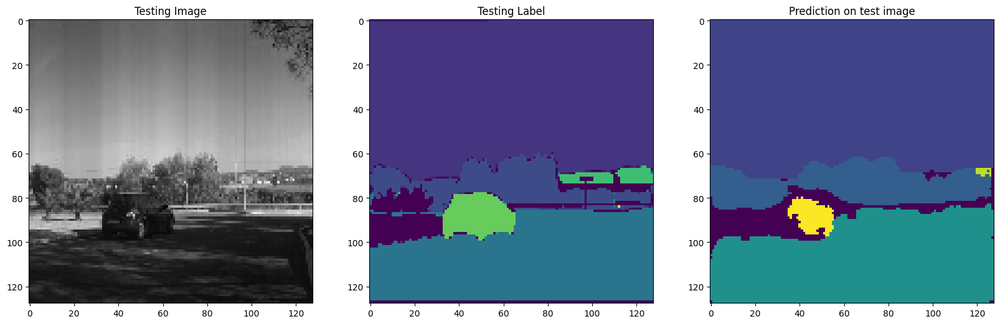

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  7 12]


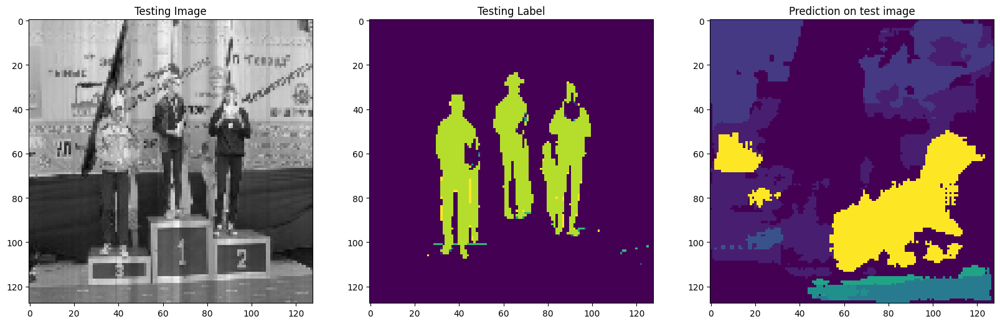

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  9 11 13]
Unique Classes in predicted taesting image  [0 2 4]


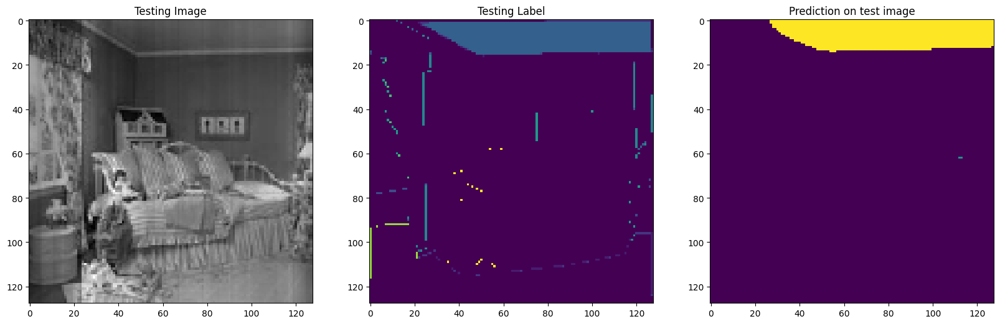

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  3  4  5  7 12]


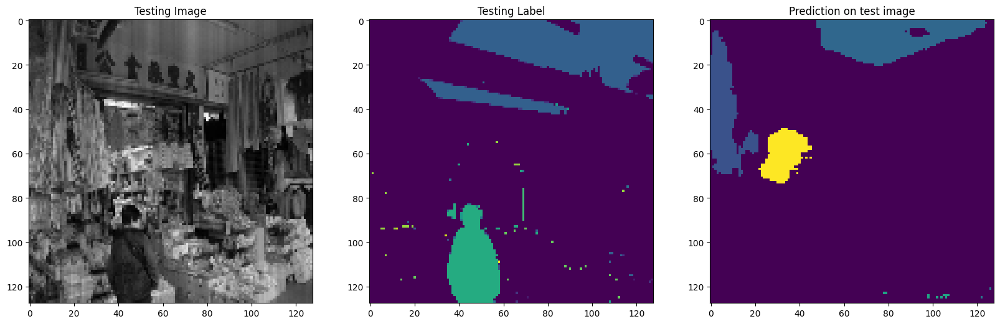

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12]
Unique Classes in predicted taesting image  [0 3]


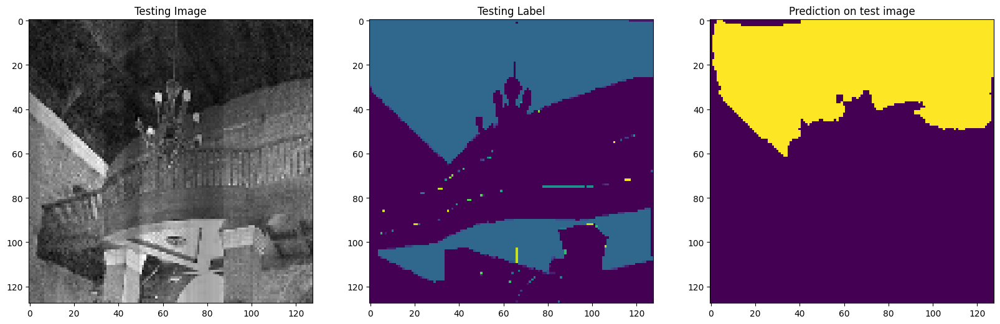

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  9 11 12]


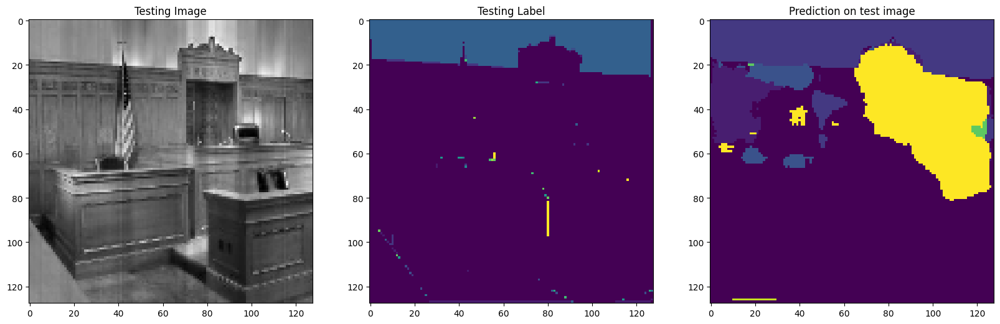

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  7  9 12]


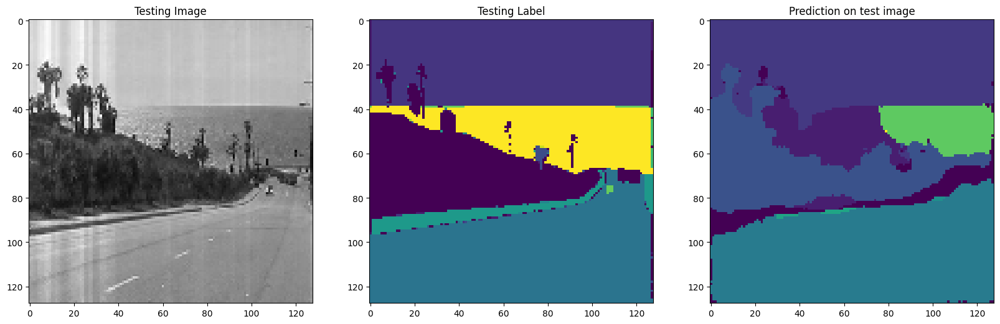

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  6  7  9 13]
Unique Classes in predicted taesting image  [0 1 2 8]


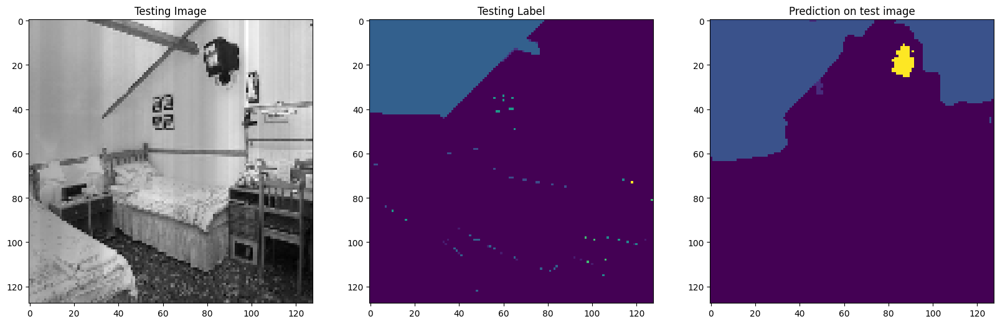

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [ 0  1  5  7 10]


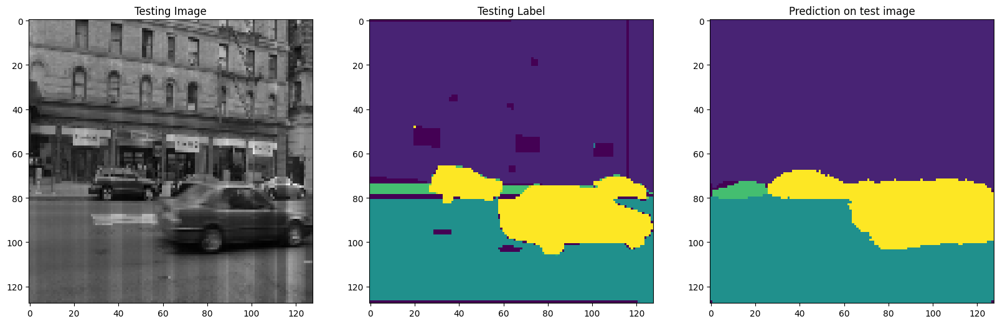

1/1 [==============================] - 0s 26ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  6  7  8 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


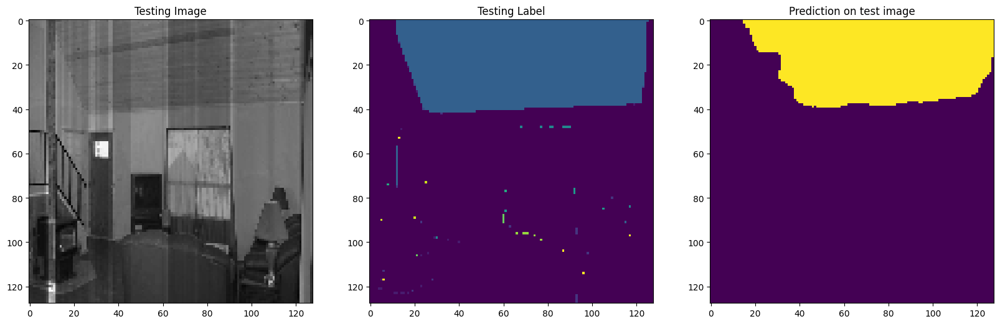

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 1 2 3 5 6 7]


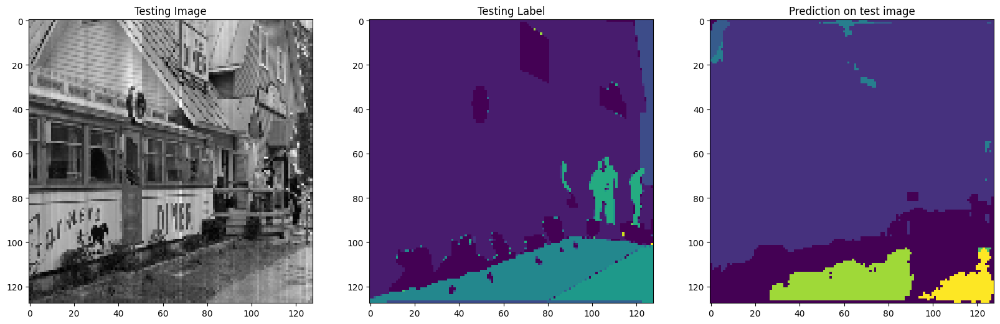

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  7  8 10 12]
Unique Classes in predicted taesting image  [ 0  2  3  5  9 10]


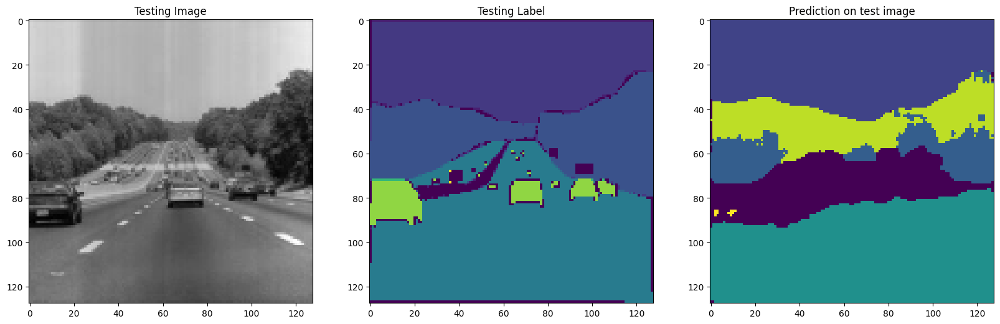

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  2  3  6 11]


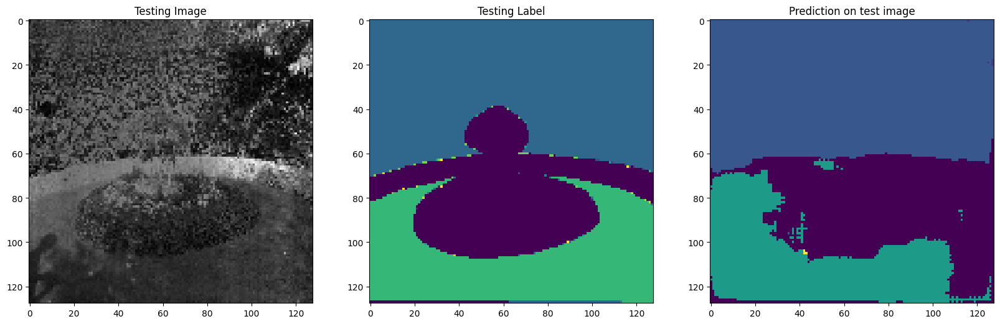

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 8]
Unique Classes in predicted taesting image  [0 1 2 3 9]


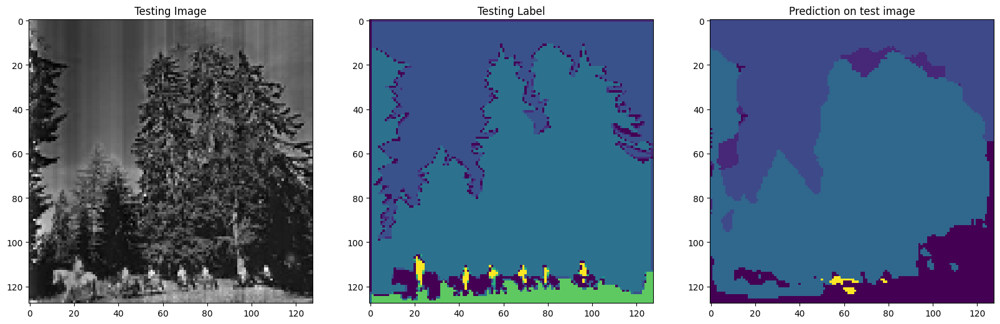

1/1 [==============================] - 0s 19ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11]
Unique Classes in predicted taesting image  [0 3]


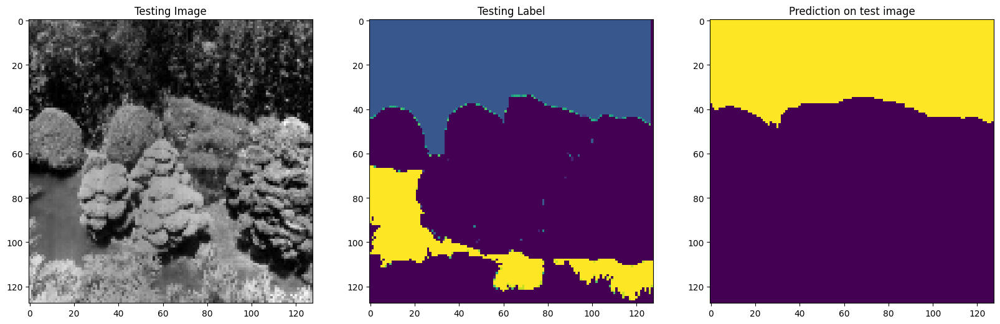

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [0 1 2 3 4]


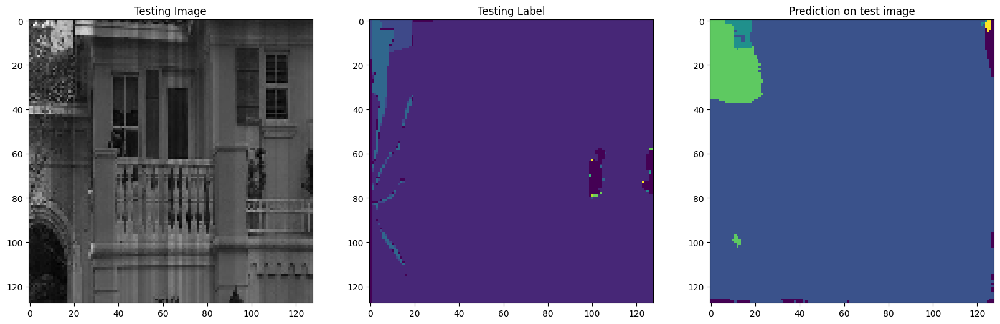

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  7  8 12]


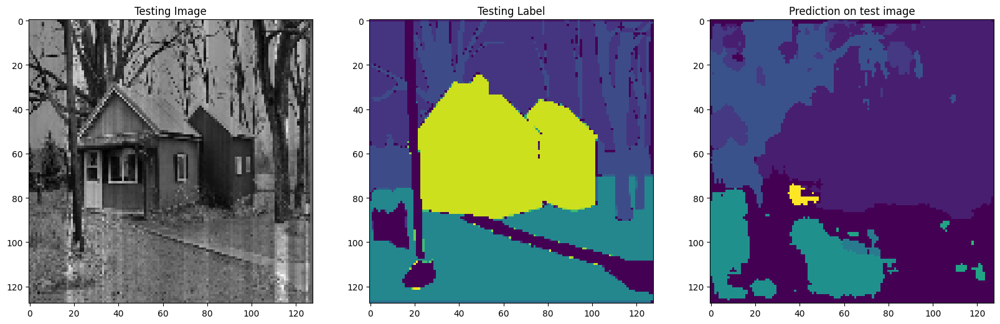

1/1 [==============================] - 0s 19ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  5  7  8 10]


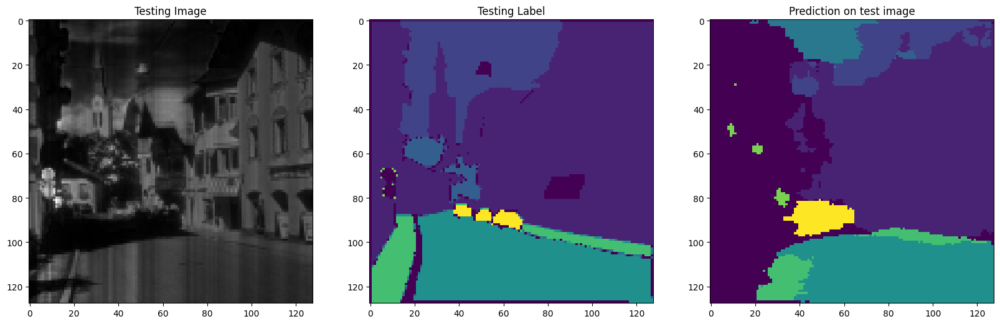

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5 10]
Unique Classes in predicted taesting image  [0 4]


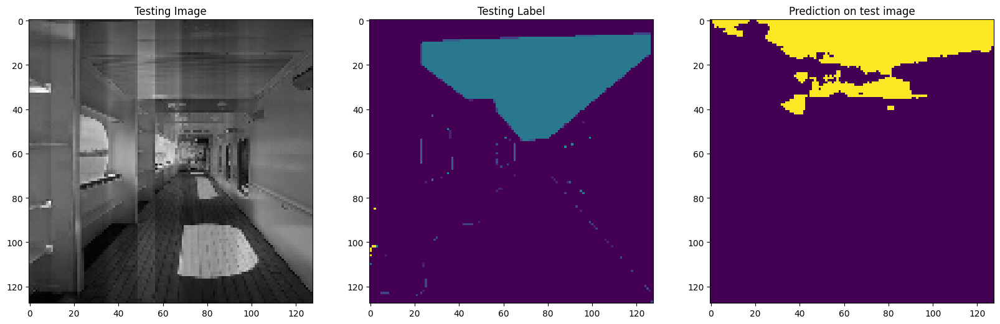

1/1 [==============================] - 0s 38ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 12 13]
Unique Classes in predicted taesting image  [0 4]


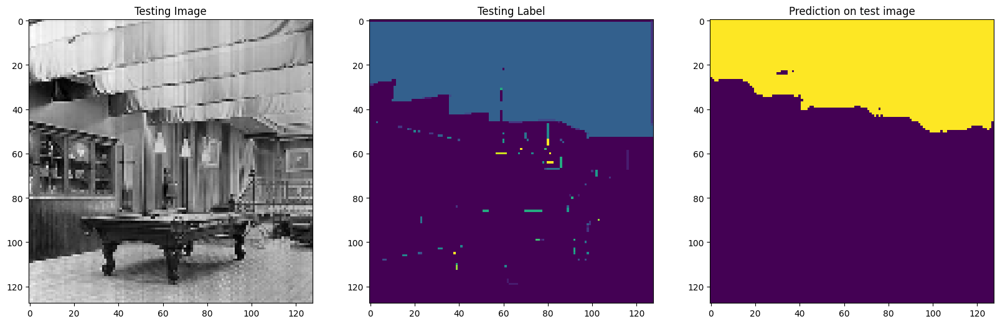

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7]
Unique Classes in predicted taesting image  [0 4]


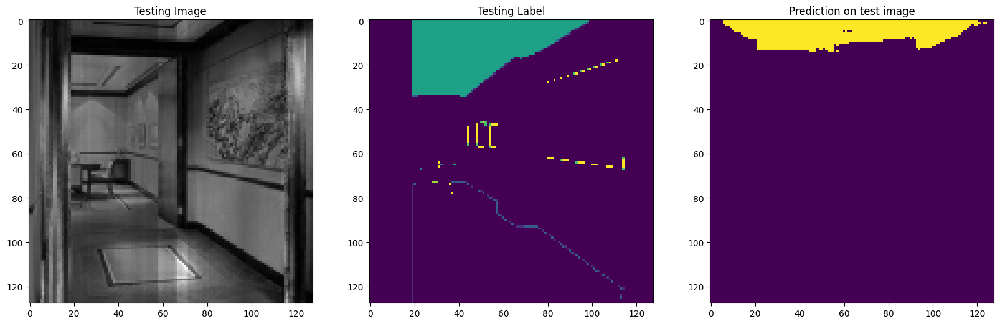

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 13]
Unique Classes in predicted taesting image  [0 2 3 4]


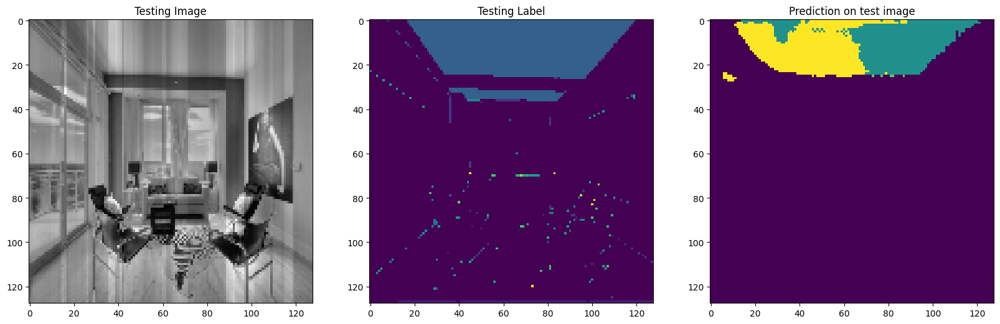

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  5  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  2  3  9 13]


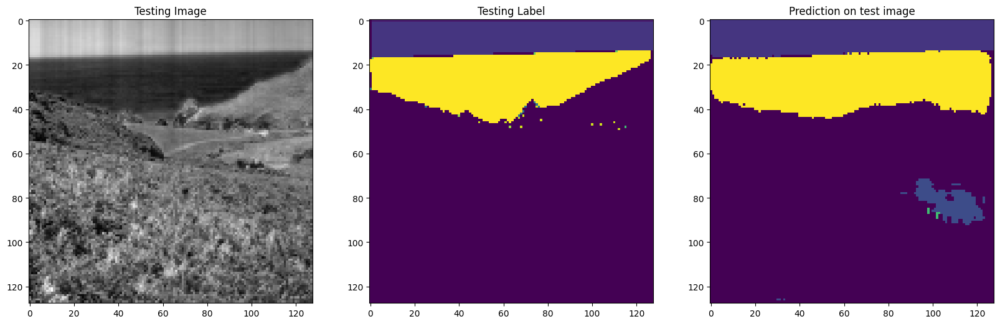

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [ 0  2  3  5  6  9 11 12]


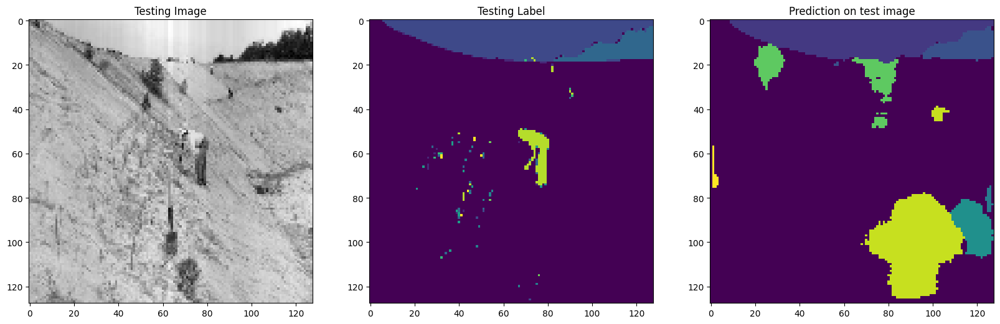

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7]
Unique Classes in predicted taesting image  [ 0  2  3  6  9 11 12]


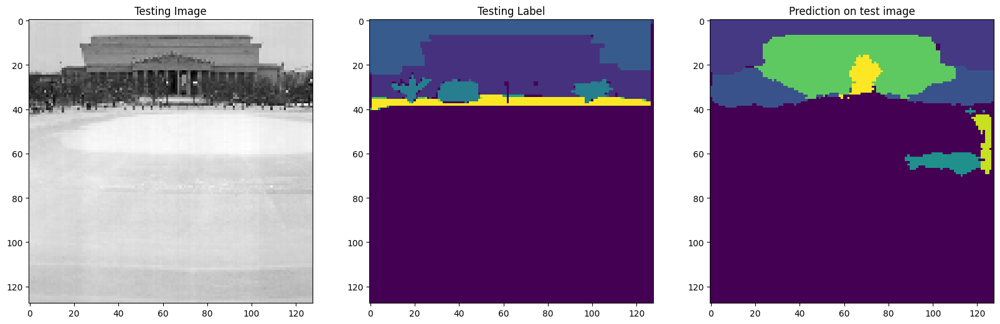

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  4  5  6  9 10 12]
Unique Classes in predicted taesting image  [ 0  2  3  6  9 11]


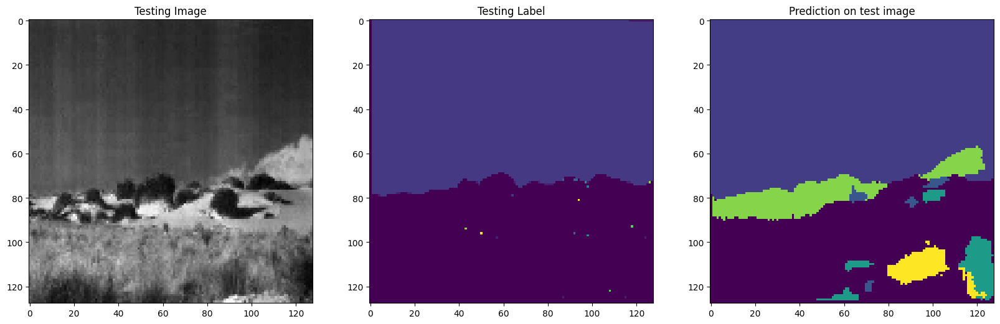

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  7  8  9 10]
Unique Classes in predicted taesting image  [0 1 2 4 8]


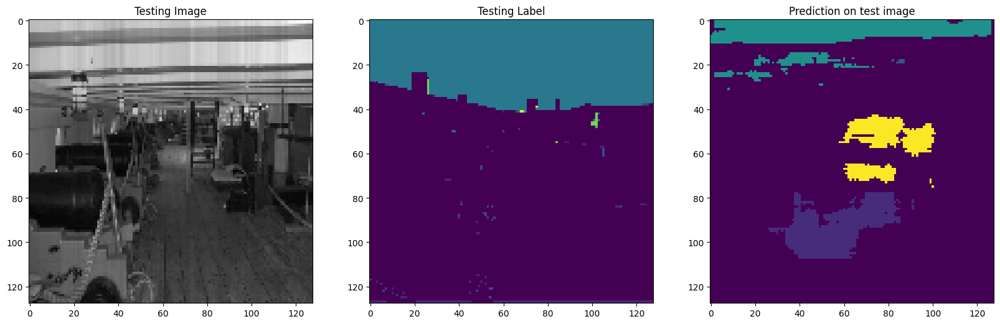

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7 13]
Unique Classes in predicted taesting image  [0 2 4]


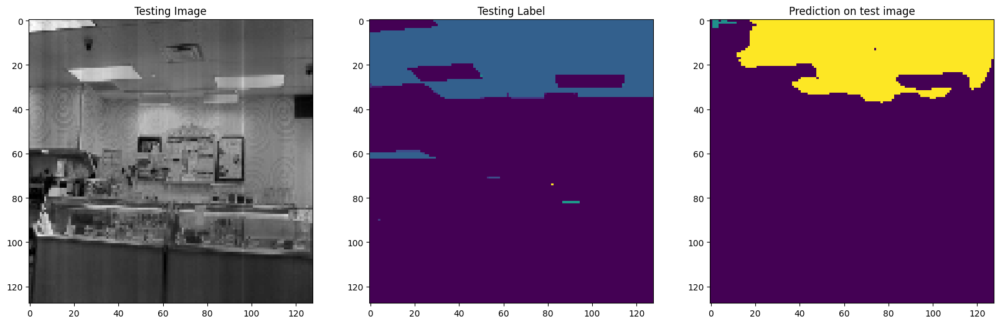

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  7 11]
Unique Classes in predicted taesting image  [0 4]


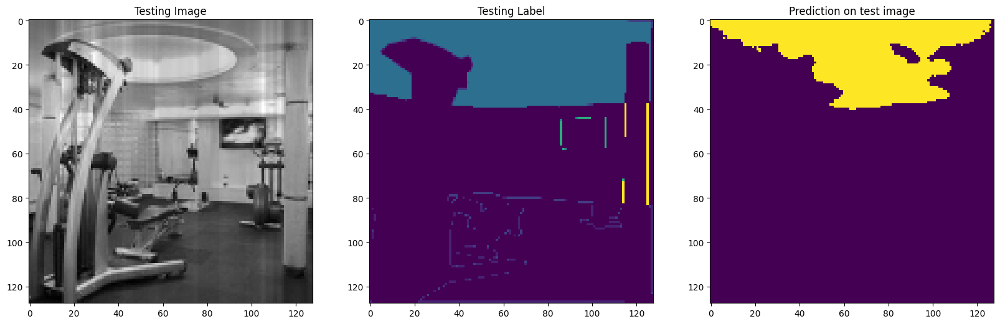

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7 8 9]
Unique Classes in predicted taesting image  [0 1 2 3 9]


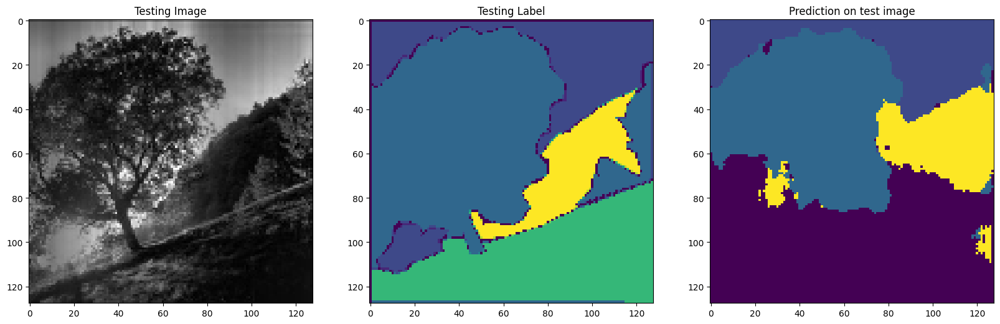

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


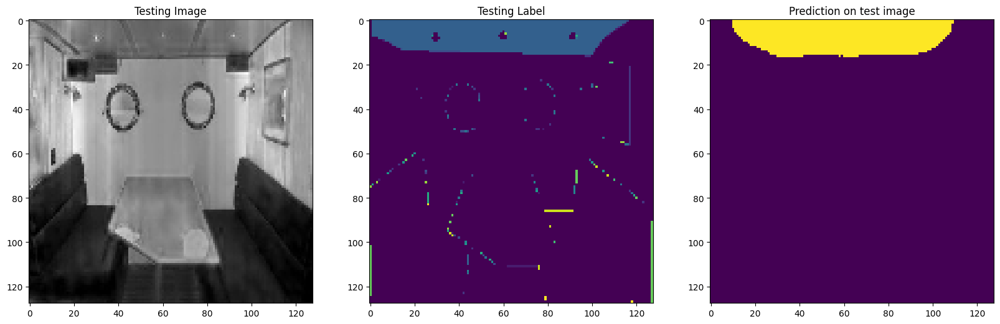

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7  8 12]


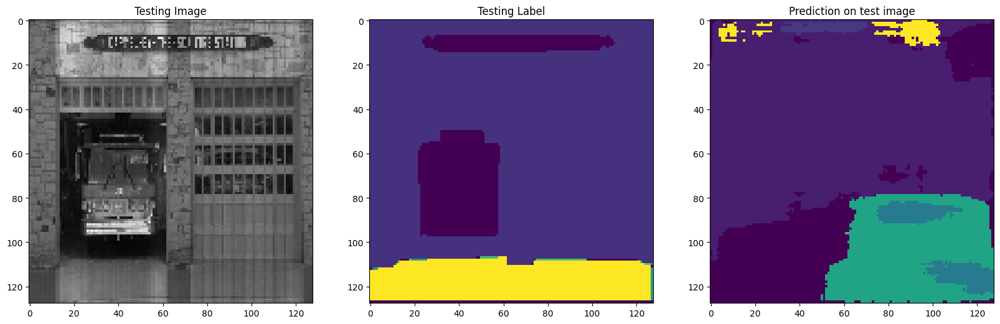

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  8  9 12]


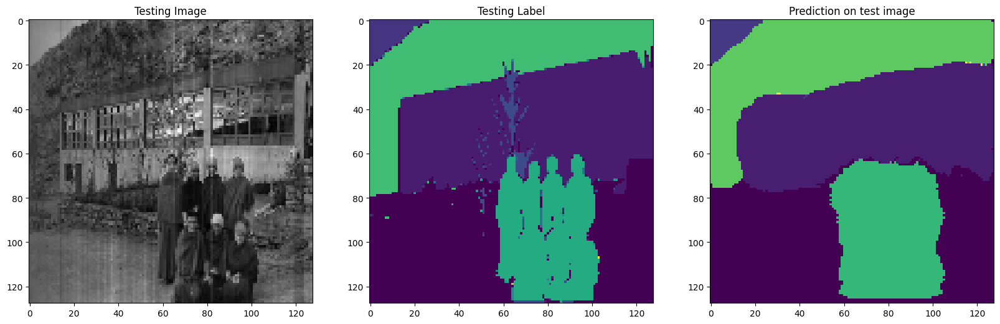

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 11 12 13]
Unique Classes in predicted taesting image  [0 4]


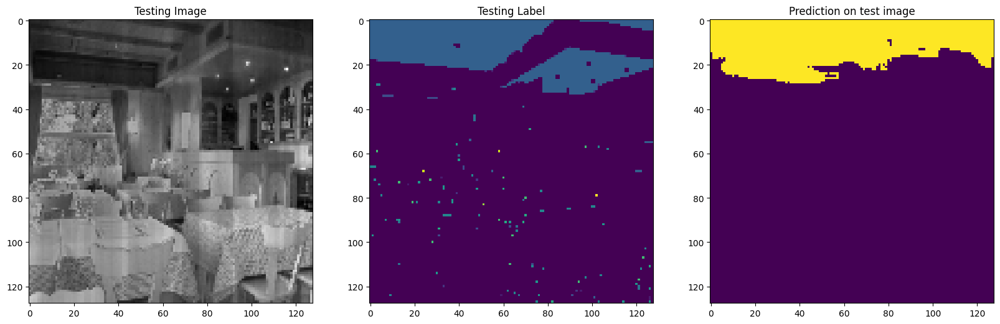

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  8 12]


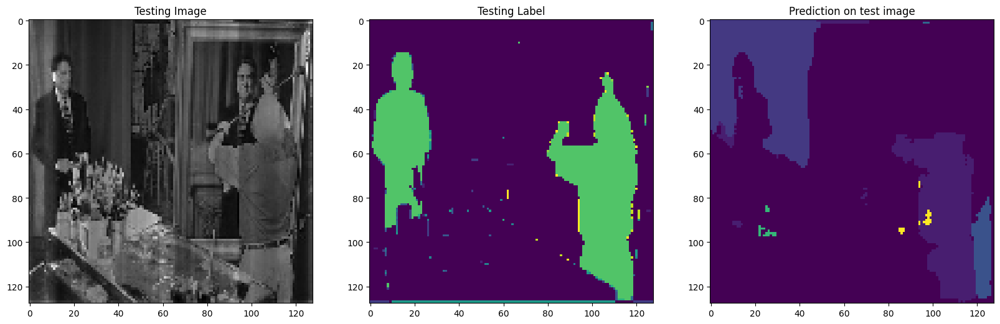

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


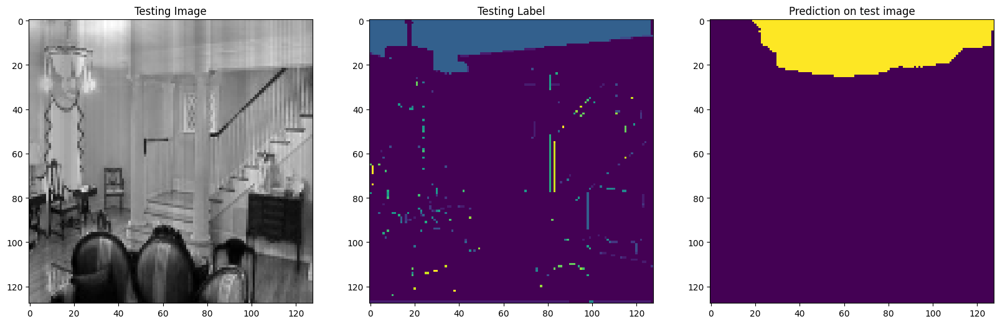

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 2 3 5 6]


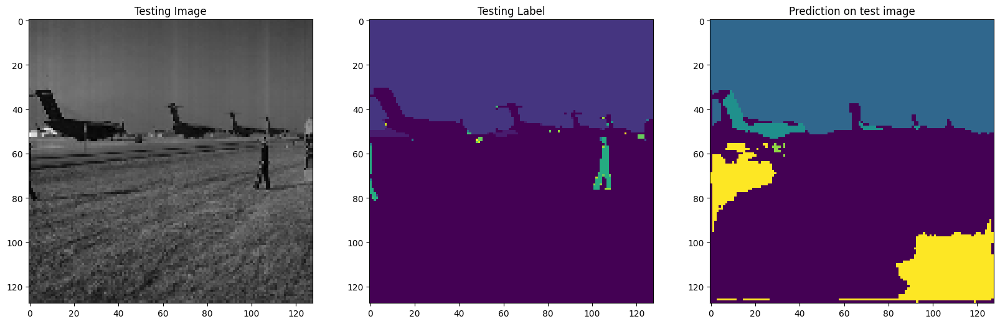

1/1 [==============================] - 0s 19ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  7  9 12]


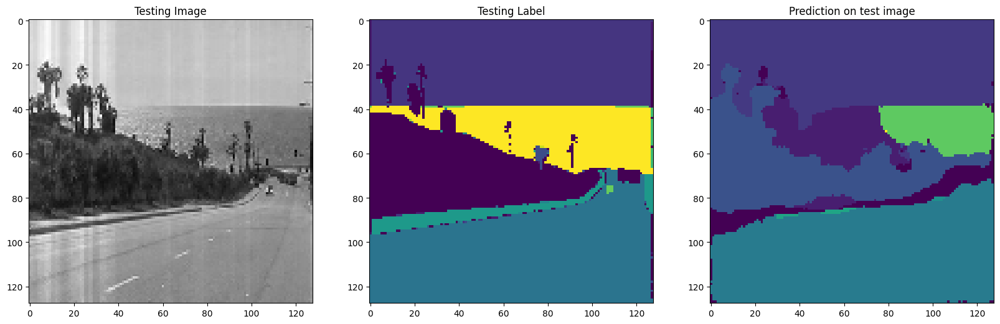

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  3  5  6  7  8  9 10 11 12]


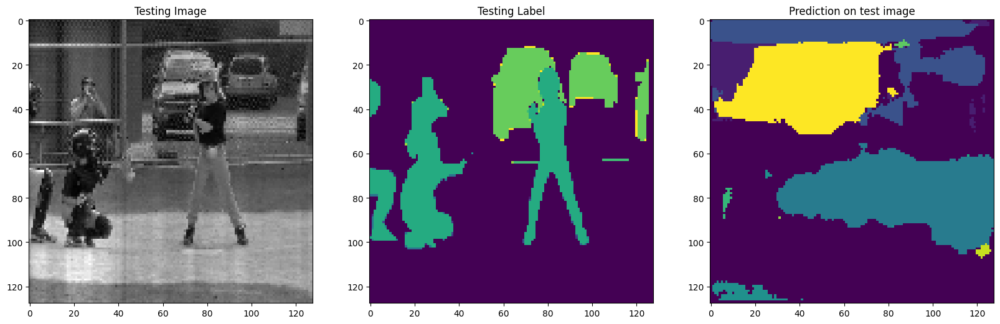

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [0 1 2]
Unique Classes in predicted taesting image  [0 1 2 3 5]


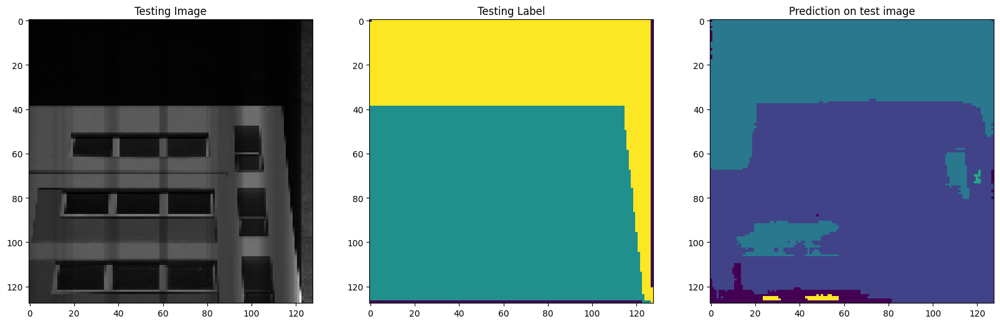

1/1 [==============================] - 0s 23ms/step
Unique Classes in Testing Image  [0 1 2]
Unique Classes in predicted taesting image  [0 1 2 3 9]


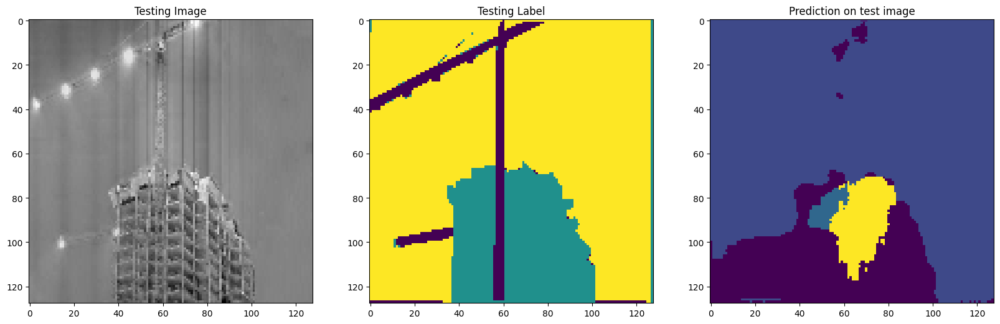

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  7 12]


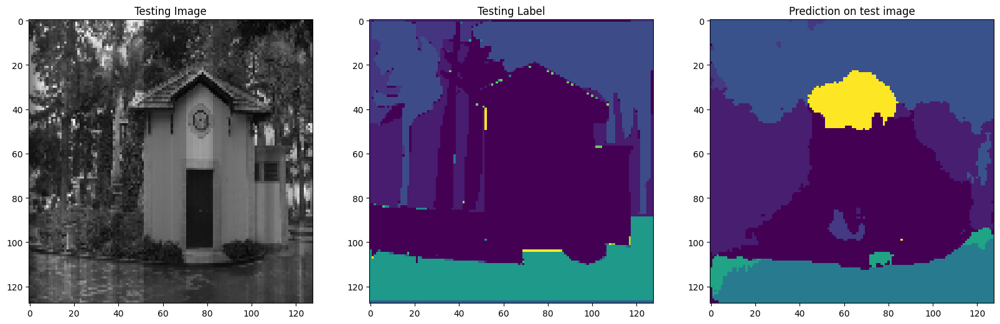

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


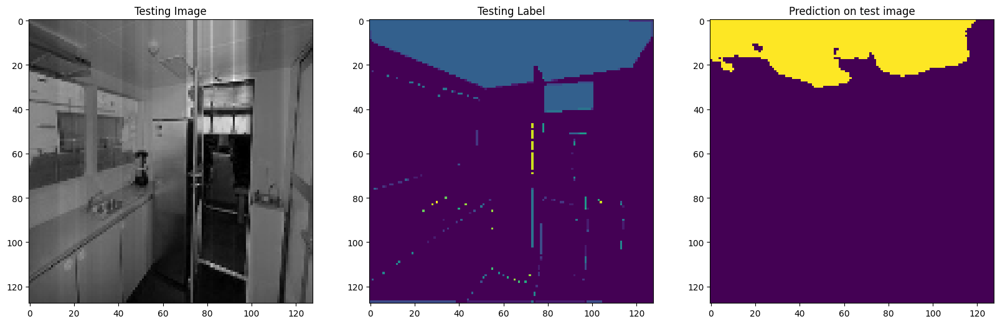

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  9 11 12]


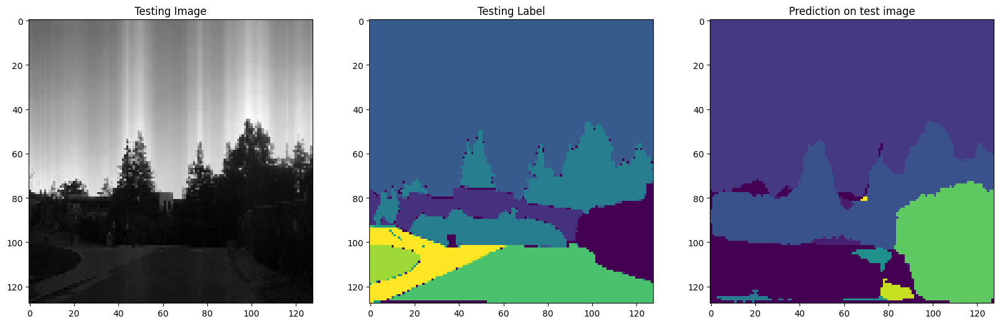

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11]
Unique Classes in predicted taesting image  [0 2 4 8]


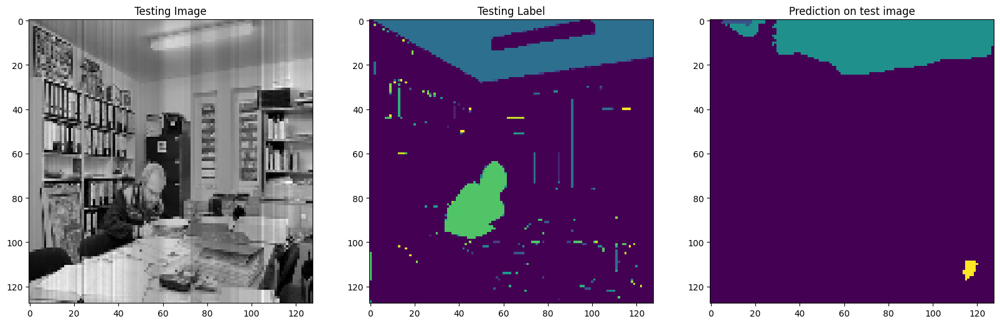

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12 13]
Unique Classes in predicted taesting image  [0 4]


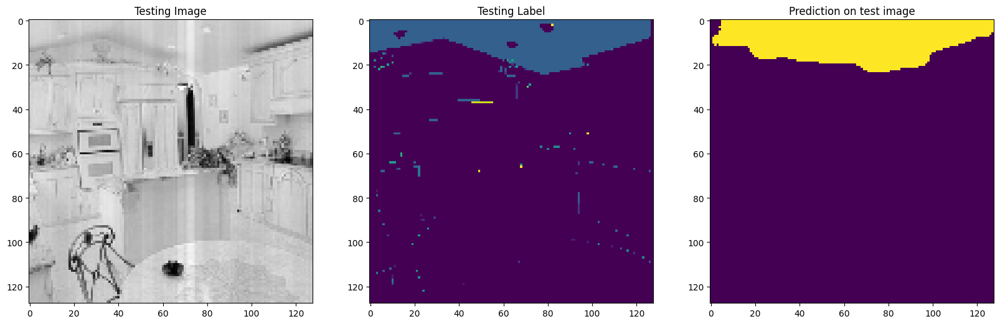

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


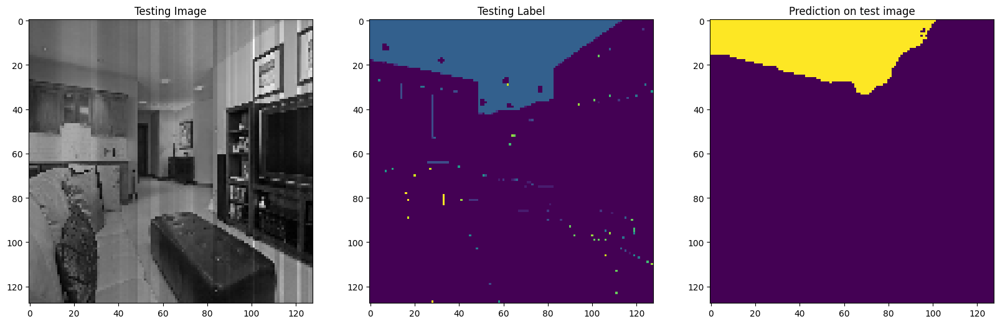

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7]
Unique Classes in predicted taesting image  [ 0  4 12]


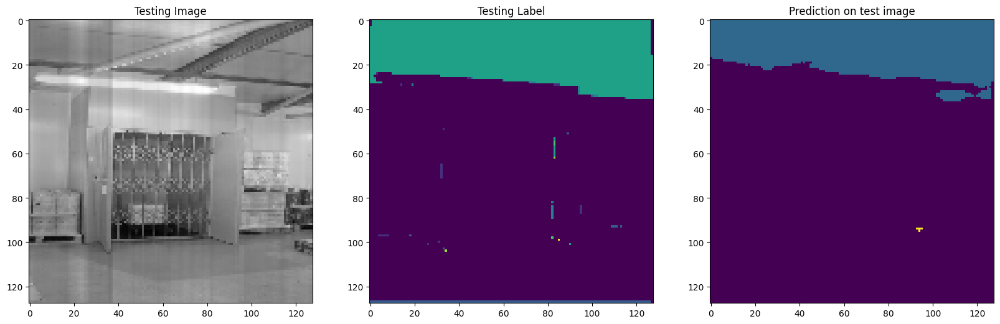

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  5  7  9 10 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  9 10]


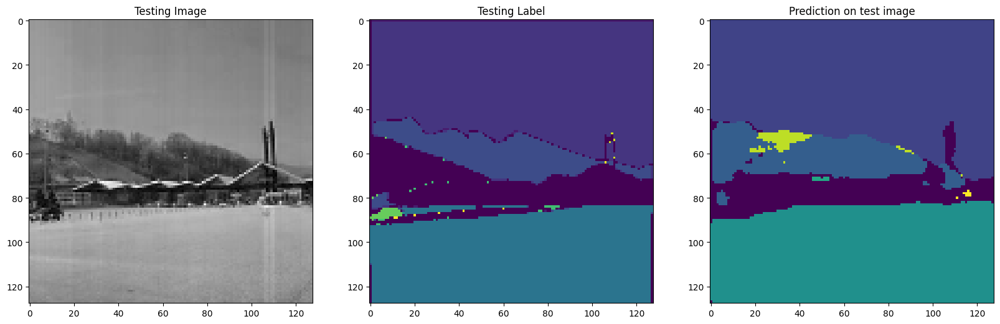

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [0 1 2 3 4 5 6 7]
Unique Classes in predicted taesting image  [0 1 2 3 7]


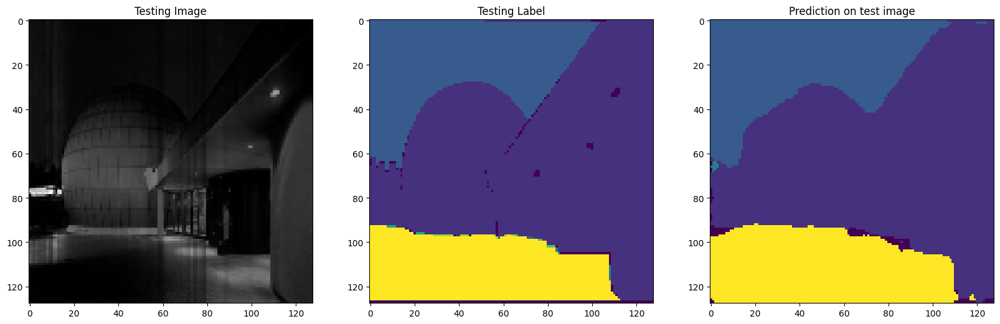

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 13]
Unique Classes in predicted taesting image  [ 0  1  3  5  7 10]


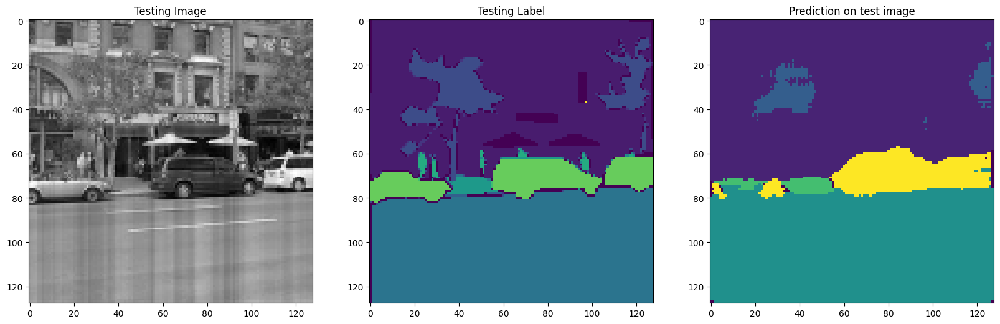

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 13]
Unique Classes in predicted taesting image  [0 1 2 4]


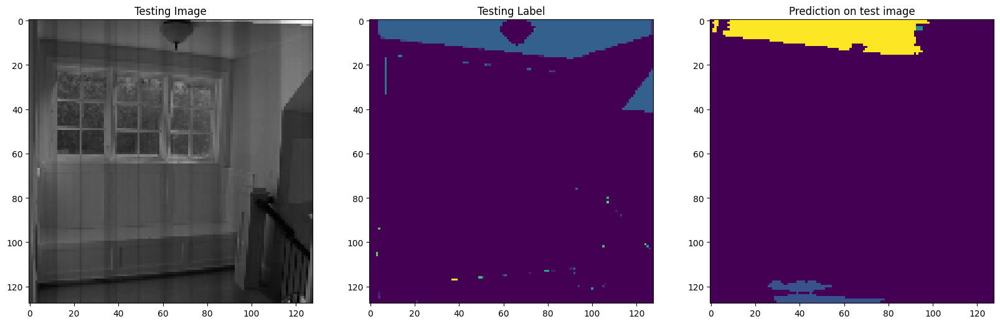

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3 12]


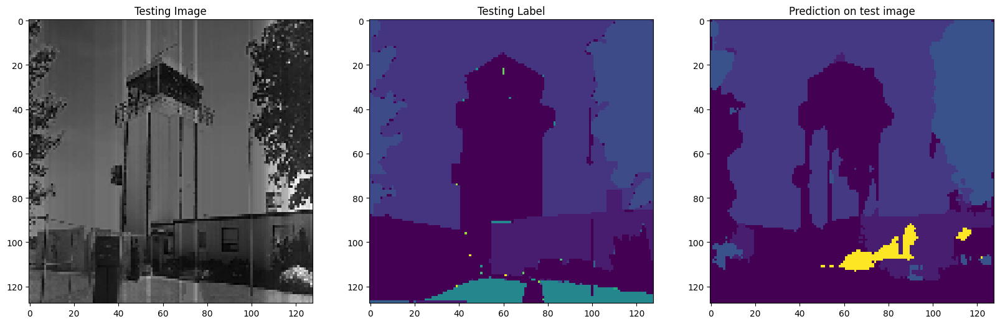

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12 13]
Unique Classes in predicted taesting image  [0 4]


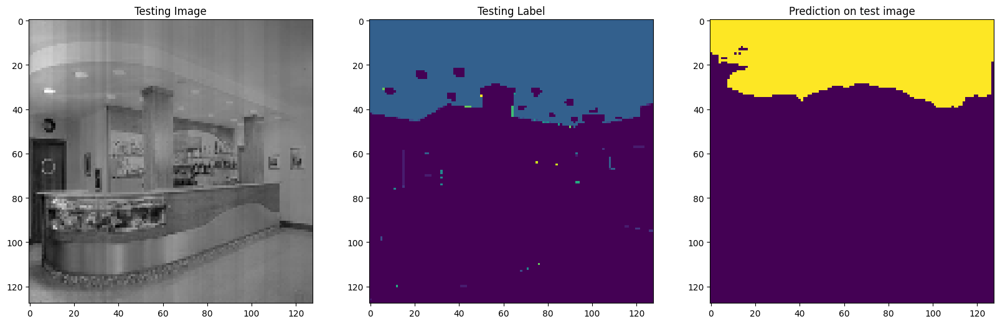

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  8 13]
Unique Classes in predicted taesting image  [ 0  2  3  6 11]


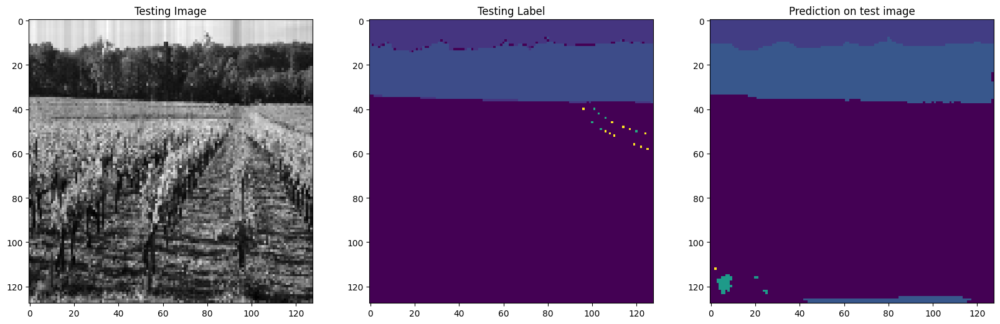

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 12 13]
Unique Classes in predicted taesting image  [0 1 2 3 5 7]


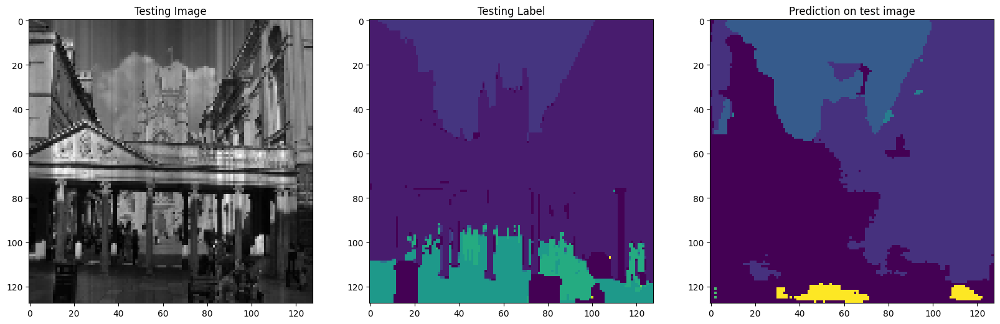

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  8 10 13]
Unique Classes in predicted taesting image  [ 0  1  2  4 12]


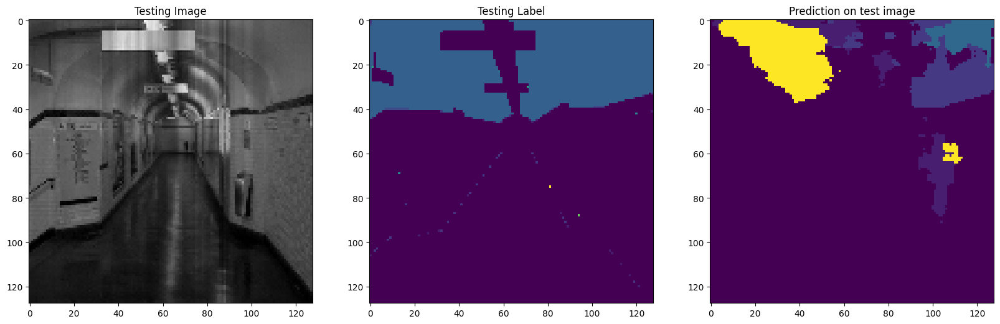

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  6  9 11 12]


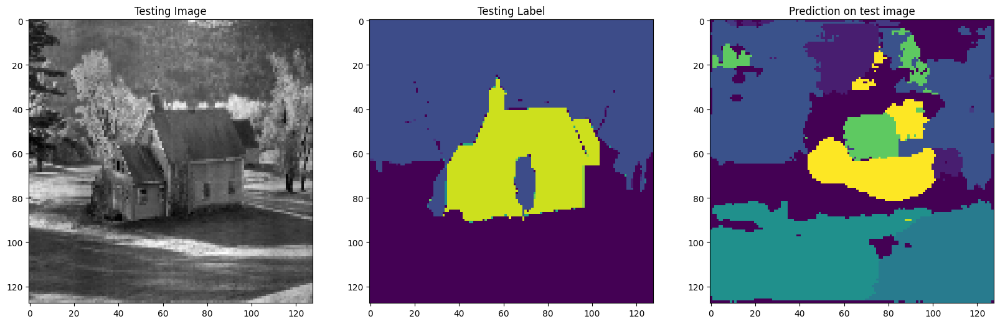

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  4  5 11 12]


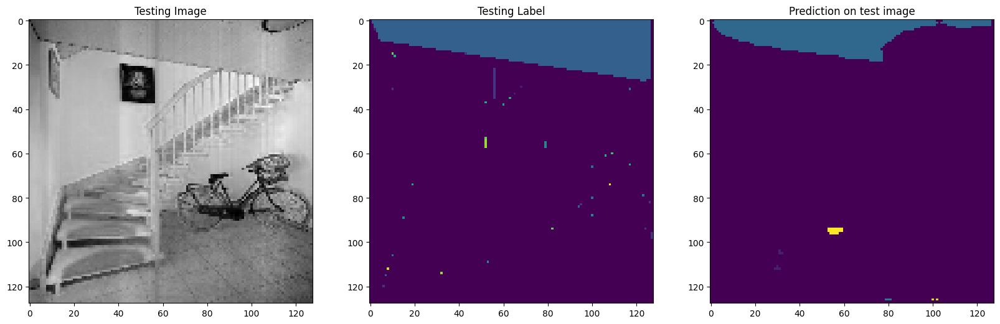

1/1 [==============================] - 0s 24ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 13]
Unique Classes in predicted taesting image  [0 1 2 3 6]


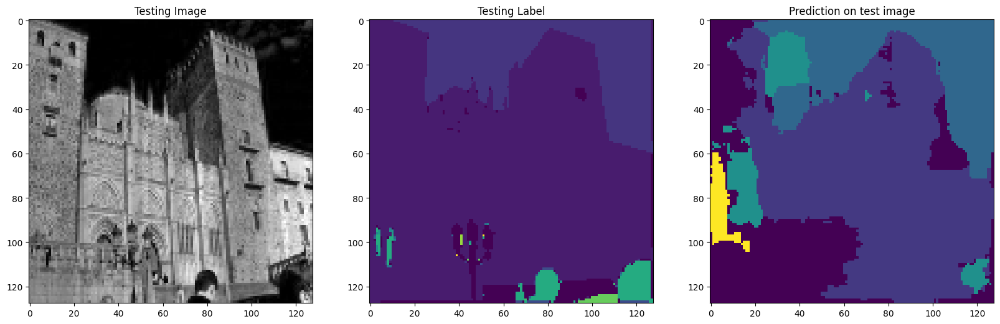

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [0 1 2 3]
Unique Classes in predicted taesting image  [0 1 2 3 4 8 9]


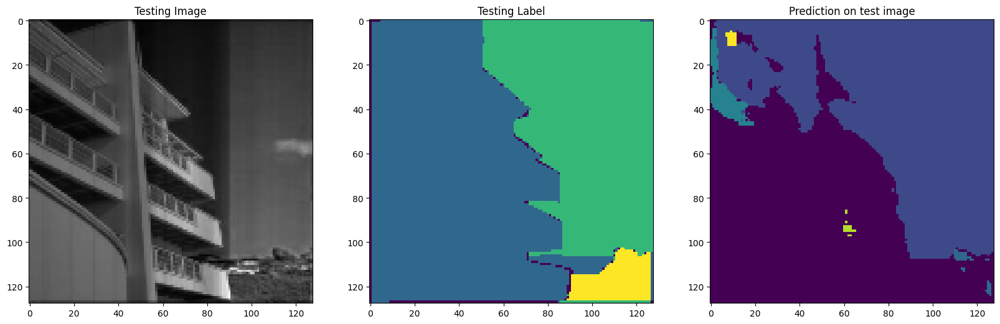

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 2 4]


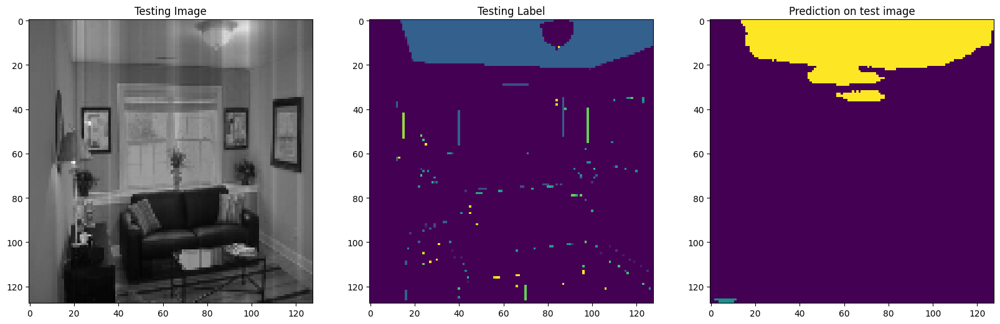

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 1 3 7 8]


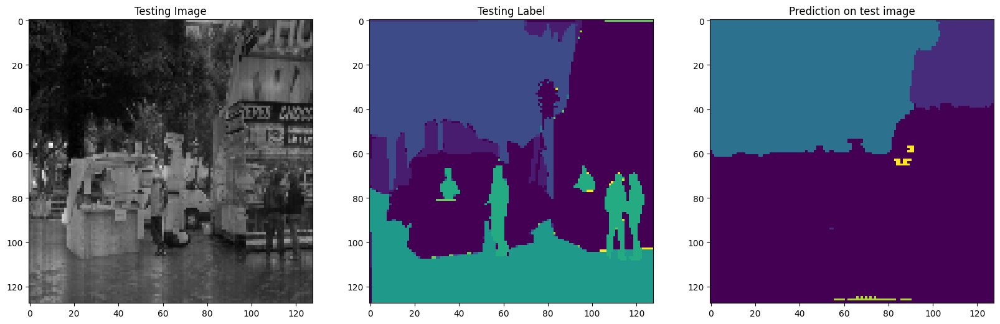

1/1 [==============================] - 0s 22ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  5  9 10 12]


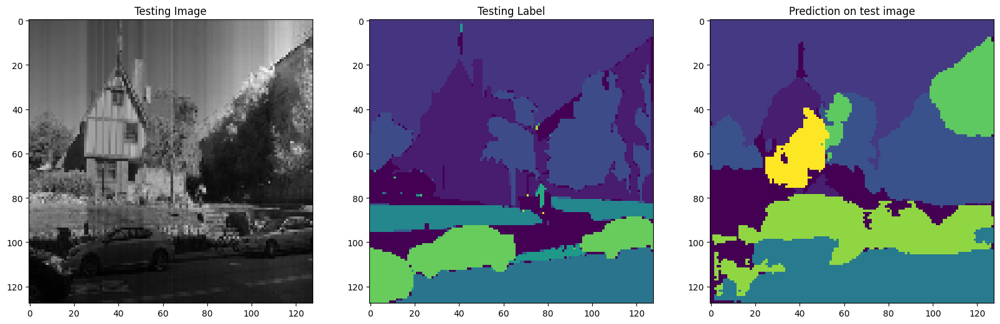

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8 10 11 13]
Unique Classes in predicted taesting image  [0 1 2 4 8]


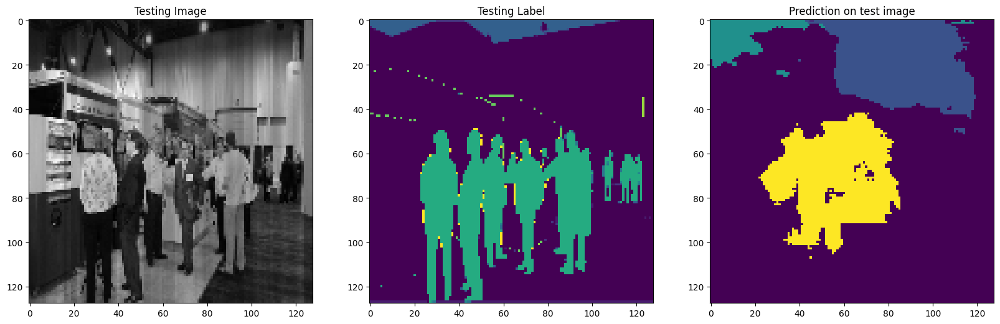

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  2  3  9 12]


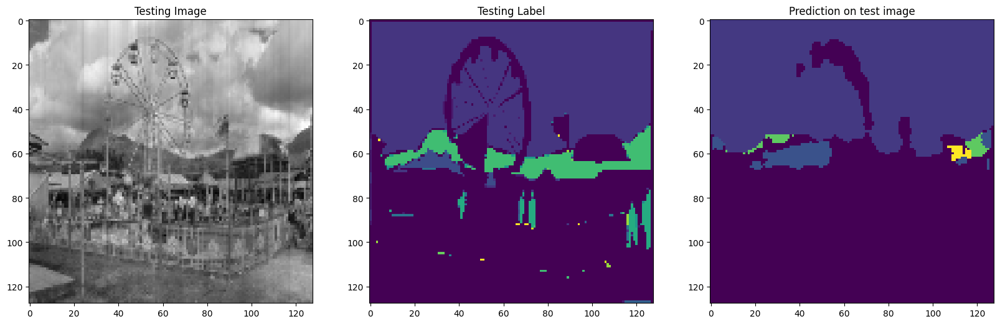

1/1 [==============================] - 0s 20ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [ 0  1  2  3  4  5  9 10 11 12]


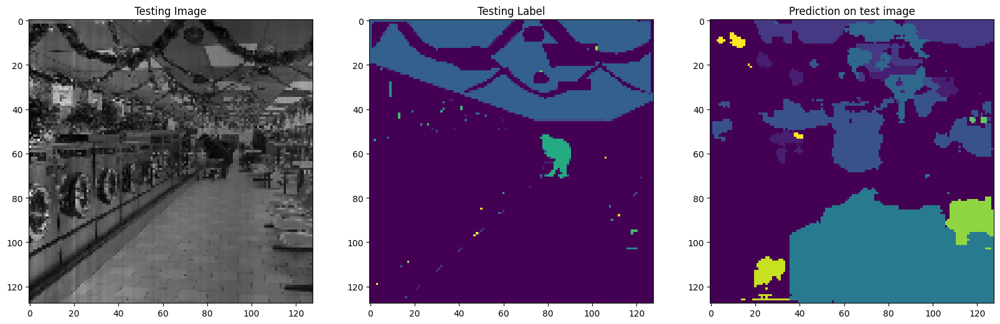

1/1 [==============================] - 0s 32ms/step
Unique Classes in Testing Image  [ 0  2  3  4  5  6  7  8  9 13]
Unique Classes in predicted taesting image  [0 3 6]


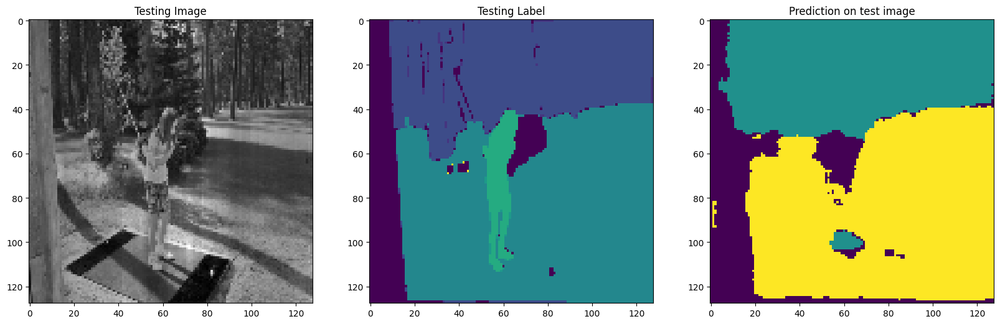

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13]
Unique Classes in predicted taesting image  [0 4]


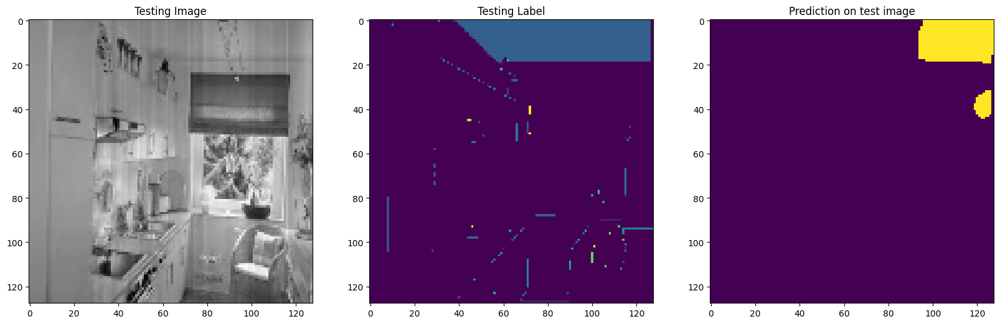

1/1 [==============================] - 0s 21ms/step
Unique Classes in Testing Image  [ 0  1  2  3  4  5  6  7  8  9 10]
Unique Classes in predicted taesting image  [ 0  1  2  3  4 12]


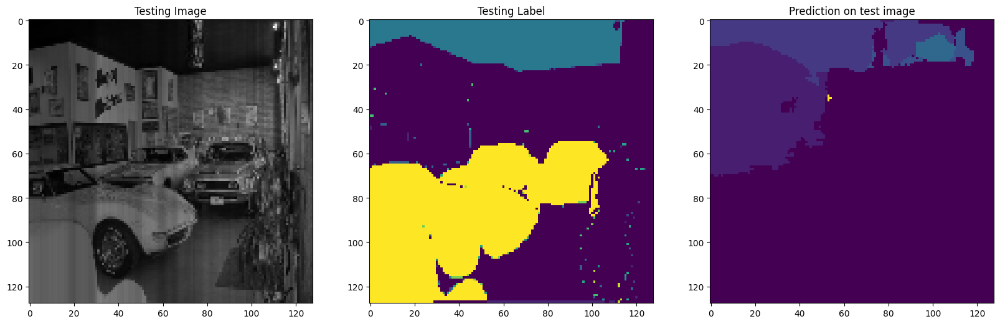

In [145]:
#Generating masks for all the test data set
for test_img_number in range(X_test.shape[0]):
  test_img = X_test[test_img_number]
  ground_truth=y_test[test_img_number]
  test_img_norm=test_img[:,:,0][:,:,None]
  test_img_input=np.expand_dims(test_img_norm, 0)
  prediction = (model.predict(test_img_input))
  predicted_img=np.argmax(prediction, axis=3)[0,:,:]

  print("Unique Classes in Testing Image ",np.unique(ground_truth[:,:,0]))
  print("Unique Classes in predicted taesting image ",np.unique(predicted_img))
    
  plt.figure(figsize=(20, 20))
  plt.subplot(231)
  plt.title('Testing Image')
  plt.imshow(test_img[:,:,0], cmap='gray')
  plt.subplot(232)
  plt.title('Testing Label')
  plt.imshow(ground_truth[:,:,0])
  
  plt.subplot(233)
  plt.title('Prediction on test image')
  plt.imshow(predicted_img, )
    
 
  plt.show()




In [147]:
#Predict on a few images
#model = get_model()
#model.load_weights('???.hdf5')
import random
test_img_number = random.randint(0, len(X_test))
test_img = X_test[test_img_number]
ground_truth=y_test[test_img_number]
test_img_norm=test_img[:,:,0][:,:,None]
test_img_input=np.expand_dims(test_img_norm, 0)
prediction = (model.predict(test_img_input))
predicted_img=np.argmax(prediction, axis=3)[0,:,:]


1/1 [==============================] - 0s 20ms/step


[0 1 2 3 5 6 7 8]
[ 0  1  2  3  4  5  7  8  9 10 11]


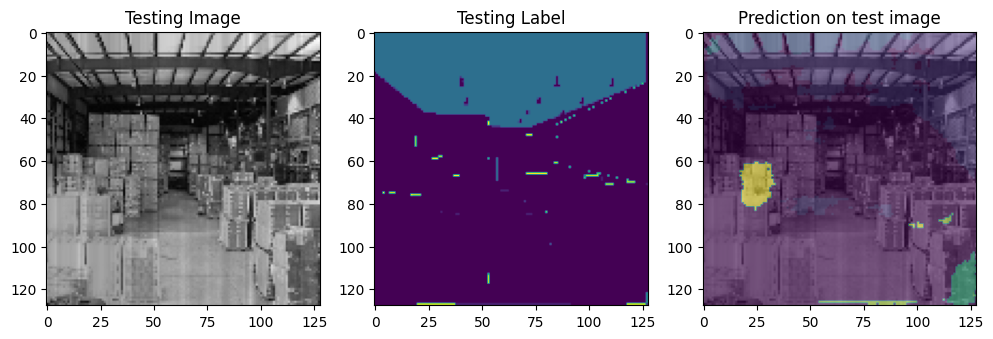

In [148]:
print(np.unique(predicted_img))
print(np.unique(ground_truth[:,:,0]))
plt.figure(figsize=(12, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_img[:,:,0], cmap='gray')
plt.subplot(232)
plt.title('Testing Label')
plt.imshow(ground_truth[:,:,0], )
plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(test_img[:,:,0], cmap='gray')
plt.imshow(predicted_img,alpha=0.5)
plt.show()


In [149]:
#Predict on a few images
#model = get_model()
#model.load_weights('???.hdf5')
import random
test_img_number = random.randint(0, len(X_test))
test_img = X_test[test_img_number]
ground_truth=y_test[test_img_number]
test_img_norm=test_img[:,:,0][:,:,None]
test_img_input=np.expand_dims(test_img_norm, 0)
prediction = (model.predict(test_img_input))
predicted_img=np.argmax(prediction, axis=3)[0,:,:]


1/1 [==============================] - 0s 20ms/step


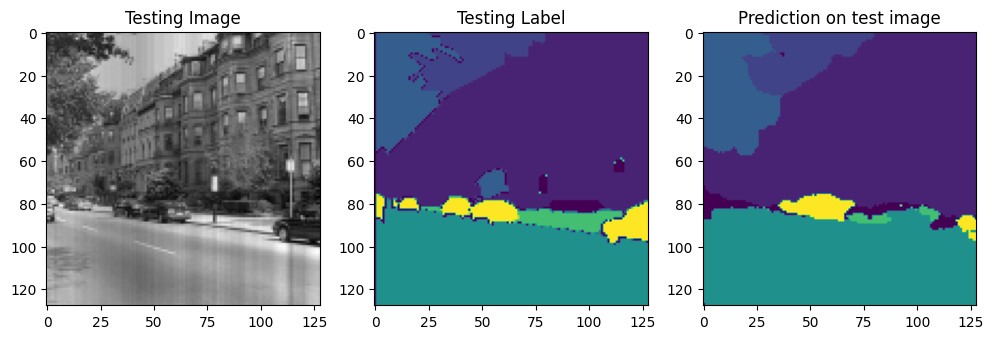

In [150]:
plt.figure(figsize=(12, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_img[:,:,0], cmap='gray')
plt.subplot(232)
plt.title('Testing Label')
plt.imshow(ground_truth[:,:,0])
plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(predicted_img)
plt.show()


In [162]:
#Predict on a few images
#model = get_model()
#model.load_weights('/kaggle/input/unet/tensorflow2/unet1/1/UNET_test_acc0.94_val0.73.hdf5')
import random
test_img_number = random.randint(0, len(X_test))
test_img = X_test[test_img_number]
ground_truth=y_test[test_img_number]
test_img_norm=test_img[:,:,0][:,:,None]
test_img_input=np.expand_dims(test_img_norm, 0)
prediction = (model.predict(test_img_input))
predicted_img=np.argmax(prediction, axis=3)[0,:,:]



1/1 [==============================] - 0s 23ms/step


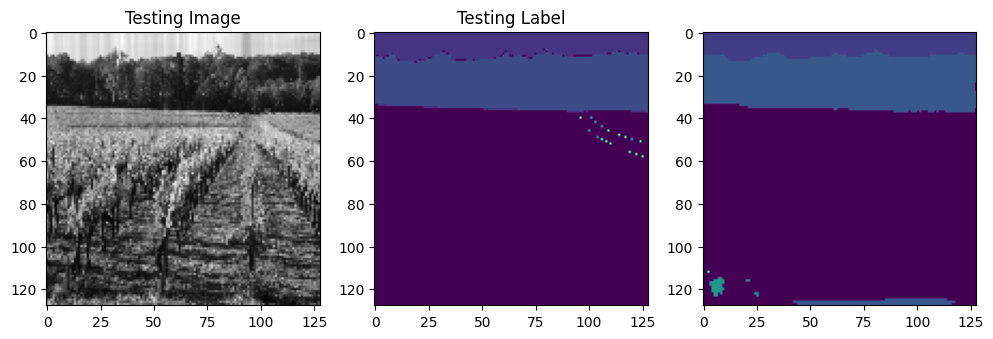

In [163]:
plt.figure(figsize=(12, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_img[:,:,0], cmap='gray')
plt.subplot(232)
plt.title('Testing Label')

plt.imshow(ground_truth[:,:,0])
plt.subplot(233)

plt.imshow(predicted_img)
plt.show()


In [81]:
before = [ 0 , 2,  3 , 5 , 6 , 7 ,10, 12 ,13, 17, 21, 22, 26 ,27]
after = [ 0 , 1 , 2 , 3,  4 , 5 , 6,  7 , 8,  9, 10, 11, 12, 13]

In [76]:
class_encoding = {}
for i in range(len(after)):
    class_encoding[after[i]] = before[i]

In [77]:
class_encoding={0: 0,
 1: 2,
 2: 3,
 3: 5,
 4: 6,
 5: 7,
 6: 10,
 7: 12,
 8: 13,
 9: 17,
 10: 21,
 11: 22,
 12: 26,
 13: 27}

{0: 0,
 1: 2,
 2: 3,
 3: 5,
 4: 6,
 5: 7,
 6: 10,
 7: 12,
 8: 13,
 9: 17,
 10: 21,
 11: 22,
 12: 26,
 13: 27}

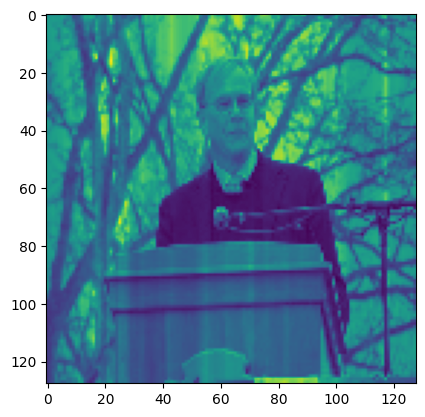

In [82]:
plt.imshow(test_img)

In [83]:
class_label_en = {
0: 'sky',
 1: 'tree',
 2: 'ceiling',
 3: 'building',
 4: 'person',
 5: 'road;route',
 6: 'car',
 7: 'sidewalk',
 8: 'grass',
 9: 'mountain',
 10: 'water',
 11: 'house',
 12: 'sea'}

class_colors_en = {
    0: (6, 230, 230),          
   1: (4, 200, 3),    
    2: (20, 120, 80),    
   3: (80, 120, 120),      
    4: (150, 5, 61),              
    5: (140, 140, 140),     
    6: (0, 102, 200), 
    7: (235, 255, 7),             
    8: (4, 250, 7),            
    9: (143, 255, 140),  
    10: (61, 230, 250),
    11:(255, 9, 224),
    12:(9, 7, 230) 
   
}      

In [164]:
rgb_image = np.repeat(predicted_img[:, :, np.newaxis], 3, axis=2)
labels = list(class_colors_en.values())
for class_label, color in class_colors_en.items():
    rgb_image[predicted_img == class_label] = color
    

In [101]:
rgb_image.shape

(128, 128, 3)

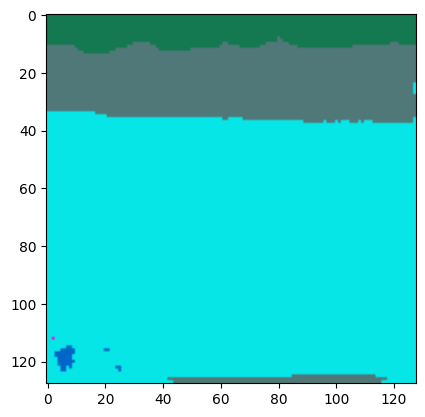

In [165]:
plt.imshow(rgb_image)

In [166]:
np.unique(rgb_image)

array([  0,   6,   9,  20,  80, 102, 120, 200, 224, 230, 255])

In [ ]:
pip freeze > requirements.txt

In [167]:
image_name = u'/kaggle/input/ade20k-scene-parsing/ADEChallengeData2016/images/training/ADE_train_00006512.jpg'
image = load_images_bw(image_name)
train_images = np.array(image[:,:,0])
train_images = np.expand_dims(train_images, axis=2)
train_images = normalize(train_images,axis=1)#

In [168]:
test_img_norm=train_images
test_img_input=np.expand_dims(test_img_norm, 0)
prediction = (model.predict(test_img_input))
predicted_img=np.argmax(prediction, axis=3)[0,:,:]

1/1 [==============================] - 0s 24ms/step


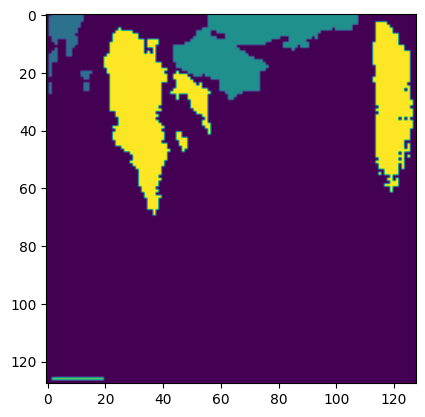

In [169]:
plt.imshow(predicted_img)

In [170]:
np.unique(predicted_img)

array([0, 3, 4, 6, 8])

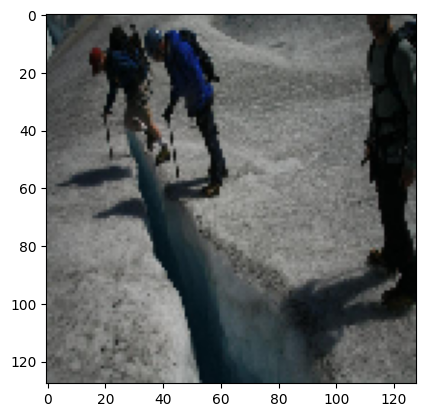

In [171]:
plt.imshow(image)

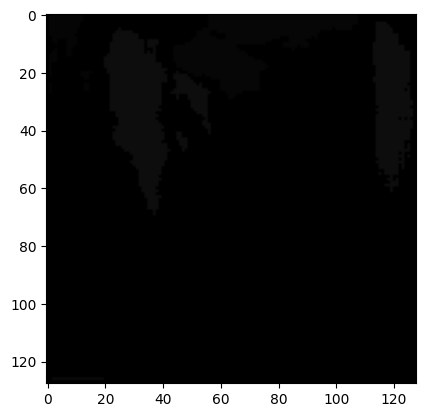

In [174]:
rgb_image = np.repeat(predicted_img[:, :, np.newaxis], 3, axis=2)

for encoded, before_encode in class_encoding.items():
    rgb_image[predicted_img == encoded] = before_encode
plt.imshow(rgb_image,cmap='jet')

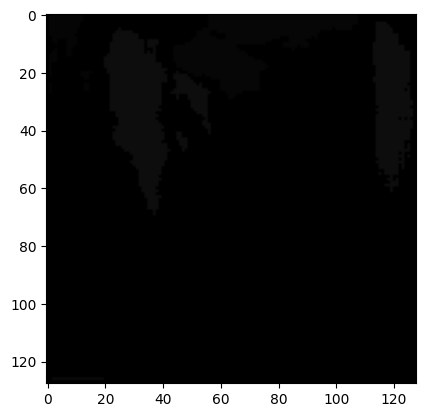

In [175]:
plt.imshow(rgb_image)

In [176]:
rgb_image.shape

(128, 128, 3)

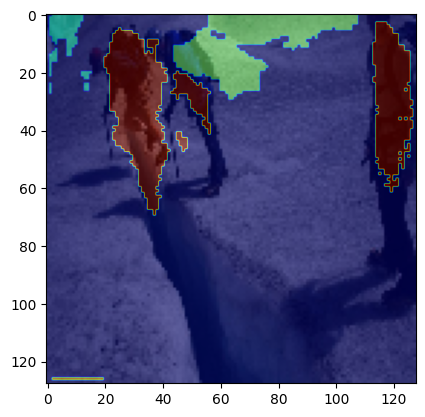

In [179]:
# Apply colors to the mask based on class labels
output = np.repeat(predicted_img[:, :, np.newaxis], 3, axis=2)
labels = list(class_colors.values())
for class_label, color in class_colors.items():
    output[predicted_img == class_label] = color  
plt.imshow(image,cmap='gray') 
plt.imshow(predicted_img, alpha=0.5,cmap='jet') # interpolation='none'


# Save the image shown in subplot (222)
plt.savefig('prediction_with_mask.png')  # Save the figure as an image file

-++
